# Great Plains Low-Level Jet

Author: Ilan Valencius

## Basic imports

In [1]:
import os

# Data wrangling
from glob import glob
import polars as pl
import pandas as pd
import numpy as np
import xarray as xr
import metpy.calc as mpcalc
from metpy.units import units
import metpy.constants as mpconst

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import itertools
import string
import nc_time_axis
import matplotlib.ticker as ticker
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.animation import FuncAnimation
import matplotlib
from cycler import cycler

# Dealing with memory
import gc

# Cosmetics
from rich import print
sns.set_palette('dark')

## Start Dask cluster

In [2]:
from dask.distributed import Client, LocalCluster, progress
# Create a local Dask cluster using all available cores
cluster = LocalCluster(n_workers=8, threads_per_worker=1)
client = Client(cluster)
# # Print cluster information
# client = Client()
print(client)

<Client: 'tcp://127.0.0.1:45783' processes=8 threads=8, memory=128.00 GiB>

## Useful Functions

In [3]:
def add_latlon(ax):
    proj=ccrs.PlateCarree()
    gl = ax.gridlines(
        crs=proj, draw_labels=True, which='both',
        linewidth=1, color='k', alpha=1, linestyle='--'
    )
    gl.right_labels = None
    gl.top_labels = None
    gl.xlines = None
    gl.ylines = None
    # Increase the ticksize
    gl.xlabel_style = {'size': 10, 'color': 'k', 'rotation':30, 'ha':'right'}
    gl.ylabel_style = {'size': 10, 'color': 'k', 'weight': 'normal'}

def big_ax(ax, lw=2):
    for spine in ax.spines.values():
        spine.set_linewidth(lw)

def plot_rockies(ax, da, ds, pbl=True, plot_kwargs=None):
    """
    Plot data in a cross section like Jiang et al. (2007)
    """
    # Get height of mountains and boundary layer
    cesm2_orog = slice_rockies(ds.orog_plev).mean('time')
    da.plot.contourf(ax=ax, **plot_kwargs)
    ax.fill_between(cesm2_orog.lon, 1000*100, cesm2_orog, color='k')
    if pbl:
        pbl = mpcalc.height_to_pressure_std(
            slice_rockies(ds.PBLH.metpy.quantify() + ds.orog.metpy.quantify()).mean('time')
        ).metpy.convert_units('Pa')
        ax.plot(cesm2_orog.lon, pbl, linestyle='dashed', color='k')
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')
    return ax

def get_Km_gentile(ds):    
    """
    Calculate Km according to Gentile et al. (2025)
    """
    # Confirmed this by looking at cesm2 source code
    uw = ds.UPWP_CLUBB.metpy.quantify()
    vw = ds.VPWP_CLUBB.metpy.quantify()
    
    # Need these to be in height coordinates so use hydrostatic balance
    factor = - ds.RHO_CLUBB.metpy.quantify() * mpconst.earth_gravity
    dudz = mpcalc.first_derivative(ds.U.metpy.quantify(), axis='plev')  * factor
    dvdz = mpcalc.first_derivative(ds.V.metpy.quantify(), axis='plev')  * factor
        
    Km = np.sqrt(
        (uw**2 + vw**2)/
        (dudz**2 + dvdz**2)
    ).metpy.convert_to_base_units().rename('Km')
    return Km

def get_budget(ds):
    """
    Get all momentum terms (including Km).
    """
    ds = ds.metpy.parse_cf()
    y_theta = np.deg2rad(ds.lat)
    f = mpcalc.coriolis_parameter(ds.lat)
    U = ds.U.metpy.quantify()
    V = ds.V.metpy.quantify()
    OMEGA = ds.OMEGA.metpy.quantify()
    
    # Term I (advective forms)
    a = U * mpcalc.first_derivative(V, axis='lon')
    b = V * mpcalc.first_derivative(V, axis='lat')
    c = OMEGA * mpcalc.first_derivative(V, axis='plev')
    d = U * U * np.tan(y_theta) / mpconst.earth_avg_radius
    I = -(a + b + c + d)
    
    # Other terms
    II = -f * U
    III = -mpcalc.first_derivative(ds.Z3.metpy.quantify() * mpconst.earth_gravity, axis='lat')
    # Equivalent to -(ds.VTEND_CLUBB.metpy.quantify() + ds.VTGWORO.metpy.quantify() + ds.DVV.metpy.quantify() + ds.ZMMTV.metpy.quantify())
    IV = ds.FV.metpy.quantify()
    
    # Check negative signs above
    residual = I + II + III + IV

    # Now get Km
    Km = get_Km_gentile(ds)
    
    # Create dataset
    combined = xr.merge([
        I.rename('I')*10e5*units('s'),
        II.rename('II')*10e5*units('s'),
        III.rename('III')*10e5*units('s'),
        IV.rename('IV')*10e5*units('s'),
        residual.rename('residual')*10e5*units('s'),
        Km,
    ])
    return combined

def get_zonal_budget(ds):
    """
    Get all zonal momentum terms (including Km).
    """
    ds = ds.metpy.parse_cf()
    y_theta = np.deg2rad(ds.lat)
    f = mpcalc.coriolis_parameter(ds.lat)
    U = ds.U.metpy.quantify()
    V = ds.V.metpy.quantify()
    OMEGA = ds.OMEGA.metpy.quantify()
    
    # Term I (advective forms)
    a = U * mpcalc.first_derivative(U, axis='lon')
    b = V * mpcalc.first_derivative(U, axis='lat')
    c = OMEGA * mpcalc.first_derivative(U, axis='plev')
    d = -1*U * V * np.tan(y_theta) / mpconst.earth_avg_radius
    I = -(a + b + c + d)
    
    # Other terms
    II = f * V
    III = -mpcalc.first_derivative(ds.Z3.metpy.quantify() * mpconst.earth_gravity, axis='lon')
    # Equivalent to -(ds.VTEND_CLUBB.metpy.quantify() + ds.VTGWORO.metpy.quantify() + ds.DVV.metpy.quantify() + ds.ZMMTV.metpy.quantify())
    IV = ds.FU.metpy.quantify()
    
    # Check negative signs above
    residual = I + II + III + IV

    # Now get Km
    Km = get_Km_gentile(ds)
    
    # Create dataset
    combined = xr.merge([
        I.rename('I')*10e5*units('s'),
        II.rename('II')*10e5*units('s'),
        III.rename('III')*10e5*units('s'),
        IV.rename('IV')*10e5*units('s'),
        residual.rename('residual')*10e5*units('s'),
        Km,
    ])
    return combined


def rms(da):
    return np.sqrt((da ** 2).mean())

def mean_95(da, dim):
    """
    Returns the mean value and 95% C.I. across the given dimension.
    From Claude
    """
    # Calculate mean
    mean = da.mean(dim=dim)
    
    # Calculate standard error
    std = da.std(dim=dim)
    n = da.sizes[dim]
    se = std / np.sqrt(n)
    
    # Calculate 95% confidence interval (mean ± 1.96 * SE)
    ci_lower = mean - 1.96 * se
    ci_upper = mean + 1.96 * se
    return mean, ci_lower, ci_upper

def sel_region(ds, region):
    """
    Select points within a specific region.
    """
    if region == 'conus':
        return ds.sel(lat=slice(20, 50), lon=slice(-130+360, -70+360))
    elif region == 'LLJ':
        print('!!! Using a different bounding box to test !!!')
        return ds.sel(lat=slice(30, 40), lon=slice(-105+360, -95+360))
        # return ds.sel(lat=slice(30, 40), lon=slice(-100+360, -95+360))
    elif region == 'rockies':
        return ds.sel(lat=slice(30, 40), lon=slice(-130+360, -70+360))
    else:
        print('Region not found')

def spatial_mean(ds):
    weights = np.cos(np.deg2rad(ds.lat))
    return ds.weighted(weights).mean('lat').mean('lon')

def meridional_mean(ds):
    weights = np.cos(np.deg2rad(ds.lat))
    return ds.weighted(weights).mean('lat')    

## Load CESM2 data

In [ ]:
from postprocessCESM2 import load_CESM2, season_diurnal_cycle

In [5]:
ds = load_CESM2()
ds

/tmp/ipykernel_1328321/239340819.py:96: RuntimeWarning: Converting a CFTimeIndex with dates from a non-standard calendar, 'noleap', to a pandas.DatetimeIndex, which uses dates from the standard calendar.  This may lead to subtle errors in operations that depend on the length of time between dates.
  time_utc = ds.indexes['time'].to_datetimeindex(time_unit='ns').tz_localize('UTC')


<xarray.Dataset> Size: 3TB
Dimensions:           (lat: 74, lon: 136, time: 21072, forcing: 4, plev: 24)
Coordinates:
  * lat               (lat) float64 592B 0.4712 1.414 2.356 ... 68.32 69.27
  * lon               (lon) float64 1kB 190.0 191.2 192.5 ... 356.2 357.5 358.8
  * time              (time) datetime64[ns] 169kB 1978-12-31T18:00:00 ... 198...
  * forcing           (forcing) object 32B '4K' '4xCO2' 'COMBINED' 'REF'
  * plev              (plev) int64 192B 10000 15000 20000 ... 95000 97500 100000
Data variables: (12/66)
    DUH               (forcing, time, plev, lat, lon) float32 81GB dask.array<chunksize=(1, 336, 24, 74, 136), meta=np.ndarray>
    DUV               (forcing, time, plev, lat, lon) float32 81GB dask.array<chunksize=(1, 336, 24, 74, 136), meta=np.ndarray>
    DVV               (forcing, time, plev, lat, lon) float32 81GB dask.array<chunksize=(1, 336, 24, 74, 136), meta=np.ndarray>
    FU                (forcing, time, plev, lat, lon) float32 81GB dask.array<chunksize=(1, 336, 24, 74, 136), meta=np.ndarray>
    FV                (forcing, time, plev, lat, lon) float32 81GB dask.array<chunksize=(1, 336, 24, 74, 136), meta=np.ndarray>
    OMEGA             (forcing, time, plev, lat, lon) float32 81GB dask.array<chunksize=(1, 336, 24, 74, 136), meta=np.ndarray>
    ...                ...
    nscur             (forcing, time) float64 674kB dask.array<chunksize=(1, 336), meta=np.ndarray>
    nsteph            (forcing, time) float64 674kB dask.array<chunksize=(1, 336), meta=np.ndarray>
    sol_tsi           (forcing, time) float64 674kB dask.array<chunksize=(1, 336), meta=np.ndarray>
    time_written      (forcing, time) object 674kB dask.array<chunksize=(1, 336), meta=np.ndarray>
    orog              (lat, lon) float64 81kB dask.array<chunksize=(74, 136), meta=np.ndarray>
    orog_plev         (lat, lon) float64 81kB dask.array<chunksize=(74, 136), meta=np.ndarray>

#### Load processed CESM2 data

Run `postprocessCESM2.py` first.

In [ ]:
ds_grouped = xr.load_dataset('../data/cesm2_base_vars.nc')
ds_grouped

#### Misc.

In [ ]:
### CODE FOR FIXING BAD TIMES
from glob import glob
files = glob('/projects/bccg/Data/cesm2/GPLLJ/REF/*.nc')
for i in range(len(files)-3):
    foo = xr.open_mfdataset(files[i:i+3])
foo = xr.open_mfdataset(files[300:])
import cftime
times = np.array([
    cftime.DatetimeNoLeap(1980, 10, 27, hour, 0, 0, 0, has_year_zero=True)
    for hour in range(24)
], dtype=object)
foo['time'] = times
foo.to_netcdf('_.nc')

# Plots of Reference Characteristics

## Figure - climatology of the GPLLJ (top-view)

Replicate figure 1 in Jiang et al. (2007).

### Prep data

In [58]:
orog_mask = sel_region(xr.where(ds.orog_plev <= 925*100, 1, np.nan), 'conus')
ds_sel = (
    sel_region(ds[['U', 'V']], 'conus')
    .sel(plev=925*100, forcing='REF')
    .groupby('time.season').mean()
)
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 21.37 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

### Plot

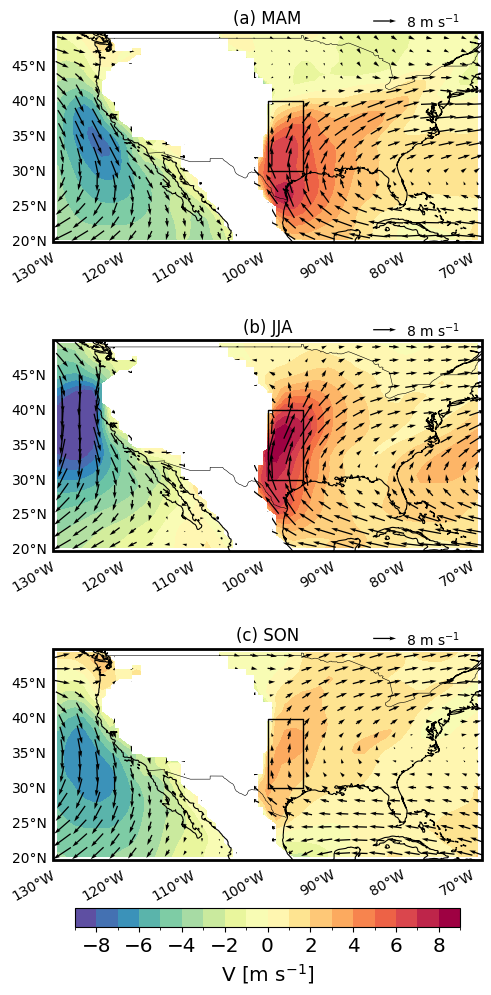

In [63]:
fig, axes = plt.subplots(
    ncols=1, nrows=3, figsize=(6.4*0.75, 4.8*0.7*3),
    subplot_kw={'projection': ccrs.PlateCarree()}, 
    layout='constrained'
)
cmap = sns.color_palette("Spectral_r", as_cmap=True)
contour_opts = dict(
    levels=19,
    vmax=9,
    transform=ccrs.PlateCarree(),
    add_colorbar=False,
    cmap=cmap,
)
quiver_opts = dict(
    u='U',
    v='V',
    transform=ccrs.PlateCarree(),
    add_guide=False,
    scale=150
)

for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    
    da = ds_plot.sel(season=season)#.where(conus_mask, drop=True)
    
    ### CESM2 ###
    c = da.V.plot.contourf(
        ax=axes[ax_cnt],
        **contour_opts,
    )
    q = da.coarsen(lon=2, lat=2, boundary='pad').mean().plot.quiver(
        ax=axes[ax_cnt], 
        x='lon', y='lat',
        **quiver_opts
    )
    ref_magnitude = 8
    axes[ax_cnt].quiverkey(
        q, X=0.8, Y=1.05, U=ref_magnitude, 
        label=f'{ref_magnitude}'+' m s$^{-1}$', 
        labelpos='E'
    )

    # CESM2 NaN mask using xarray.plot()
    orog_mask.plot(
        ax=axes[ax_cnt],
        transform=ccrs.PlateCarree(),
        cmap='binary_r',
        add_colorbar=False,
        vmin=0, vmax=1
    )
    
    # Labels
    axes[ax_cnt].set_title(f'({string.ascii_lowercase[ax_cnt]}) {season}')
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    # ax.add_feature(cfeature.STATES, linewidth=0.4)
    # Plot GPLLJ region
    ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
             color='black', linewidth=1,
             transform=ccrs.Geodetic(), #remove this line to get straight lines
             )
    
cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'V [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')
plt.savefig('../figures/top_view_GPLLJ_REF.png', dpi=300)
plt.show()

## Figure - climatology of the GPLLJ (side-view)

### Prep data

Recreate figure 3 from Jiang et al. (2007). Make sure data is at 0300 LT.

In [18]:
orog_plev = slice_rockies(ds.orog_plev.where(conus_mask, drop=True))
pbl_m = ds.PBLH.metpy.quantify().where(conus_mask, drop=True)
orog_m = ds.orog.metpy.quantify().where(conus_mask, drop=True)
pbl_plev = (
    slice_rockies(
        mpcalc.height_to_pressure_std(
            pbl_m + orog_m
        )
        .metpy.convert_units('Pa')
        .sel(forcing='REF')
        .metpy.dequantify()
    )
    .where(ds['time.hour'] == 3, drop=True)
    .groupby('time.season').mean()
)
ds_sel = slice_rockies(
    ds.V
    .sel(forcing='REF')
    .where(conus_mask, drop=True)
    .where(ds['time.hour'] == 3, drop=True) # 0300 LT
    .groupby('time.season').mean()
)
future = client.compute(ds_sel)
progress(future)

VBox()

In [19]:
ds_plot = future.result()

### Plot

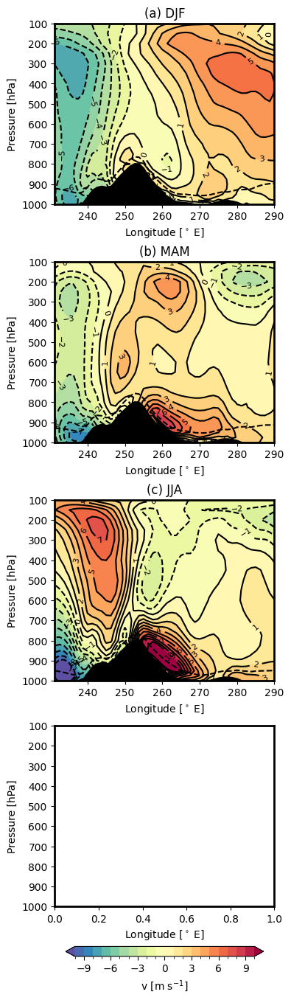

In [21]:
fig, axes = plt.subplots(
    ncols=1, nrows=4, figsize=(6.4*0.6, 4.8*0.7*4),
    layout='constrained'
)
cbar_kwargs = {'label': r'v [m s$^{-1}$]', 'shrink': 0.9, 'orientation': 'horizontal', 'pad': 0.005}
cmap = sns.color_palette("Spectral_r", as_cmap=True)
for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA', 'SON']):
    ### REMOVE LATER
    if season == 'SON':
        continue
    ### REMOVE LATER
    
    da = ds_plot.sel(season=season)
    pbl = pbl_plev.sel(season=season)
    
    ### CESM2 ###
    c = da.plot.contourf(
        ax=axes[ax_cnt],
        levels=21,
        vmax=10,
        add_colorbar=False,
        cmap=cmap,
    )
    contours = da.plot.contour(
        ax=axes[ax_cnt],
        levels=21,
        vmax=10,
        colors='black',
    )
    axes[ax_cnt].clabel(contours, inline=True, fontsize=8)
    axes[ax_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
    axes[ax_cnt].plot(pbl.lon, pbl, linestyle='dashed', color='k')
    
    # Labels
    axes[ax_cnt].set_title(f'({string.ascii_lowercase[ax_cnt]}) {season}')
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
plt.show()

### Save figure

In [ ]:
# plt.savefig('../figures/fig2.png', dpi=300)

## Figure - diurnal cycle of winds

### Prep data

In [143]:
ds_sel = ds[['V', ]]\
    .where(llj_mask, drop=True)\
    .sel(forcing='REF')
future = client.compute(ds_sel)
progress(future)

VBox()

In [144]:
ds_llj = future.result()

In [153]:
hourly_groups = []
for season, months in zip(['DJF', 'MAM', 'JJA', 'SON'], [[12, 1, 2], [3, 4, 5], [6,7,8], [9, 10, 11]]):
    ### REMOVE LATER
    if season == 'SON':
        continue
    ### REMOVE LATER
    month_sel = ds_llj.sel(time=ds_llj.time.dt.month.isin(months))
    by_hour = month_sel.groupby('time.hour').mean()
    hourly_groups.append(llj_region_mean(by_hour))

### Plot

#### Mean cycle

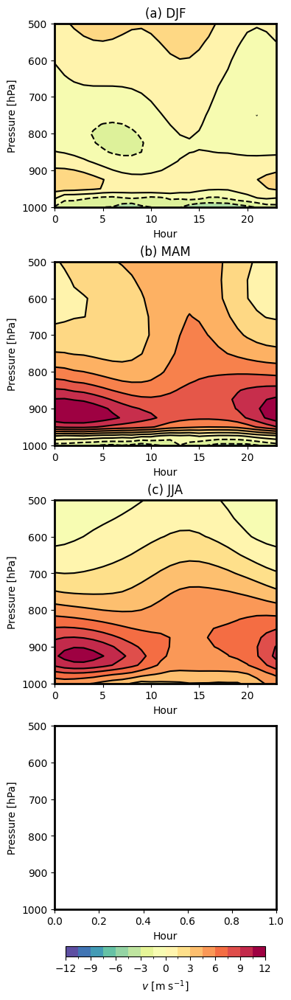

In [155]:
fig, axes = plt.subplots(
    ncols=1, nrows=4, figsize=(6.4*0.6, 4.8*0.7*4),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, (season, hourly) in enumerate(zip(['DJF', 'MAM', 'JJA', 'SON'], hourly_groups)):
    ### REMOVE LATER
    if season == 'SON':
        continue
    ### REMOVE LATER
    c0 = hourly.V.plot.contourf(
        ax=axes[ax_cnt],
        x='hour',
        vmax=12,
        levels=17,
        add_colorbar=False,
        cmap=sns.color_palette("Spectral_r", as_cmap=True),
    )
    hourly.V.plot.contour(
        ax=axes[ax_cnt],
        x='hour',
        vmax=12,
        levels=17,
        add_colorbar=False,
        colors='black',
    )
    axes[ax_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {season}')
    label_cnt+=1
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 500*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500])# 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'Pressure [hPa]')

# fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
fig.colorbar(
    c0, ax=axes[:],
    label=r'$v$ [m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
plt.show()

#### Daily Pertubation

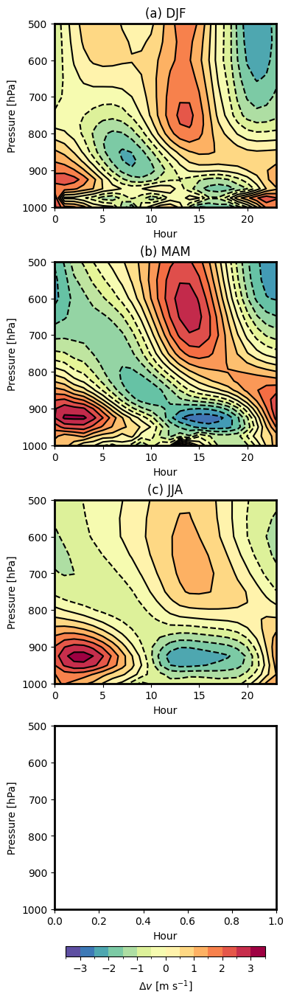

In [156]:
fig, axes = plt.subplots(
    ncols=1, nrows=4, figsize=(6.4*0.6, 4.8*0.7*4),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, (season, hourly) in enumerate(zip(['DJF', 'MAM', 'JJA', 'SON'], hourly_groups)):
    ### REMOVE LATER
    if season == 'SON':
        continue
    ### REMOVE LATER
    perturb = hourly - hourly.mean('hour')
    c0 = perturb.V.plot.contourf(
        ax=axes[ax_cnt],
        x='hour',
        vmax=4,
        levels=17,
        add_colorbar=False,
        cmap=sns.color_palette("Spectral_r", as_cmap=True),
    )
    perturb.V.plot.contour(
        ax=axes[ax_cnt],
        x='hour',
        vmax=4,
        levels=17,
        add_colorbar=False,
        colors='black',
    )
    axes[ax_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {season}')
    label_cnt+=1
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 500*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500])# 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'Pressure [hPa]')

# fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
fig.colorbar(
    c0, ax=axes[:],
    label=r'$\Delta$$v$ [m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
plt.show()

## Figure - momentum residual

### Prep data

$$\frac{\partial {v}}{\partial t} = \underbrace{-({v}\cdot \nabla){v}}_\text{(I)} - \underbrace{f{u}}_\text{(II)} - \underbrace{\frac{1}{\rho}\nabla p}_\text{(III)} + \underbrace{\frac{\partial}{\partial z}\left(K_m\frac{\partial 
{v}}{\partial z}\right)}_\text{(IV)} + \text{ residual}$$

Take data from the summer season.

In [6]:
ds_sel = ds[['U', 'V', 'OMEGA', 'Z3', 'FV', 'orog', 'PBLH', 'UPWP_CLUBB', 'VPWP_CLUBB', 'orog_plev', 'RHO_CLUBB']]\
    .sel(plev=slice(100*100, None))\
    .where(ds['time.month'].isin([6,7,8]), drop=True)\
    .where(rockies_mask, drop=True)\
    .sel(forcing='REF')
future = client.compute(ds_sel)
progress(future)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 39.05 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

/home/valencig/GPLLJ/src/interpolation.py:177: UserWarning: Interpolation point out of data bounds encountered
  return func_interpolate(new_levels, xcoords, data, axis=interp_axis)
/home/valencig/GPLLJ/src/interpolation.py:177: UserWarning: Interpolation point out of data bounds encountered
  return func_interpolate(new_levels, xcoords, data, axis=interp_axis)


In [7]:
ds_rockies = future.result()

In [8]:
# Normal terms
ds_terms = get_budget(ds_rockies)
# Get Km
Km = get_Km_gentile(ds_rockies)
# Get the full tendency term given Km
factor = - ds_rockies.RHO_CLUBB.metpy.quantify() * mpconst.earth_gravity
dvdz = mpcalc.first_derivative(ds_rockies.V.metpy.quantify(), axis='plev') * factor
Km_momentum = (mpcalc.first_derivative(Km*dvdz, axis='plev')*factor*10e5*units('s')).metpy.convert_to_base_units()
print(Km_momentum.metpy.units)
ds_terms['Km_momentum'] = Km_momentum
ds_terms['Residual_using_Km'] = ds_terms['I'] + ds_terms['II'] + ds_terms['III'] + ds_terms['IV'] + ds_terms['Km_momentum']
ds_terms

meter / second

<xarray.Dataset> Size: 2GB
Dimensions:            (lat: 10, lon: 48, time: 2208, plev: 24)
Coordinates:
  * lat                (lat) float64 80B 30.63 31.57 32.51 ... 37.23 38.17 39.11
  * lon                (lon) float64 384B 231.2 232.5 233.8 ... 288.8 290.0
  * time               (time) datetime64[ns] 18kB 1979-06-01 ... 1979-08-31T2...
    forcing            <U3 12B 'REF'
  * plev               (plev) int64 192B 10000 15000 20000 ... 97500 100000
Data variables:
    I                  (time, plev, lat, lon) float64 203MB <Quantity([[[[-1....
    II                 (lat, time, plev, lon) float64 203MB <Quantity([[[[-1....
    III                (time, plev, lat, lon) float64 203MB <Quantity([[[[  3...
    IV                 (time, plev, lat, lon) float64 203MB <Quantity([[[[-1....
    residual           (time, plev, lat, lon) float64 203MB <Quantity([[[[ 1....
    Km                 (time, plev, lat, lon) float64 203MB <Quantity([[[[4.8...
    Km_momentum        (time, plev, lat, lon) float64 203MB <Quantity([[[[-2....
    Residual_using_Km  (time, plev, lat, lon) float64 203MB <Quantity([[[[ 1....

In [9]:
def integrate_plev_with_nan_bounds(da):
    """
    Change the lower bound of integration so all-NaN slices are not returned
    """
    # Get input units 
    da_units = da.metpy.quantify().metpy.units
    # Stack data-array as gridpoints
    all_dims_except_level = [d for d in da.dims if (d != 'plev')]
    adv_gridpoint = da.stack(gridpoint=all_dims_except_level)
    def _integrate_nan_aware(data, plev):
        """
        Vectorized integration with NaN-aware bounds
        data: numpy array with shape (..., plev)
        plev: 1D array of pressure levels
        """
        # Keep only good values along this pressure level
        good_values = ~np.isnan(data)
        
        # Get index of max plev (lowest altitude) with valid data along plev axis
        max_valid_idx = np.where(good_values, np.arange(len(plev)), -1).max(axis=-1)
        
        # Integrate using numpy trapezoid for each profile (like xarray)
        result = np.full(data.shape[:-1], np.nan)
        
        for idx in np.ndindex(data.shape[:-1]):
            max_idx = max_valid_idx[idx]
            if max_idx >= 0:
                profile = data[idx + (slice(None, max_idx + 1),)]
                plev_subset = plev[:max_idx + 1]
                result[idx] = np.trapezoid(profile, plev_subset)
        
        return result
    
    da_int = xr.apply_ufunc(
        _integrate_nan_aware,
        da,
        da['plev'],
        input_core_dims=[['plev'], ['plev']],
        output_core_dims=[[]],
        vectorize=True,
        dask='parallelized',
        output_dtypes=[float]
    ) * da_units * units('Pa') # integral over pressure levels
    return da_int

If $T$ is the tendency:
$$\frac{\partial}{\partial z}\left(K_m\frac{\partial 
{v}}{\partial z}\right)=T$$

$$\partial z = \frac{1}{-\rho g}\partial p$$
$$\frac{\partial}{\partial z}=\frac{\partial}{\partial p}(-\rho g)$$

$$\therefore K_m = \frac{\int_{1000}^{100 hPa}\frac{T}{-\rho g} dp}{\frac{\partial v}{\partial z}(-\rho g)}$$

In [11]:
def invert_Km(ds):    
    """
    Calculate Km by inversely solving term IV using all tendency terms.
    """
    # Try lower levels
    # ds = ds.sel(plev=slice(800*100, None))
    tendency = ds.FV.metpy.quantify()
    # For conversion to height coordinates
    factor = - ds.RHO_CLUBB.metpy.quantify() * mpconst.earth_gravity
    
    # Integrate over pressure levels with NaN-aware bounds (for lower level)
    t_int = integrate_plev_with_nan_bounds(tendency/factor) 
    
    # Need these to be in height coordinates so use hydrostatic balance
    dvdp = mpcalc.first_derivative(ds.V.metpy.quantify(), axis='plev') #* factor
    
    # Now combine 
    Km = (t_int / (dvdp * factor)).metpy.convert_to_base_units()
    
    return Km

Km_basic = get_Km_gentile(ds_rockies.mean('time'))
print(Km_basic.metpy.units)
Km = invert_Km(ds_rockies.mean('time'))
print(Km.metpy.units)
print('Units are lost when we take time mean')

kilogram / meter ** 2

kilogram ** 2 / meter ** 4

Units are lost when we take time mean

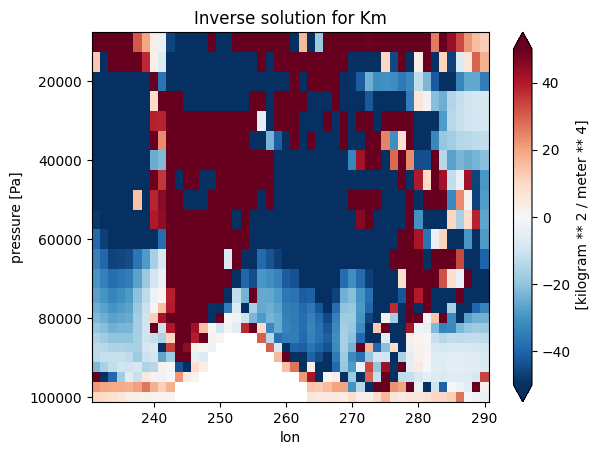

In [12]:
Km.mean('lat').plot(x='lon', vmax=50)
plt.gca().invert_yaxis()
plt.title('Inverse solution for Km')
plt.show()

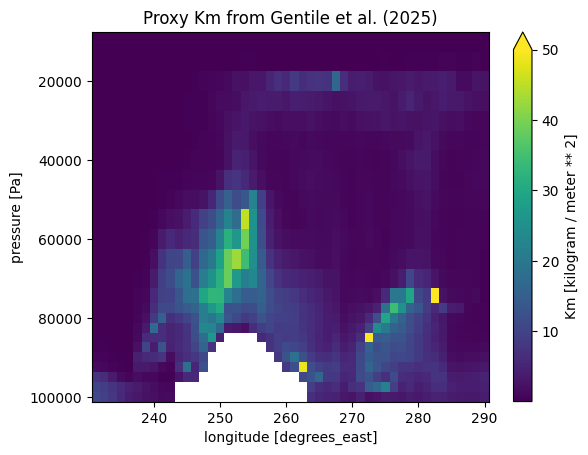

In [13]:
Km_basic.mean('lat').plot(x='lon', vmax=50)
plt.gca().invert_yaxis()
plt.title('Proxy Km from Gentile et al. (2025)')
plt.show()

### Plot

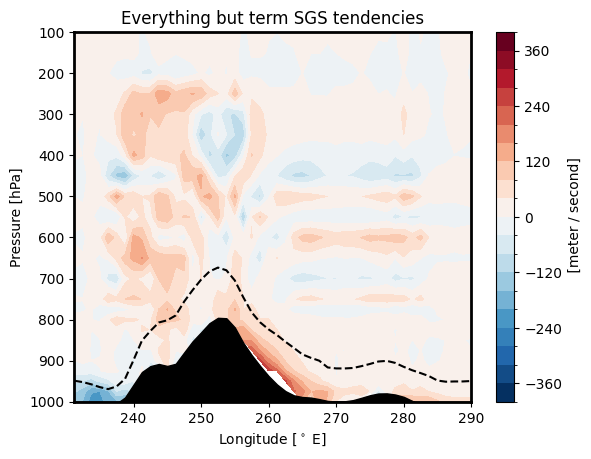

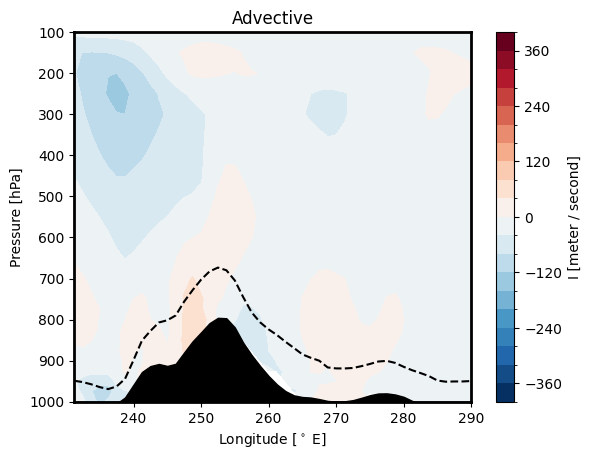

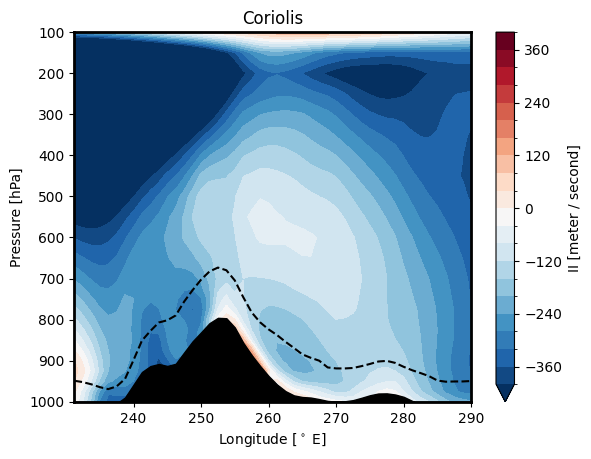

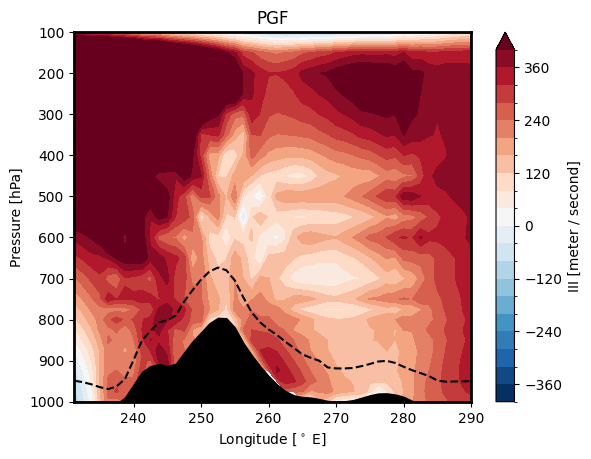

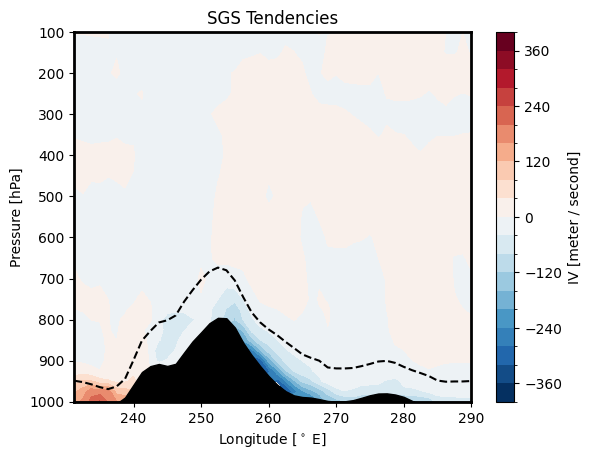

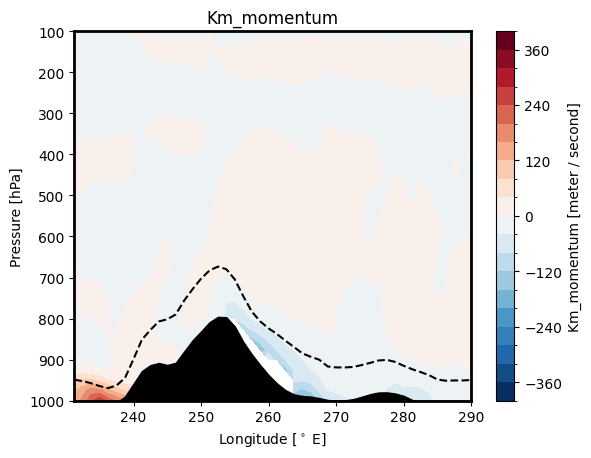

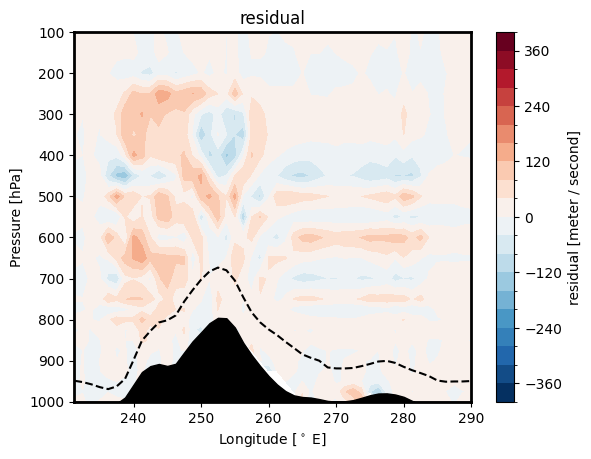

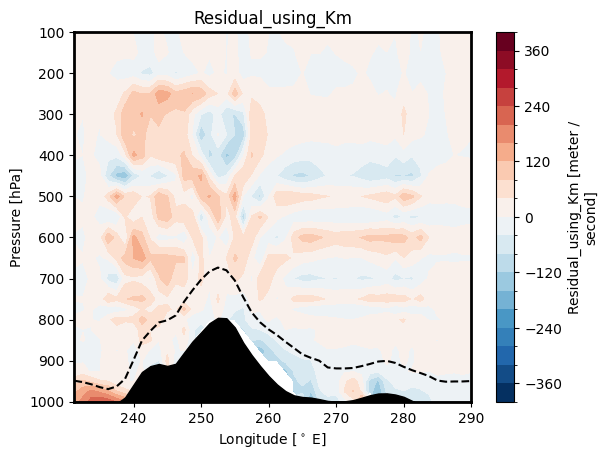

In [14]:
# Everything but SGS
foo = slice_rockies(ds_terms).mean('time')
bar = foo['I'] + foo['II'] + foo['III']
fig, ax = plt.subplots()
plot_rockies(ax, bar, ds_rockies, plot_kwargs={'levels':21, 'vmax': 400})
ax.set_title('Everything but term SGS tendencies')
plt.show()
term_names = dict(
    I = "Advective",
    II = "Coriolis",
    III = "PGF",
    IV = "SGS Tendencies",
)
# All other terms
for term in ['I', 'II', 'III', 'IV', 'Km_momentum', 'residual', 'Residual_using_Km']:
    da = slice_rockies(ds_terms[term]).mean('time')
    fig, ax = plt.subplots()
    plot_rockies(ax, da, ds_rockies, plot_kwargs={'levels':21, 'vmax': 400})
    try:
        ax.set_title(term_names[term])
    except: 
        ax.set_title(term)
    plt.show()

### Magnitude of terms

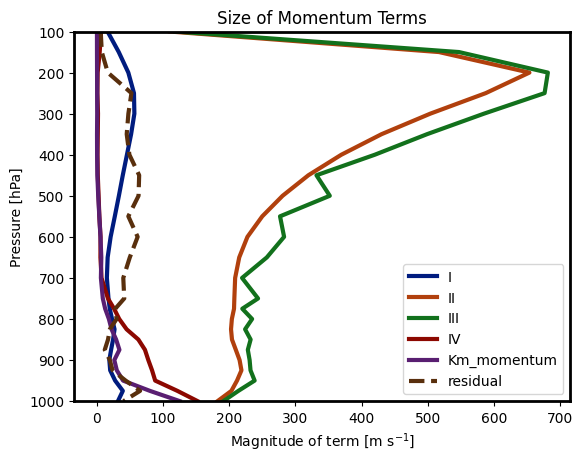

In [45]:
fig, ax = plt.subplots()
y = ds_rockies.plev.values
for term in ['I', 'II', 'III', 'IV', 'Km_momentum', 'residual']:
    da = slice_rockies(ds_terms[term]).mean('time')
    # Use apply_ufunc but this is quicker
    magnitude = []
    for plev in y:
        magnitude.append(rms(da.sel(plev=plev)))
    if term == 'residual' or term == 'residual2':
        ax.plot(magnitude, y, label=term, lw=3, linestyle='dashed')
    else:
        ax.plot(magnitude, y, label=term, lw=3)

ax.legend()
ax.invert_yaxis()
big_ax(ax)
ax.set_ylim([1000*100, 100*100])
ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Magnitude of term [m s$^{-1}$]')
ax.set_ylabel(r'Pressure [hPa]')
ax.set_title('Size of Momentum Terms')
plt.show()

## Figure - diurnal cycle of momentum terms

### Prep data

In [19]:
ds_sel = sel_region(ds[['U', 'V', 'UPWP_CLUBB', 'VPWP_CLUBB', 'Z3', 'RHO_CLUBB']], region='LLJ')\
    .sel(plev=slice(800*100, 975*100))\
    .sel(forcing='REF')
ds_llj = client.persist(ds_sel)
progress(ds_llj)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 16.21 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

2025-10-21 14:03:28,046 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 4.85 GiB -- Worker memory limit: 8.00 GiB


In [ ]:
# Normal terms
ds_terms = season_diurnal_cycle(
    spatial_mean(
        get_budget(ds_llj)
    )
)
ds_terms

In [23]:
Km = get_Km_gentile(ds_llj)
II = (-mpcalc.coriolis_parameter(ds_llj.lat) * ds_llj.U.metpy.quantify()).rename('II')
III = (-mpcalc.first_derivative(ds_llj.Z3.metpy.quantify() * mpconst.earth_gravity, axis='lat')).rename('III')
# Convert to scaled
II = II * 10e5 * units('s')
III = III * 10e5 * units('s')
ds_plot = season_diurnal_cycle(spatial_mean(xr.merge([Km, II, III]))).compute()
ds_plot

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 40.11 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(
2025-10-21 14:06:55,469 - distributed.protocol.pickle - ERROR - Failed to serialize <class 'pint.Quantity'>.
Traceback (most recent call last):
  File "/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/protocol/pickle.py", line 60, in dumps
    result = pickle.dumps(x, **dump_kwargs)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
_pickle.PicklingError: Can't pickle <class 'pint.Quantity'>: it's not the same object as pint.Quantity

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/va

<xarray.Dataset> Size: 14kB
Dimensions:  (season: 3, plev: 8, hour: 24)
Coordinates:
  * season   (season) object 24B 'DJF' 'JJA' 'MAM'
  * plev     (plev) int64 64B 80000 82500 85000 87500 90000 92500 95000 97500
  * hour     (hour) int64 192B 0 1 2 3 4 5 6 7 8 ... 15 16 17 18 19 20 21 22 23
    forcing  <U3 12B 'REF'
Data variables:
    Km       (hour, season, plev) float64 5kB <Quantity([[[  1.01655365   1.0...
    II       (hour, season, plev) float64 5kB <Quantity([[[-646.80262831 -565...
    III      (hour, season, plev) float64 5kB <Quantity([[[702.65284277 595.2...

### Plot

#### Mean cycle

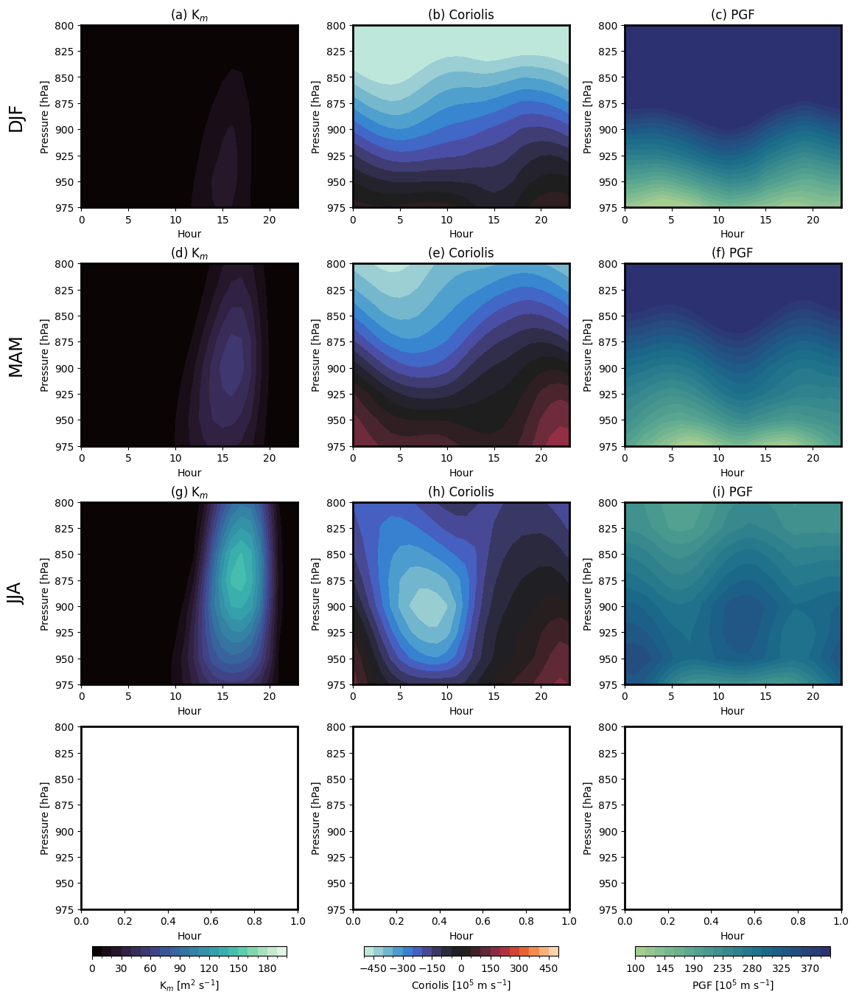

In [38]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)
label_cnt = 0

for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']):
    hourly_group = ds_plot.sel(season=season)
    # Km
    c0 = hourly_group.Km.plot.contourf(
        ax=axes[ax_cnt, 0],
        x='hour',
        vmin=0, 
        vmax=200,
        levels=21,
        add_colorbar=False,
        cmap=sns.color_palette("mako", as_cmap=True),
    )
    axes[ax_cnt, 0].set_title(f'({string.ascii_lowercase[label_cnt]}) K$_m$')
    # Coriolis
    c1 = hourly_group.II.plot.contourf(
        ax=axes[ax_cnt, 1],
        x='hour',
        vmax=500,
        levels=21,
        add_colorbar=False,
        cmap=sns.color_palette("icefire", as_cmap=True),
    )
    axes[ax_cnt, 1].set_title(f'({string.ascii_lowercase[label_cnt+1]}) Coriolis')
    # PGF
    c2 = hourly_group.III.plot.contourf(
        ax=axes[ax_cnt, 2],
        x='hour',
        vmin=100,
        vmax=400,
        levels=21,
        add_colorbar=False,
        cmap=sns.color_palette("crest", as_cmap=True),
    )
    axes[ax_cnt, 2].set_title(f'({string.ascii_lowercase[label_cnt+2]}) PGF')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt+=3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'Pressure [hPa]')

# fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
fig.colorbar(
    c0, ax=axes[:, 0],
    label=r'K$_m$ [m$^2$ s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
fig.colorbar(
    c1, ax=axes[:, 1],
    label=r'Coriolis [10$^5$ m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
fig.colorbar(
    c2, ax=axes[:, 2],
    label=r'PGF [10$^5$ m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
plt.show()

#### Daily pertubation

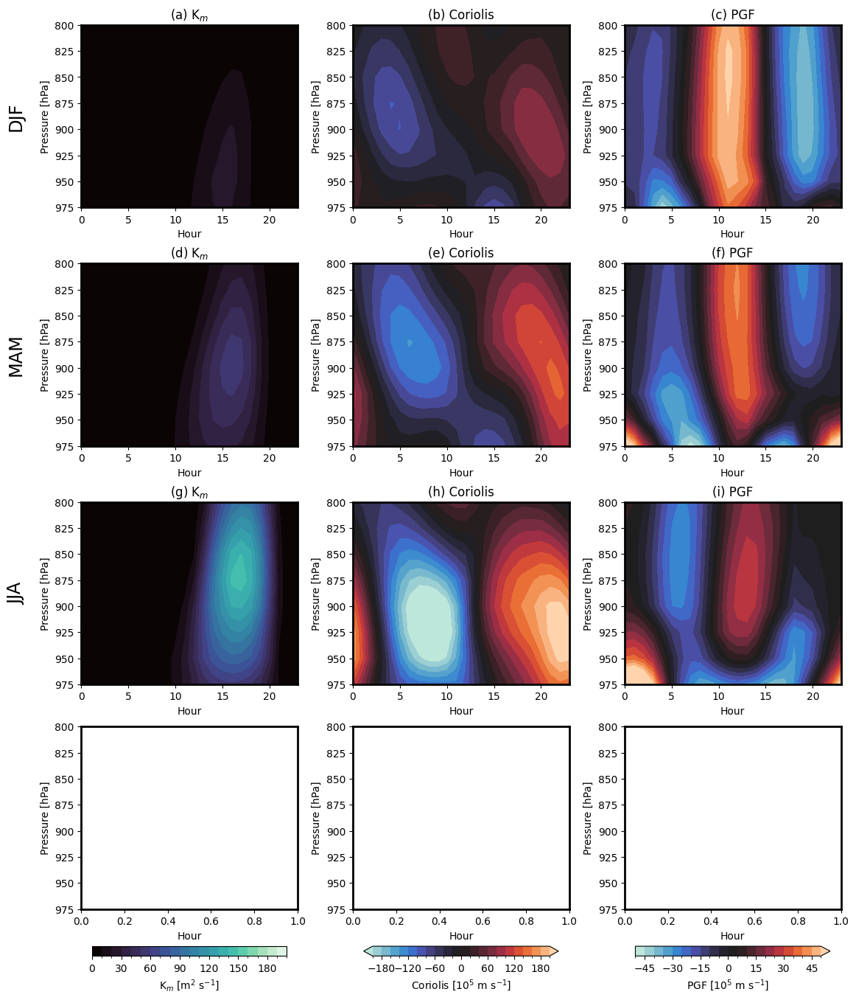

In [40]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)

label_cnt = 0

for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']):
    hourly_group = ds_plot.sel(season=season)
    perturb = hourly_group - hourly_group.mean('hour')
    # Km (NOT USING PERTUBATION)
    c0 = hourly_group.Km.plot.contourf(
        ax=axes[ax_cnt, 0],
        x='hour',
        vmin=0, 
        vmax=200,
        levels=21,
        add_colorbar=False,
        cmap=sns.color_palette("mako", as_cmap=True),
    )
    axes[ax_cnt, 0].set_title(f'({string.ascii_lowercase[label_cnt]}) K$_m$')
    # Coriolis
    c1 = perturb.II.plot.contourf(
        ax=axes[ax_cnt, 1],
        x='hour',
        vmax=200,
        levels=21,
        add_colorbar=False,
        cmap=sns.color_palette("icefire", as_cmap=True),
    )
    axes[ax_cnt, 1].set_title(f'({string.ascii_lowercase[label_cnt+1]}) Coriolis')
    # PGF
    c2 = perturb.III.plot.contourf(
        ax=axes[ax_cnt, 2],
        x='hour',
        vmax=50,
        levels=21,
        add_colorbar=False,
        cmap=sns.color_palette("icefire", as_cmap=True),
    )
    axes[ax_cnt, 2].set_title(f'({string.ascii_lowercase[label_cnt+2]}) PGF')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt+=3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'Pressure [hPa]')

# fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
fig.colorbar(
    c0, ax=axes[:, 0],
    label=r'K$_m$ [m$^2$ s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
fig.colorbar(
    c1, ax=axes[:, 1],
    label=r'Coriolis [10$^5$ m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
fig.colorbar(
    c2, ax=axes[:, 2],
    label=r'PGF [10$^5$ m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.005,
)
plt.show()

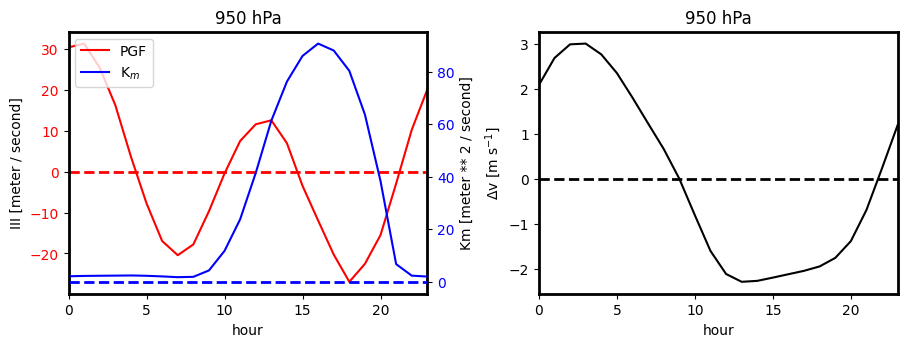

In [140]:
# Example plot of diurnal cycle
foo = hourly_groups[2]
lev = 950

fig, axes = plt.subplots(ncols=2, figsize=(6.4*2*0.7, 4.8*1*0.7), layout='constrained')
# Plot 1 - Terms
# Commas are essential to save lines
ax1 = axes[0]
l1, = (foo.sel(plev=lev*100).III-foo.sel(plev=lev*100).III.mean()).plot(ax=ax1, color='r', label='PGF')
ax2 = ax1.twinx()
l2, = foo.sel(plev=lev*100).Km.plot(ax=ax2, label='K$_m$', color='b')

for ax, c in ((ax1,'r'),(ax2,'b')):
    [lbl.set_color(c) for lbl in ax.get_yticklabels()]

# Some other stuff
ax1.hlines(0, 0, 23, color='r', lw=2, linestyle='dashed')
ax2.hlines(0, 0, 23, color='b', lw=2, linestyle='dashed')
ax1.set_xlim(0, 23)
big_ax(ax1)
# ax.legend()
# ax1.grid(color='black', axis='x', alpha=0.5, linestyle='dotted')
# ax1.grid(color='red',   axis='y', linestyle='dotted')
# ax2.grid(color='blue',  axis='y', linestyle='dotted')

ax.legend((l1,l2), ('PGF', 'K$_m$'))
ax1.set_title(f'{lev} hPa')
ax2.set_title('')

# Plot 2 - Cycle of winds
ax = axes[1]
(foo.sel(plev=lev*100).V-foo.sel(plev=lev*100).V.mean()).plot(ax=ax, color='k')
ax.set_title(f'{lev} hPa')
ax.set_ylabel(r'$\Delta$v [m s$^{-1}$]')
ax.hlines(0, 0, 23, color='k', lw=2, linestyle='dashed')
big_ax(ax)
ax.set_xlim(0, 23)

plt.show()

In [41]:
del ds_llj
gc.collect()

269524

## Figure - PGF buoyancy force

Take data from the summer season.

### Prep data

In [35]:
ds_sel = ds[['U', 'OMEGA', 'Z3', 'orog', 'PBLH', 'orog_plev', 'RHO_CLUBB']]\
    .sel(plev=slice(100*100, None))\
    .where(ds['time.month'].isin([6,7,8]), drop=True)\
    .where(rockies_mask, drop=True)\
    .sel(forcing='REF')
future = client.compute(ds_sel)
progress(future)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 18.00 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [40]:
ds_rockies = future.result()
# ZONAL pressure gradient force
pgf = -mpcalc.first_derivative(ds_rockies.Z3.metpy.quantify() * mpconst.earth_gravity, axis='lon') * 10e5 * units('s') ### TESTING WITH LONGITUDE
# Get daily means
mean_pgf = slice_rockies(pgf).mean('time') * 10e5 * units('s')
winds_mean = slice_rockies(ds_rockies[['U', 'OMEGA']]).mean('time')
winds_mean['OMEGA_50x'] = winds_mean['OMEGA'] * 50

### Plot

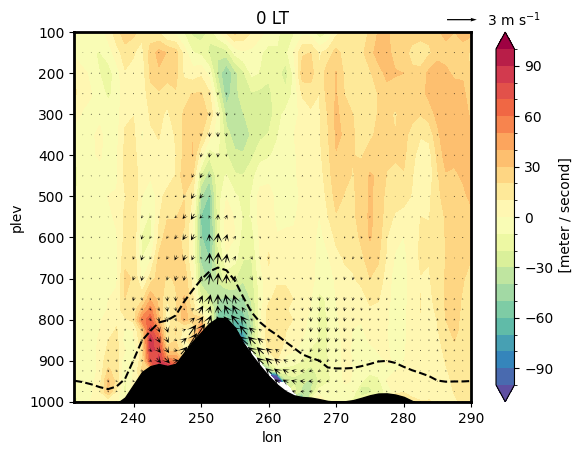

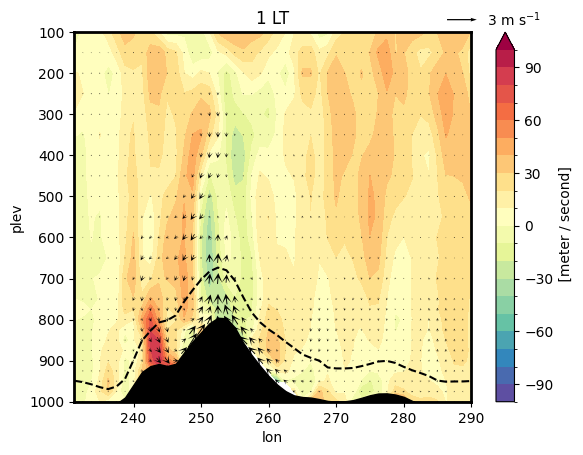

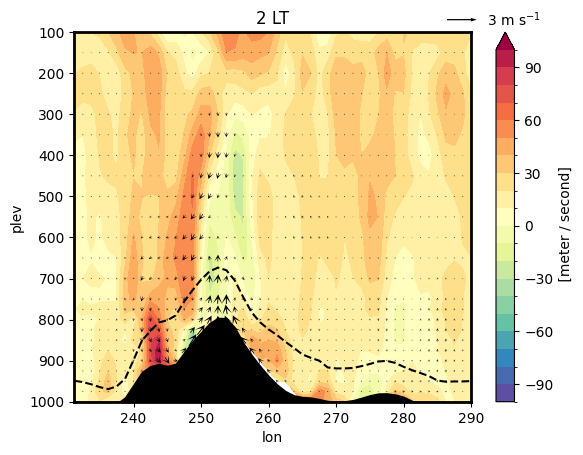

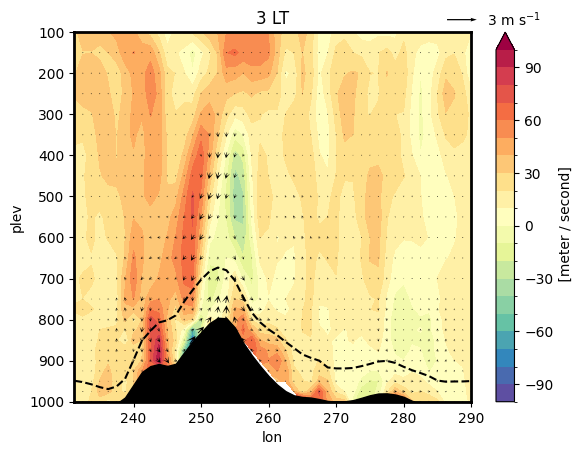

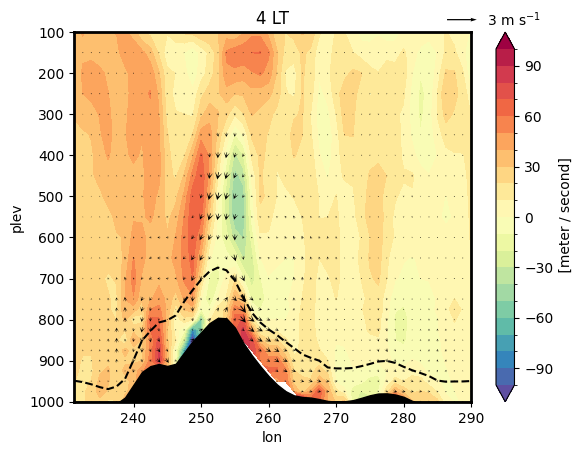

...

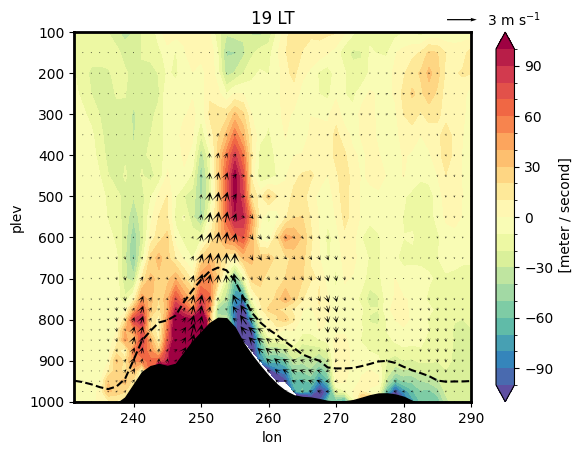

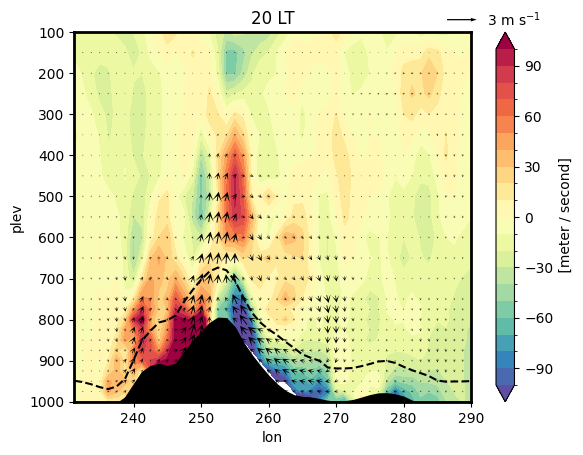

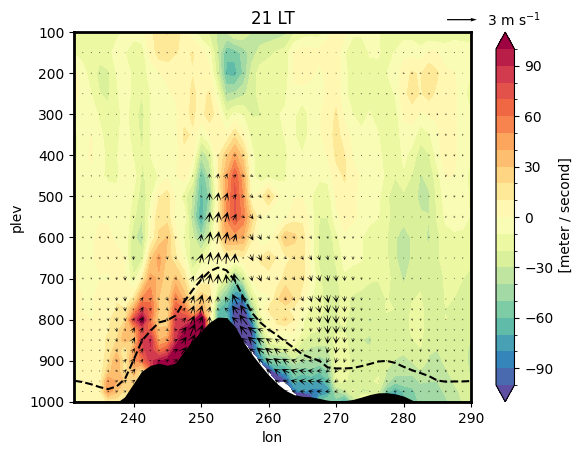

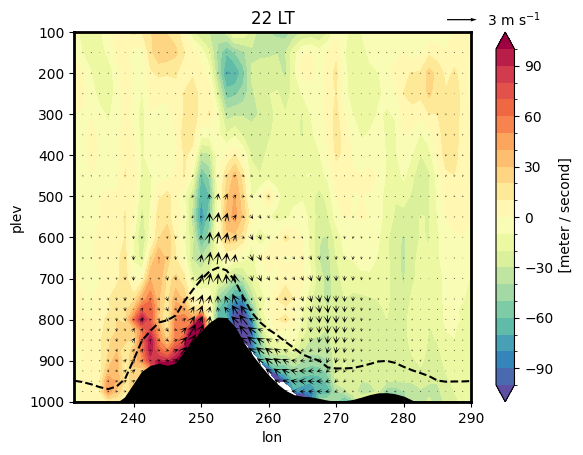

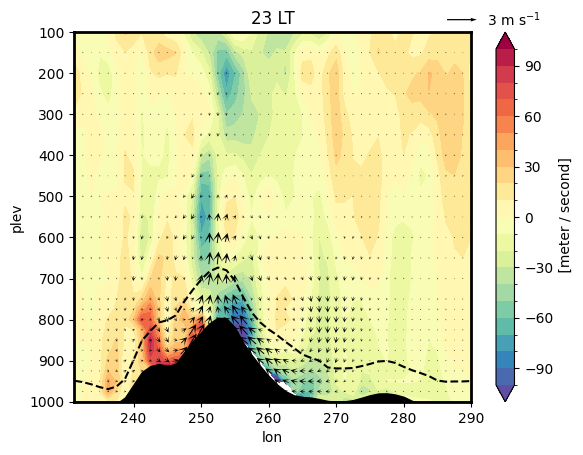

In [50]:
foo = slice_rockies(ds_rockies[['U', 'OMEGA']]).groupby('time.hour').mean() - slice_rockies(ds_rockies[['U', 'OMEGA']]).mean('time')
foo['OMEGA_50x'] = foo['OMEGA'] * 50 * -1 # Positive omega is down

bar = slice_rockies(pgf).groupby('time.hour').mean() - slice_rockies(pgf).mean('time')

for hour in foo.hour.values:
    fig, ax = plt.subplots()
    plot_rockies(
        ax, bar.sel(hour=hour), ds_rockies, 
        plot_kwargs={
            'levels':21,
            'vmax':100,
            'cmap': sns.color_palette('Spectral_r', as_cmap=True),     
        }
    )
    foo.sel(hour=hour).plot.quiver(
        x='lon', y='plev',
        u='U', v='OMEGA_50x',
        add_guide=False,
        scale=150, 
        headwidth=10, headlength=10,
    )
    ref_magnitude = 3
    ax.quiverkey(
        q, X=0.8, Y=1.05, U=ref_magnitude, 
        label=f'{ref_magnitude}'+' m s$^{-1}$', 
        labelpos='E'
    )
    ax.set_title(f'{hour} LT')
    plt.show()

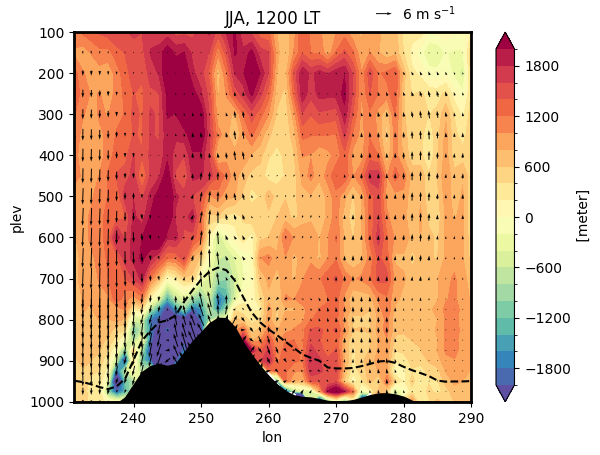

In [81]:
# 12 LT 
# Get daily pertubation
at_time = ds_rockies['time.hour'] == 12
pgf_time = slice_rockies(pgf.where(at_time, drop=True)).mean('time') * 10*5 * units('s')
winds_time = slice_rockies(ds_rockies[['U', 'OMEGA']].where(at_time, drop=True)).mean('time')
winds_time['OMEGA_50x'] = winds_time['OMEGA'] * 50 * -1 # Positive omega is down

fig, ax = plt.subplots()
plot_rockies(
    ax, pgf_time-mean_pgf, ds_rockies, 
    plot_kwargs={'levels':21, 'vmax':2000, 'cmap': sns.color_palette('Spectral_r', as_cmap=True)}
)
q = (winds_time-winds_mean).plot.quiver(
    x='lon', y='plev',
    u='U', v='OMEGA_50x',
    add_guide=False,
    scale=150, 
)
ref_magnitude = 6
ax.quiverkey(
    q, X=0.8, Y=1.05, U=ref_magnitude, 
    label=f'{ref_magnitude}'+' m s$^{-1}$', 
    labelpos='E'
)
ax.set_title('JJA, 1200 LT')
plt.show()

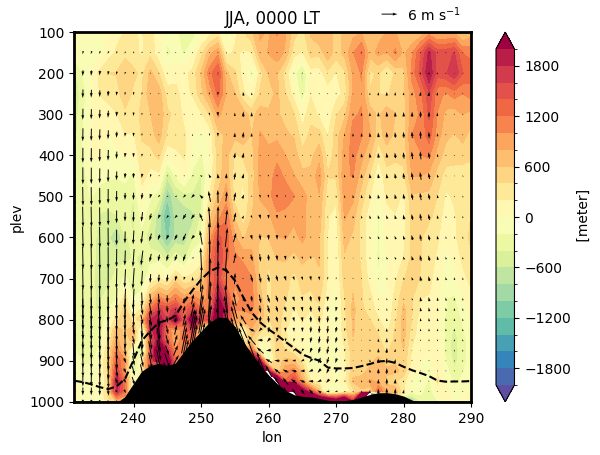

In [82]:
# 0000 LT 
# Get daily pertubation
at_time = ds_rockies['time.hour'] == 0
pgf_time = slice_rockies(pgf.where(at_time, drop=True)).mean('time') * 10*5 * units('s')
winds_time = slice_rockies(ds_rockies[['U', 'OMEGA']].where(at_time, drop=True)).mean('time')
winds_time['OMEGA_50x'] = winds_time['OMEGA'] * 50 * -1 # Positive omega is down

fig, ax = plt.subplots()
plot_rockies(
    ax, pgf_time-mean_pgf, ds_rockies, 
    plot_kwargs={'levels':21, 'vmax':2000, 'cmap': sns.color_palette('Spectral_r', as_cmap=True)}
)
(winds_time-winds_mean).plot.quiver(
    x='lon', y='plev',
    u='U', v='OMEGA_50x',
    add_guide=False,
    scale=150, 
    
)
ref_magnitude = 6
ax.quiverkey(
    q, X=0.8, Y=1.05, U=ref_magnitude, 
    label=f'{ref_magnitude}'+' m s$^{-1}$', 
    labelpos='E'
)
ax.set_title('JJA, 0000 LT')
plt.show()

## Figure - wind veering in LLJ region

### Prep data

In [7]:
ds_sel = ds[['U', 'V', 'OMEGA']]\
    .sel(plev=slice(100*100, None))\
    .where(ds['time.month'].isin([6,7,8]), drop=True)\
    .where(llj_mask, drop=True)\
    .sel(forcing='REF')
future = client.compute(ds_sel)
progress(future)

VBox()

In [15]:
ds_rockies = future.result()
# Get hourly cycle
winds = llj_region_mean(ds_rockies[['U', 'V', 'OMEGA']].groupby('time.hour').mean())
winds['OMEGA_50x'] = winds['OMEGA'] * 50 
perturb = winds - winds.mean('hour')
perturb

<xarray.Dataset> Size: 19kB
Dimensions:    (plev: 24, hour: 24)
Coordinates:
    forcing    <U3 12B 'REF'
  * plev       (plev) int64 192B 10000 15000 20000 25000 ... 95000 97500 100000
  * hour       (hour) int64 192B 0 1 2 3 4 5 6 7 8 ... 16 17 18 19 20 21 22 23
Data variables:
    U          (hour, plev) float64 5kB -0.1872 -0.03985 ... -1.771 -1.162
    V          (hour, plev) float64 5kB 0.2325 -0.0001978 ... 0.9966 1.251
    OMEGA      (hour, plev) float64 5kB 0.001285 0.000126 ... -0.001869
    OMEGA_50x  (hour, plev) float64 5kB 0.06426 0.006298 ... -0.2293 -0.09344

### Plot

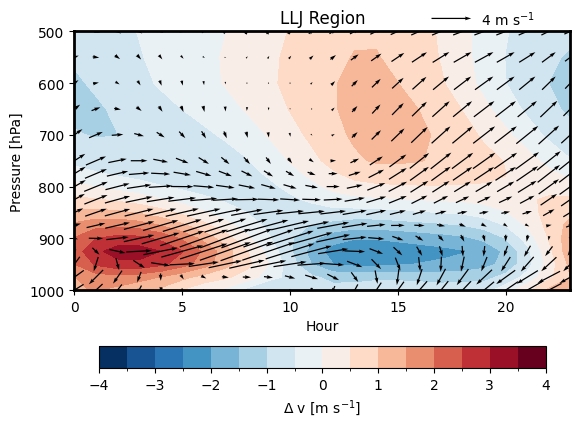

In [34]:
fig, ax = plt.subplots()
c0 = perturb.V.plot.contourf(
    ax=ax,
    x='hour',
    levels=17,
    vmax=4,
    add_colorbar=False,
    cmap='RdBu_r',
)
q = winds.plot.quiver(
    x='hour', y='plev',
    u='U', v='OMEGA_50x',
    add_guide=False,
    scale=50, 
    
)
ref_magnitude = 4
ax.quiverkey(
    q, X=0.8, Y=1.05, U=ref_magnitude, 
    label=f'{ref_magnitude}'+' m s$^{-1}$', 
    labelpos='E'
)
ax.set_title('LLJ Region')
big_ax(ax)
ax.set_ylim([1000*100, 500*100])
ticks = np.array([1000, 900, 800, 700, 600, 500])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel('Hour')
ax.set_ylabel('Pressure [hPa]')
fig.colorbar(
    c0, ax=ax,
    label=r'$\Delta$ v [m s$^{-1}$]',
    shrink=0.9,
    orientation='horizontal',
    pad=0.15,
)
plt.show()

## Figure - vertical diffusion

Try using subgrid term.

### Prep data

In [15]:
ds_sel = season_diurnal_cycle(
    spatial_mean(
        sel_region(ds.FV, 'LLJ')
    )
)
FV = client.persist(ds_sel)
progress(FV)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 10.59 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [22]:
FV = FV * 10e5
difference = FV - FV.sel(forcing='REF')

### Plot 

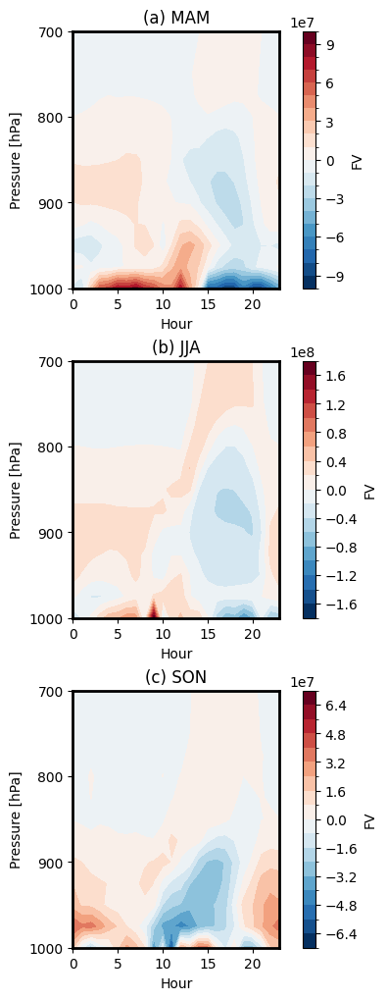

In [26]:
fig, axes = plt.subplots(
    ncols=1, nrows=3, figsize=(6.4*0.6, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    hourly = difference.sel(season=season, forcing='4xCO2')
    perturb = hourly - hourly.mean('hour')
    c0 = perturb.plot.contourf(
        ax=axes[ax_cnt],
        x='hour',
        # vmax=50,
        # vmax=150,
        levels=21,
        add_colorbar=True,
        cmap='RdBu_r'#sns.color_palette("icefire", as_cmap=True),
    )
    # perturb.plot.contour(
    #     ax=axes[ax_cnt],
    #     x='hour',
    #     vmax=50,
    #     levels=17,
    #     add_colorbar=False,
    #     colors='black',
    # )
    axes[ax_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {season}')
    label_cnt+=1
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 700*100])
    ticks = np.array([1000, 900, 800, 700])#,, 600, 500])# 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour')
    ax.set_ylabel(r'Pressure [hPa]')

# fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
# fig.colorbar(
#     c0, ax=axes[:],
#     label=r'Vertical Diffusion [10$^5$ m s$^{-1}$]',
#     shrink=0.9,
#     orientation='horizontal',
#     pad=0.005,
# )
plt.show()

# Plots of jet/momentum changes

## Figure - change in nocturnal jet strength

### Prep data

In [5]:
orog_plev = meridional_mean(sel_region(ds.orog_plev, 'rockies'))
ds_sel = meridional_mean(
    sel_region(ds.V, 'rockies')
    .where(ds['time.hour'] == 3, drop=True) # 0300 LT
    .groupby('time.season').mean()
)
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 16.73 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

### Plot

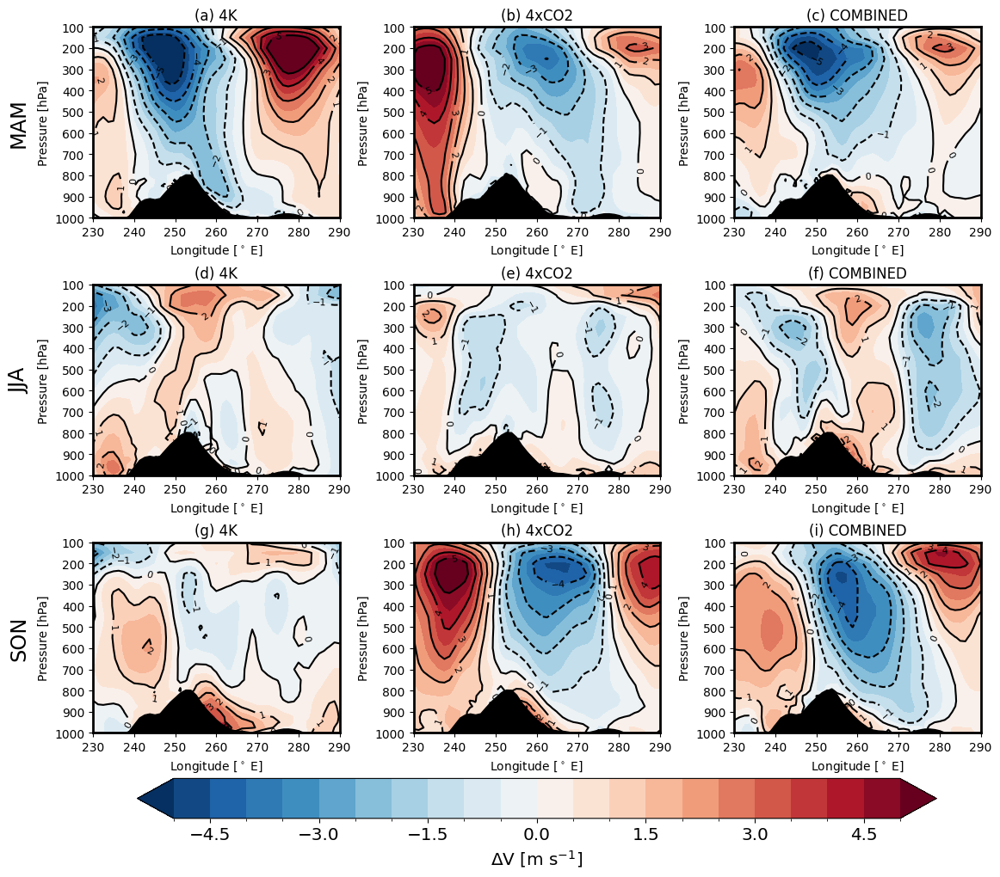

In [8]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    da_ref = ds_plot.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = ds_plot.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            levels=5*4+1,
            vmax=5,
            add_colorbar=False,
            cmap='RdBu_r',
            extend='both'
        )
        contours = difference.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            levels=5*2+1,
            vmax=5,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')        
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005,
)
cbar.set_label(r'$\Delta$V [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

## Figure - column momentum budget

### Prep data

In [5]:
season = 'MAM'

In [6]:
var_list = [
    'U', 'V', 'OMEGA', 'Z3', 
    'FV', 'FU', 'orog', 
    'UPWP_CLUBB', 'VPWP_CLUBB', 
    'orog_plev', 'RHO_CLUBB', 
    'T'
]

month_map = dict(
    MAM=[3,4,5],
    JJA=[6,7,8],
    SON=[9,10,11],
)
ds_sel = sel_region(ds[var_list], 'LLJ')\
    .where(ds['time.month'].isin(month_map[season]), drop=True)
ds_vars = client.persist(ds_sel)
progress(ds_vars)

!!! Using a different bounding box to test !!!

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 72.82 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

2025-11-10 12:02:43,520 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 9.62 GiB -- Worker memory limit: 16.00 GiB
2025-11-10 12:02:58,363 - distributed.worker.memory - WARNING - Unmanaged memory use is high. This may indicate a memory leak or the memory may not be released to the OS; see https://distributed.dask.org/en/latest/worker-memory.html#memory-not-released-back-to-the-os for more information. -- Unmanaged memory: 10.21 GiB -- Worker memory limit: 16.00 GiB


In [ ]:
ds_vars = ds_vars.compute()
ds_vars

#### Get budget

800-975 hPa mean.

In [7]:
meridional_terms = get_budget(ds_vars).sel(plev=slice(800*100, 975*100))
zonal_terms = get_zonal_budget(ds_vars).sel(plev=slice(800*100, 975*100))
meridional_mag = season_diurnal_cycle(spatial_mean(meridional_terms)).squeeze()
zonal_mag = season_diurnal_cycle(spatial_mean(zonal_terms)).squeeze()

#### Wind speeds

In [8]:
def mean_by_year(ds):
    spatial = spatial_mean(ds)
    return spatial.groupby('time.year').map(season_diurnal_cycle)
    
winds = mean_by_year(ds_vars[['U', 'V']]).squeeze()
Ug, Vg = mpcalc.geostrophic_wind(ds_vars.Z3.metpy.quantify().squeeze()*mpconst.earth_gravity)
winds['Ug'] = mean_by_year(Ug.metpy.dequantify())
winds['Vg'] = mean_by_year(Vg.metpy.dequantify())
# Reduce to mean in jet region
winds = winds.sel(plev=slice(800*100, 975*100)).mean('plev')
wind_changes = (
    winds.sel(forcing=winds.forcing.isin(['4K', '4xCO2', 'COMBINED'])) - winds.sel(forcing='REF')
)
winds

<xarray.Dataset> Size: 6kB
Dimensions:  (year: 2, forcing: 4, hour: 24, season: 1)
Coordinates:
  * forcing  (forcing) object 32B '4K' '4xCO2' 'COMBINED' 'REF'
  * season   (season) object 8B 'JJA'
  * hour     (hour) int64 192B 0 1 2 3 4 5 6 7 8 ... 15 16 17 18 19 20 21 22 23
  * year     (year) int64 16B 1979 1980
Data variables:
    U        (year, forcing, hour) float64 2kB -0.1403 0.4737 ... -0.7847
    V        (year, forcing, hour) float64 2kB 8.996 9.434 9.633 ... 7.385 8.193
    Ug       (forcing, year, season, hour) float64 2kB 4.133 4.181 ... 3.795
    Vg       (forcing, year, season, hour) float64 2kB 6.443 6.183 ... 6.663

### Plot

#### Wind speeds

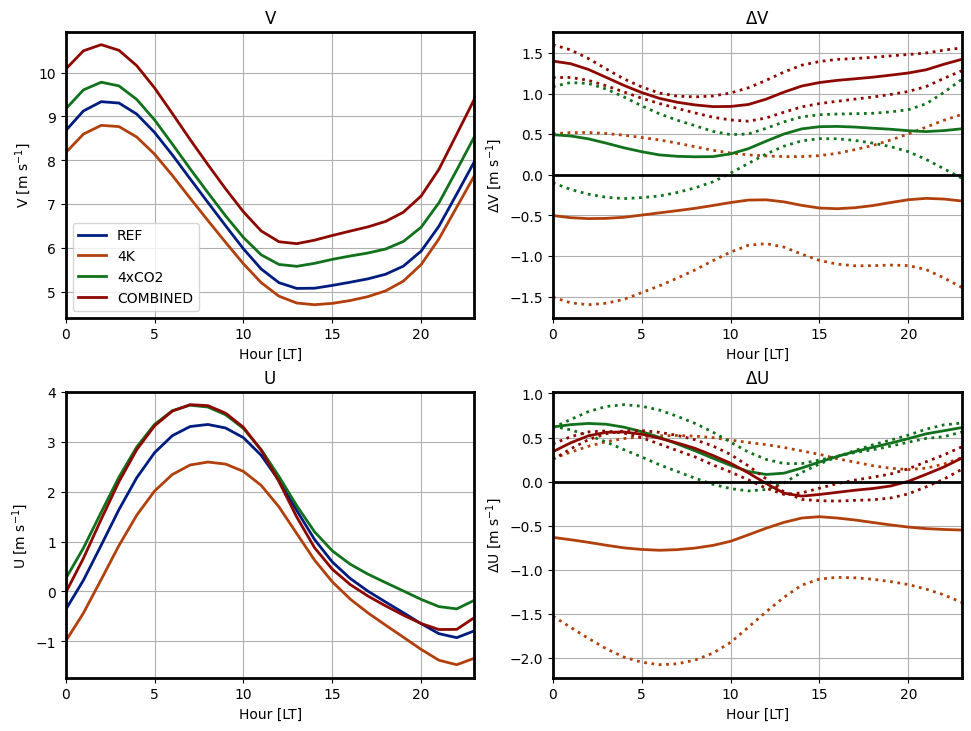

In [10]:
# Top two panels V, bottom two U
colors = list(sns.color_palette('dark', 4))
fig, axes = plt.subplots(ncols=2, nrows=2, figsize=(6.4*1.5, 4.8*1.5), layout='constrained')

for c, forcing in zip(colors, ['REF', '4K', '4xCO2', 'COMBINED']):
    r = winds.sel(forcing=forcing)
    # Mean winds
    r.V.mean('year').plot(ax=axes[0, 0], color=c, lw=2, label=forcing)
    r.U.mean('year').plot(ax=axes[1, 0], color=c, lw=2)
    # for i in range(len(r.year)):
    #     r.V.isel(year=i).plot(ax=axes[0,0], color=c, alpha=0.3)
    #     r.U.isel(year=i).plot(ax=axes[1,0], color=c, alpha=0.3)
    
    if forcing != 'REF':
        p = wind_changes.sel(forcing=forcing)
        # Changes
        p.V.mean('year').plot(ax=axes[0, 1], color=c, lw=2)
        p.U.mean('year').plot(ax=axes[1, 1], color=c, lw=2)
        for i in range(len(p.year)):
            p.V.isel(year=i).plot(ax=axes[0,1], color=c, lw=2, linestyle='dotted')
            p.U.isel(year=i).plot(ax=axes[1,1], color=c, lw=2, linestyle='dotted')

axes[0, 0].set_title('V')
axes[0, 0].set_ylabel('V [m s$^{-1}$]')
axes[0, 1].set_title(r'$\Delta$V')
axes[0, 1].set_ylabel(r'$\Delta$V [m s$^{-1}$]')
axes[1, 0].set_title('U')
axes[1, 0].set_ylabel('U [m s$^{-1}$]')
axes[1, 1].set_title(r'$\Delta$U')
axes[1, 1].set_ylabel(r'$\Delta$U [m s$^{-1}$]')

axes[0, 1].hlines(0, 0, 23, lw=2, color='k')
axes[1, 1].hlines(0, 0, 23, lw=2, color='k')

for ax in axes.flatten():
    ax.set_xlim(0, 23)
    ax.grid()
    big_ax(ax)
    ax.set_xlabel('Hour [LT]')
axes[0, 0].legend()
fig.suptitle(season)
plt.show()

#### Hodographs

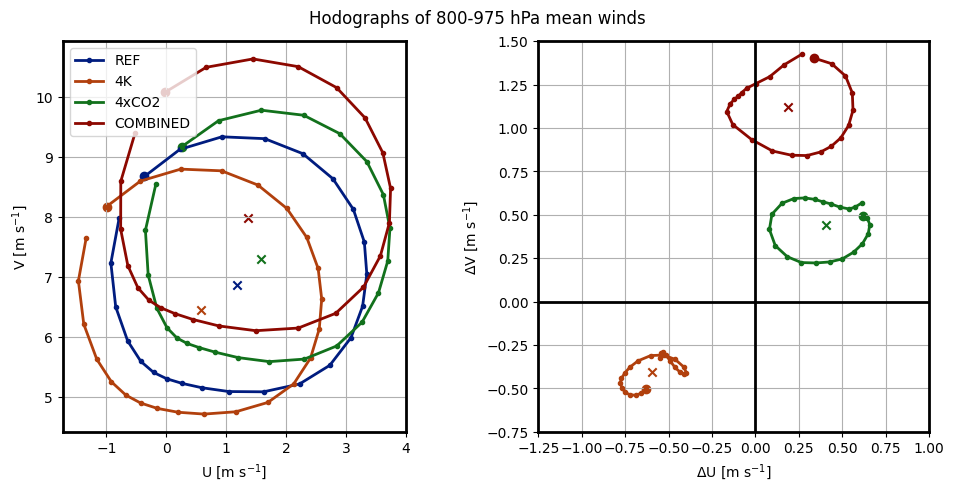

In [11]:
# Top two panels V, bottom two U
colors = list(sns.color_palette('dark', 4))
fig, axes = plt.subplots(
    ncols=2, nrows=1, figsize=(6.4*1.5, 4.8*1), layout='constrained', 
    subplot_kw=dict(aspect='equal'),
)

for c, forcing in zip(colors, ['REF', '4K', '4xCO2', 'COMBINED']):
    r = winds.sel(forcing=forcing)
    # Mean winds
    U = r.U.mean('year').values
    V = r.V.mean('year').values
    axes[0].plot(
        U, V, color=c, lw=2, marker='o', label=forcing, markersize=3,
    )
    axes[0].scatter(
        U[0], V[0], color=c,
    )
    axes[0].scatter(
        np.mean(U), np.mean(V), color=c, marker='x'
    )
    
    if forcing != 'REF':
        p = wind_changes.sel(forcing=forcing)
        # Changes
        U = p.U.mean('year').values
        V = p.V.mean('year').values
        axes[1].plot(
            U, V, color=c, lw=2, marker='o', markersize=3,
        )
        axes[1].scatter(
            U[0], V[0], color=c,
        )
        axes[1].scatter(
            np.mean(U), np.mean(V), color=c, marker='x'
        )


axes[0].set_ylabel(r'V [m s$^{-1}$]')
axes[0].set_xlabel(r'U [m s$^{-1}$]')
axes[1].set_ylabel(r'$\Delta$V [m s$^{-1}$]')
axes[1].set_xlabel(r'$\Delta$U [m s$^{-1}$]')

axes[1].vlines(0, -0.75, 1.5, lw=2, color='k')
axes[1].hlines(0, -1.25, 1, lw=2, color='k')
axes[1].set_ylim(-0.75, 1.5)
axes[1].set_xlim(-1.25, 1)

for ax in axes:
    ax.grid()
    big_ax(ax)
axes[0].legend()
fig.suptitle('Hodographs of 800-975 hPa mean winds')
plt.show()

#### Geostrophic wind speeds

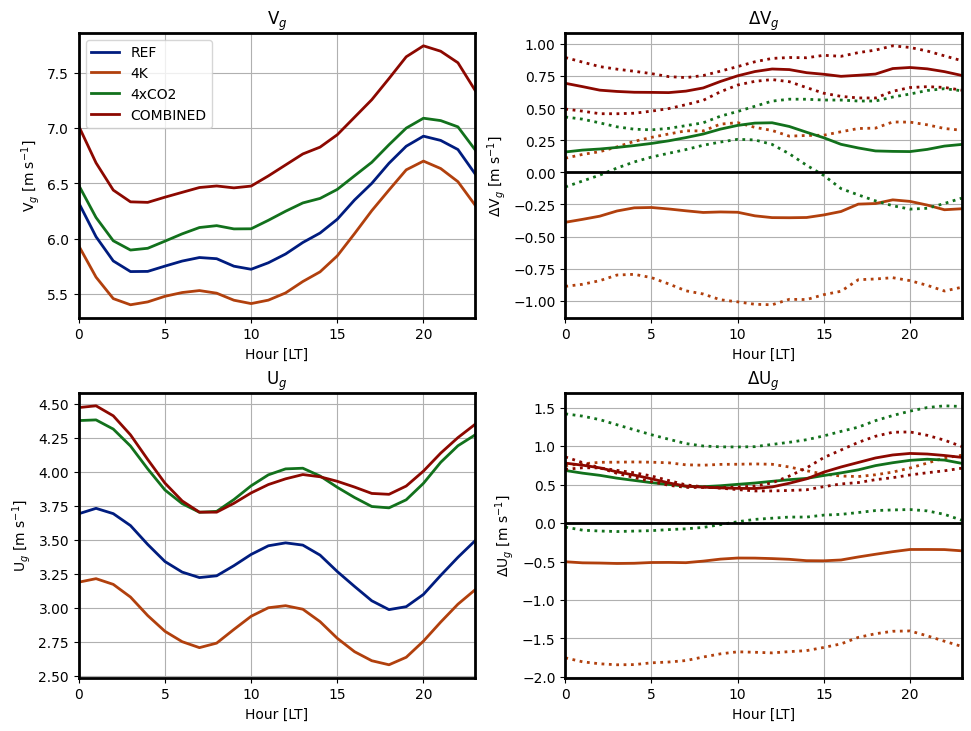

In [12]:
# Top two panels V, bottom two U
colors = list(sns.color_palette('dark', 4))
fig, axes = plt.subplots(ncols=2, nrows=2, figsize=(6.4*1.5, 4.8*1.5), layout='constrained')

for c, forcing in zip(colors, ['REF', '4K', '4xCO2', 'COMBINED']):
    r = winds.sel(forcing=forcing)
    # Mean winds
    r.Vg.mean('year').plot(ax=axes[0, 0], color=c, lw=2, label=forcing)
    r.Ug.mean('year').plot(ax=axes[1, 0], color=c, lw=2)
    # for i in range(len(r.year)):
    #     r.V.isel(year=i).plot(ax=axes[0,0], color=c, alpha=0.3)
    #     r.U.isel(year=i).plot(ax=axes[1,0], color=c, alpha=0.3)
    
    if forcing != 'REF':
        p = wind_changes.sel(forcing=forcing)
        # Changes
        p.Vg.mean('year').plot(ax=axes[0, 1], color=c, lw=2)
        p.Ug.mean('year').plot(ax=axes[1, 1], color=c, lw=2)
        for i in range(len(p.year)):
            p.Vg.isel(year=i).plot(ax=axes[0,1], color=c, lw=2, linestyle='dotted')
            p.Ug.isel(year=i).plot(ax=axes[1,1], color=c, lw=2, linestyle='dotted')

axes[0, 0].set_title('V$_g$')
axes[0, 0].set_ylabel('V$_g$ [m s$^{-1}$]')
axes[0, 1].set_title(r'$\Delta$V$_g$')
axes[0, 1].set_ylabel(r'$\Delta$V$_g$ [m s$^{-1}$]')
axes[1, 0].set_title('U$_g$')
axes[1, 0].set_ylabel('U$_g$ [m s$^{-1}$]')
axes[1, 1].set_title(r'$\Delta$U$_g$')
axes[1, 1].set_ylabel(r'$\Delta$U$_g$ [m s$^{-1}$]')

axes[0, 1].hlines(0, 0, 23, lw=2, color='k')
axes[1, 1].hlines(0, 0, 23, lw=2, color='k')

for ax in axes.flatten():
    ax.set_xlim(0, 23)
    ax.grid()
    big_ax(ax)
    ax.set_xlabel('Hour [LT]')
axes[0, 0].legend()
plt.show()

#### Meridional Momentum

95% C.I. across pressure levels.

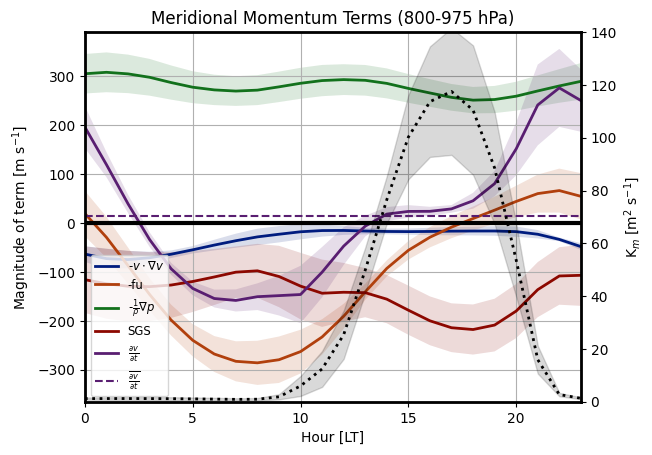

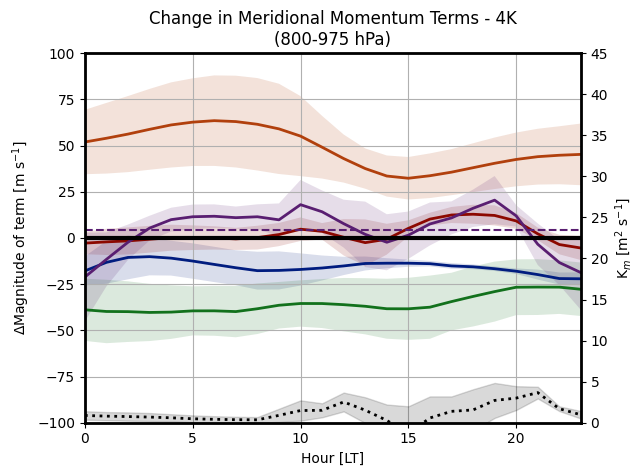

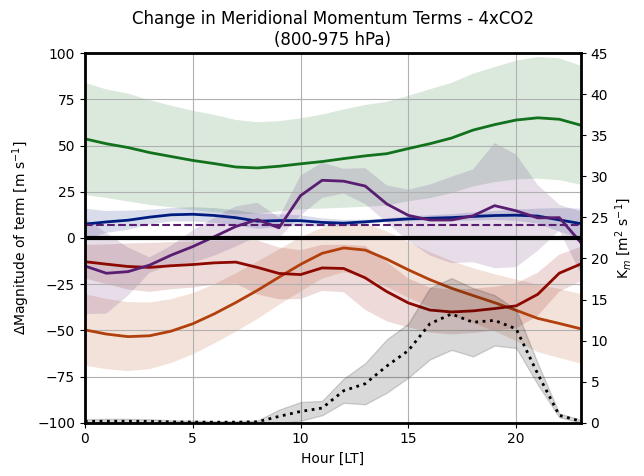

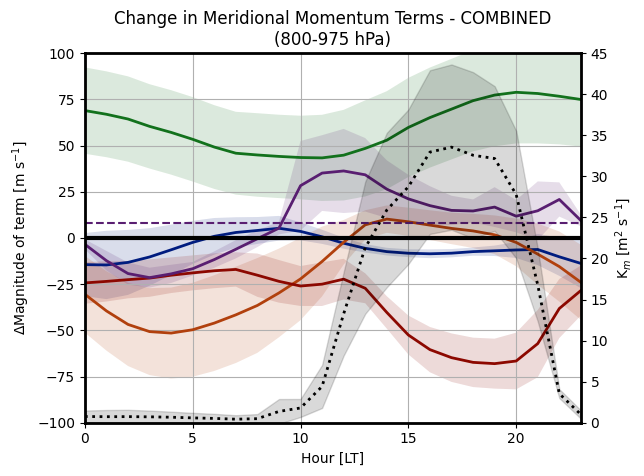

In [13]:
def diurnal_meridional_terms(magnitude):
    """
    Magnitude of momentum terms
    """
    fig, ax = plt.subplots()
    renamed = dict(
        I = r'-$v \cdot \nabla v$',
        II = '-fu',
        III = r'-$\frac{1}{\rho}\nabla p$',
        IV = 'SGS',
    )
    sel = dict(
        forcing='REF',
    )
    for term in ['I', 'II', 'III', 'IV']:
        da = magnitude.sel(sel)[term]
        mean, ci_lower, ci_upper = mean_95(da, 'plev')
        mean.plot(
            ax=ax, x='hour', lw=2,
            label=renamed[term]
        )
        ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    residual = magnitude.sel(sel).residual
    mean, ci_lower, ci_upper = mean_95(residual, 'plev')
    mean.plot(
            ax=ax, x='hour', lw=2,
            label=r'$\frac{\partial v}{\partial t}$',
        )
    ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    # Mean residual (aka error)
    mean_residual = np.mean(residual.values)
    ax.axhline(
        mean_residual, 0, 23, label=r'$\overline{\frac{\partial v}{\partial t}}$',
        c=list(sns.color_palette('dark'))[4], linestyle='dashed')
    # Km on seperate axis
    ax2 = ax.twinx()
    Km = magnitude.sel(sel).Km
    mean, ci_lower, ci_upper = mean_95(Km, 'plev')
    mean.plot(
            ax=ax2, x='hour', lw=2, color='k', linestyle='dotted'
        )
    ax2.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15, color='k'
        )
    # Cosmetics
    ax2.set_title('')
    ax2.set_ylim(0, 140)
    ax2.set_ylabel(r'K$_m$ [m$^2$ s$^{-1}$]')
    ax.legend(fontsize='small', loc='lower left')
    big_ax(ax)
    ax.grid()
    ax.set_xlim(0, 23)
    ax.axhline(0, 0, 23, lw=3, color='k')
    ax.set_ylabel(r'Magnitude of term [m s$^{-1}$]')
    ax.set_xlabel(r'Hour [LT]')
    ax.set_title(f'Meridional Momentum Terms (800-975 hPa)')
    plt.show()
    
def diurnal_meridional_changed_terms(magnitude, forcing):
    """
    Change in magnitude of momentum terms
    """
    fig, ax = plt.subplots()
    difference = magnitude.sel(forcing=forcing)-magnitude.sel(forcing='REF')
    for term in ['I', 'II', 'III', 'IV']:
        da = difference[term]
        mean, ci_lower, ci_upper = mean_95(da, 'plev')
        mean.plot(
            ax=ax, x='hour', lw=2,
        )
        ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    residual = difference.residual
    mean, ci_lower, ci_upper = mean_95(residual, 'plev')
    mean.plot(ax=ax, x='hour', lw=2)
    ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    # Mean residual (aka error)
    mean_residual = np.mean(residual.values)
    ax.axhline(
        mean_residual, 0, 23,
        c=list(sns.color_palette('dark'))[4], linestyle='dashed')
    # Km on seperate axis
    ax2 = ax.twinx()
    Km = difference.Km
    mean, ci_lower, ci_upper = mean_95(Km, 'plev')
    mean.plot(
            ax=ax2, x='hour', lw=2, color='k', linestyle='dotted'
        )
    ax2.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15, color='k'
        )
    # Cosmetics
    ax2.set_title('')
    ax2.set_ylim(0, 45)
    ax.set_ylim(-100, 100)
    ax2.set_ylabel(r'K$_m$ [m$^2$ s$^{-1}$]')
    # ax.legend(fontsize='small')
    big_ax(ax)
    ax.grid()
    ax.set_xlim(0, 23)
    ax.axhline(0, 0, 23, lw=3, color='k')
    ax.set_ylabel(r'$\Delta$Magnitude of term [m s$^{-1}$]')
    ax.set_xlabel(r'Hour [LT]')
    ax.set_title(f'Change in Meridional Momentum Terms - {forcing}\n(800-975 hPa)')
    plt.show()

# Momentum terms
diurnal_meridional_terms(meridional_mag)
diurnal_meridional_changed_terms(meridional_mag, '4K')
diurnal_meridional_changed_terms(meridional_mag, '4xCO2')
diurnal_meridional_changed_terms(meridional_mag, 'COMBINED')

#### Zonal momentum
95% C.I. across pressure levels

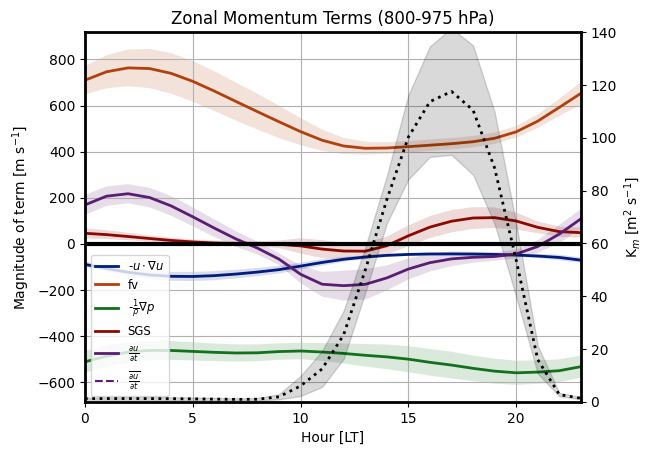

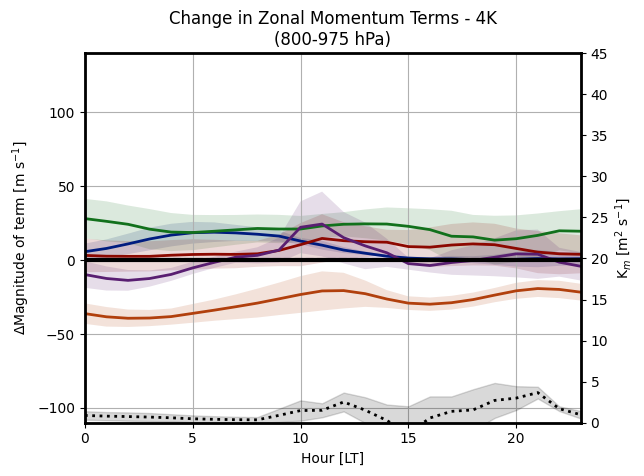

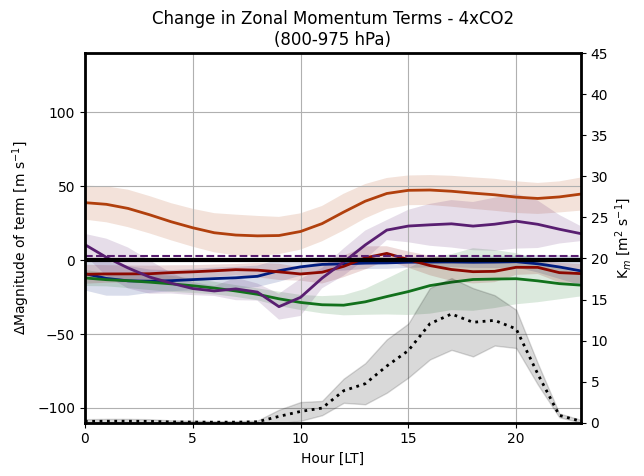

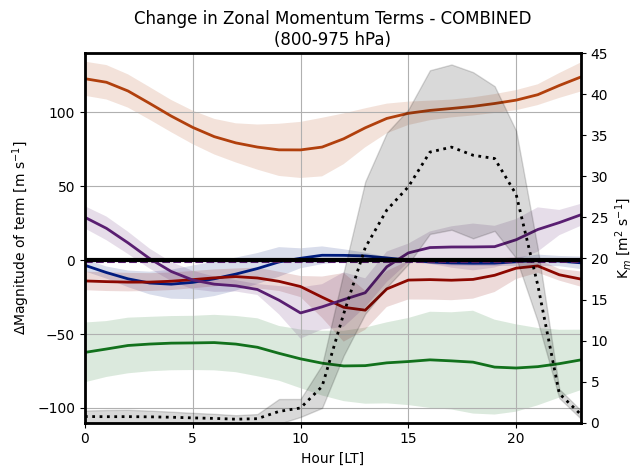

In [14]:
def diurnal_zonal_terms(magnitude):
    """
    Magnitude of momentum terms
    """
    fig, ax = plt.subplots()
    renamed = dict(
        I = r'-$u \cdot \nabla u$',
        II = 'fv',
        III = r'-$\frac{1}{\rho}\nabla p$',
        IV = 'SGS',
    )
    sel = dict(
        forcing='REF',
    )
    for term in ['I', 'II', 'III', 'IV']:
        da = magnitude.sel(sel)[term]
        mean, ci_lower, ci_upper = mean_95(da, 'plev')
        mean.plot(
            ax=ax, x='hour', lw=2,
            label=renamed[term]
        )
        ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    residual = magnitude.sel(sel).residual
    mean, ci_lower, ci_upper = mean_95(residual, 'plev')
    mean.plot(
            ax=ax, x='hour', lw=2,
            label=r'$\frac{\partial u}{\partial t}$',
        )
    ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    # Mean residual (aka error)
    mean_residual = np.mean(residual.values)
    ax.axhline(
        mean_residual, 0, 23, label=r'$\overline{\frac{\partial u}{\partial t}}$',
        c=list(sns.color_palette('dark'))[4], linestyle='dashed')
    # Km on seperate axis
    ax2 = ax.twinx()
    Km = magnitude.sel(sel).Km
    mean, ci_lower, ci_upper = mean_95(Km, 'plev')
    mean.plot(
            ax=ax2, x='hour', lw=2, color='k', linestyle='dotted'
        )
    ax2.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15, color='k'
        )
    # Cosmetics
    ax2.set_title('')
    ax2.set_ylim(0, 140)
    ax2.set_ylabel(r'K$_m$ [m$^2$ s$^{-1}$]')
    ax.legend(fontsize='small', loc='lower left')
    big_ax(ax)
    ax.grid()
    ax.set_xlim(0, 23)
    ax.axhline(0, 0, 23, lw=3, color='k')
    ax.set_ylabel(r'Magnitude of term [m s$^{-1}$]')
    ax.set_xlabel(r'Hour [LT]')
    ax.set_title(f'Zonal Momentum Terms (800-975 hPa)')
    plt.show()
    
def diurnal_zonal_changed_terms(magnitude, forcing):
    """
    Change in magnitude of momentum terms
    """
    fig, ax = plt.subplots()
    difference = magnitude.sel(forcing=forcing)-magnitude.sel(forcing='REF')
    for term in ['I', 'II', 'III', 'IV']:
        da = difference[term]
        mean, ci_lower, ci_upper = mean_95(da, 'plev')
        mean.plot(
            ax=ax, x='hour', lw=2,
        )
        ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    residual = difference.residual
    mean, ci_lower, ci_upper = mean_95(residual, 'plev')
    mean.plot(ax=ax, x='hour', lw=2)
    ax.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15,
        )
    # Mean residual (aka error)
    mean_residual = np.mean(residual.values)
    ax.axhline(
        mean_residual, 0, 23,
        c=list(sns.color_palette('dark'))[4], linestyle='dashed')
    # Km on seperate axis
    ax2 = ax.twinx()
    Km = difference.Km
    mean, ci_lower, ci_upper = mean_95(Km, 'plev')
    mean.plot(
            ax=ax2, x='hour', lw=2, color='k', linestyle='dotted'
        )
    ax2.fill_between(
            mean.hour, ci_lower.values, ci_upper.values, alpha=0.15, color='k'
        )
    # Cosmetics
    ax2.set_title('')
    ax2.set_ylim(0, 45)
    ax.set_ylim(-110, 140)
    ax2.set_ylabel(r'K$_m$ [m$^2$ s$^{-1}$]')
    # ax.legend(fontsize='small')
    big_ax(ax)
    ax.grid()
    ax.set_xlim(0, 23)
    ax.axhline(0, 0, 23, lw=3, color='k')
    ax.set_ylabel(r'$\Delta$Magnitude of term [m s$^{-1}$]')
    ax.set_xlabel(r'Hour [LT]')
    ax.set_title(f'Change in Zonal Momentum Terms - {forcing}\n(800-975 hPa)')
    plt.show()

# Momentum terms
diurnal_zonal_terms(zonal_mag)
diurnal_zonal_changed_terms(zonal_mag, '4K')
diurnal_zonal_changed_terms(zonal_mag, '4xCO2')
diurnal_zonal_changed_terms(zonal_mag, 'COMBINED')

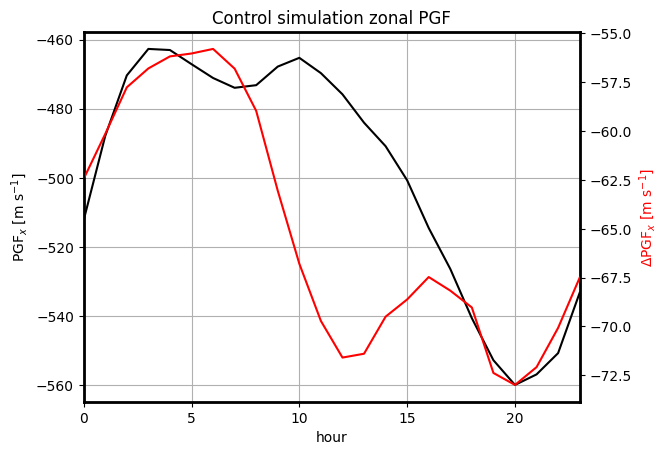

In [22]:
# Zonal PGF force
fig, ax = plt.subplots()
zonal_mag.sel(forcing='REF').mean('plev').III.plot(ax=ax, color='k')
pgf_change = (zonal_mag.mean('plev').III-zonal_mag.sel(forcing='REF').mean('plev').III)\
    .sel(forcing='COMBINED')
ax2 = ax.twinx()
pgf_change.plot(ax=ax2, color='r')
ax.set_ylabel(r'PGF$_x$ [m s$^{-1}$]')
ax2.set_ylabel(r'$\Delta$PGF$_x$ [m s$^{-1}$]', color='r')
ax2.set_title('')
ax.set_title('Control simulation zonal PGF')
ax.set_xlim(0, 23)
big_ax(ax)
ax.grid()
plt.show()

# Change in combined scenario
# pgf_change = pgf_change - pgf_change.mean('hour')
# fig, ax = plt.subplots()
# pgf_change.plot(ax=ax, hue='forcing')
# ax.set_title('Change in zonal PGF in COMBINED run')
# ax.set_xlim(0, 23)
# big_ax(ax)
# ax.grid()
# plt.show()

#### Temperatures

In [181]:
T = season_diurnal_cycle(spatial_mean(ds_vars.T.sel(plev=slice(800*100, 975*100)).mean('plev'))).squeeze()
Tdx = season_diurnal_cycle(ds_vars.T.sel(plev=slice(800*100, 975*100)).mean('plev').differentiate('lon')).squeeze().mean('hour')
T

<xarray.DataArray 'T' (forcing: 4, hour: 24)> Size: 768B
array([[301.04310071, 300.72577744, 300.42284336, 300.14230918,
        299.8913998 , 299.66762121, 299.46566036, 299.28275898,
        299.12275332, 299.01966761, 299.03125247, 299.19247009,
        299.50364626, 299.9538165 , 300.50702202, 301.09646227,
        301.64888061, 302.09396746, 302.3714645 , 302.45416686,
        302.33966986, 302.08323582, 301.77124237, 301.44845865],
       [298.13323685, 297.78913058, 297.45995736, 297.15593296,
        296.88398792, 296.64173508, 296.42398623, 296.22283261,
        296.04666141, 295.93731903, 295.95728616, 296.14013266,
        296.48245031, 296.95779574, 297.53012373, 298.12688333,
        298.67612032, 299.1106962 , 299.38734209, 299.483647  ,
        299.39164813, 299.14740991, 298.82887637, 298.49361011],
       [302.75010738, 302.3663566 , 301.99941819, 301.66303114,
        301.36396662, 301.1022258 , 300.87270534, 300.667858  ,
        300.49438893, 300.39399138, 300.43095433, 300.63692161,
        301.01357019, 301.54749912, 302.17756003, 302.82540655,
        303.4202727 , 303.89508061, 304.20175412, 304.30850179,
        304.20450467, 303.92687816, 303.56171822, 303.1804134 ],
       [296.57739062, 296.26209389, 295.95988393, 295.67896496,
        295.42363742, 295.19514145, 294.98784861, 294.79678725,
        294.62770424, 294.51430787, 294.51790449, 294.67864418,
        294.99607397, 295.44915589, 295.99760868, 296.56435615,
        297.08174579, 297.49132805, 297.74961248, 297.8258065 ,
        297.72393091, 297.48610896, 297.19240905, 296.88570295]])
Coordinates:
  * forcing  (forcing) object 32B '4K' '4xCO2' 'COMBINED' 'REF'
    season   <U3 12B 'JJA'
  * hour     (hour) int64 192B 0 1 2 3 4 5 6 7 8 ... 15 16 17 18 19 20 21 22 23

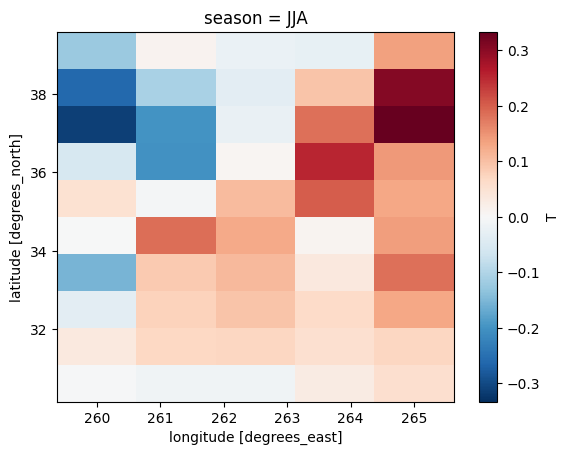

In [182]:
(Tdx.sel(forcing='COMBINED')-Tdx.sel(forcing='REF')).plot()

In [175]:
T.plot(hue='forcing')

ValueError: Only 1d and 2d plots are supported for facets in xarray. See the package `Seaborn` for more options.

#### Vertical transport

In [329]:
omegav_magnitude = season_diurnal_cycle(spatial_mean(ds_vars.OMEGAV)).squeeze()
omega_magnitude = season_diurnal_cycle(spatial_mean(ds_vars.OMEGA))

In [15]:
def plot_omegav_ref(omegav):
    omegav_ = omegav.sel(forcing='REF')
    # Plot
    fig, ax = plt.subplots()
    omegav_.sel(hour=3).plot(
        ax=ax, label=r'0300LT', 
        y='plev', lw=2, color='k', linestyle='dashed'
    )
    omegav_.mean('hour').plot(
        ax=ax, label=r'1200 LT', y='plev',
        lw=2, color='k'
    )
    omegav_.sel(hour=18).plot(
        ax=ax, label=r'1800 LT', y='plev', 
        linestyle='dotted', lw=2, color='k'
    )
    big_ax(ax)
    ax.set_ylim(1000*100, 700*100)
    ax.legend()
    big_ax(ax)
    ax.grid()
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700,])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'$\omega v$ [m Pa s$^{-1}$]')
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_title('Vertical flux of meridional momentum')
    plt.show()

def plot_omegav_diff(omegav, forcing):
    omegav_ = omegav.sel(forcing=forcing) - omegav.sel(forcing='REF')
    fig, ax = plt.subplots()
    omegav_.sel(hour=3).plot(
        ax=ax, label=r'0300 LT', 
        y='plev', linestyle='dashed', lw=2, color='k'
    )
    omegav_.mean('hour').plot(
        ax=ax, label=r'1200 LT', y='plev',
        lw=2, color='k'
    )
    omegav_.sel(hour=18).plot(
        ax=ax, label=r'1800 LT', y='plev', 
        linestyle='dotted', lw=2, color='k'
    )
    big_ax(ax)
    ax.set_ylim(1000*100, 700*100)
    ax.legend()
    big_ax(ax)
    ax.grid()
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700,])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'$\Delta \omega v$ [m Pa s$^{-1}$]')
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_title(f'Vertical flux of meridional momentum - {forcing}')
    plt.show()
    
plot_omegav_ref(omegav_magnitude)
plot_omegav_diff(omegav_magnitude, '4K')
plot_omegav_diff(omegav_magnitude, '4xCO2')
plot_omegav_diff(omegav_magnitude, 'COMBINED')

NameError: name 'omegav_magnitude' is not defined

#### Eddy vertical transport
Calculate $\overline{\omega' v'}$ on a daily cycle

In [316]:
omega_prime = omega_magnitude - omega_magnitude.mean('hour')
v_prime = v_magnitude - v_magnitude.mean('hour')
omegav_prime = (omega_prime * v_prime).squeeze()

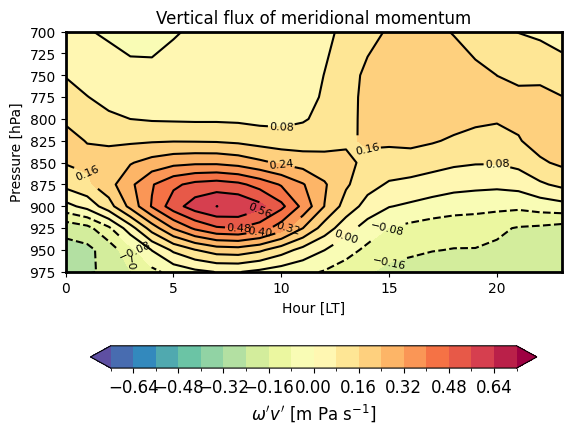

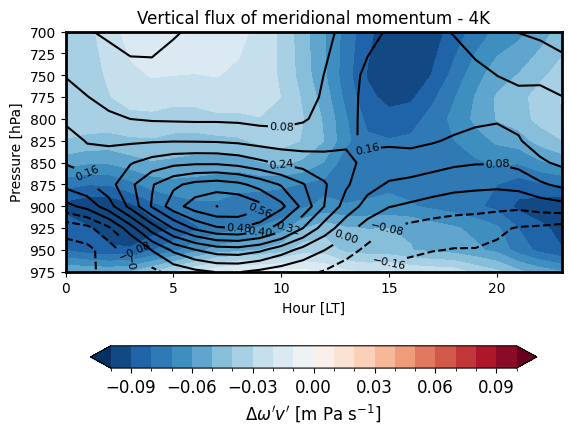

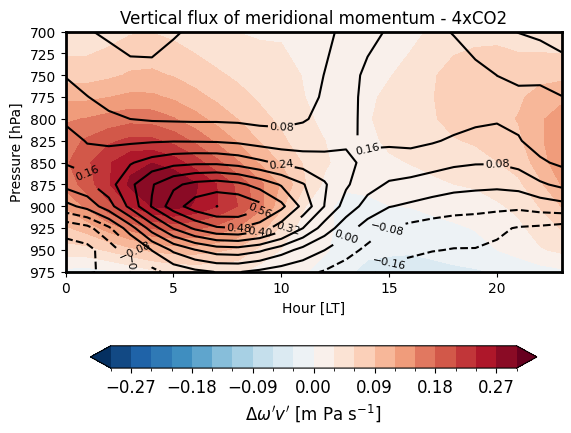

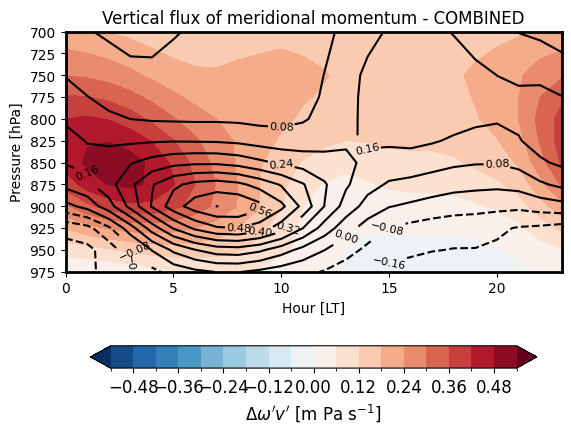

In [331]:
def plot_omegav_prime_ref(omegav):
    omegav_ = omegav.sel(forcing='REF')
    # Plot
    fig, ax = plt.subplots()
    c = omegav_.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral_r', as_cmap=True),
        extend='both',
    )
    contours = omegav_.plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r"$\omega' v'$ [m Pa s$^{-1}$]", fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700,])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel('Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_title('Vertical flux of meridional momentum')
    plt.show()

def plot_omegav_prime_diff(omegav, forcing):
    omegav_ = omegav.sel(forcing=forcing) - omegav.sel(forcing='REF')
    fig, ax = plt.subplots()
    c = omegav_.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap='RdBu_r',
        extend='both',
    )
    contours = omegav.sel(forcing='REF').plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r"$\Delta \omega' v'$ [m Pa s$^{-1}$]", fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700,])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel('Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_title(f'Vertical flux of meridional momentum - {forcing}')
    plt.show()

plot_omegav_prime_ref(omegav_magnitude)
plot_omegav_prime_diff(omegav_magnitude, '4K')
plot_omegav_prime_diff(omegav_magnitude, '4xCO2')
plot_omegav_prime_diff(omegav_magnitude, 'COMBINED')

#### Individual components

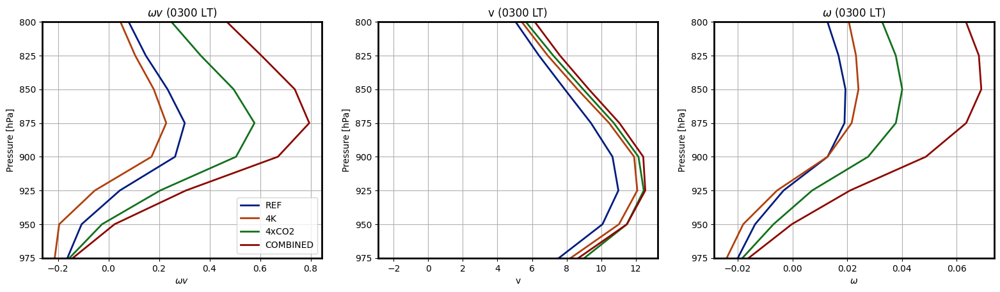

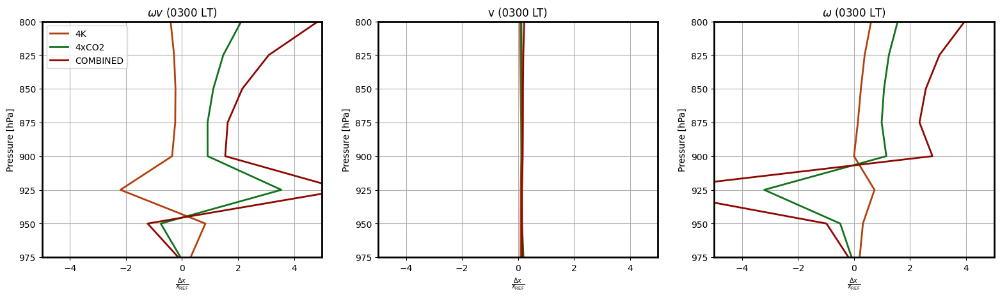

In [152]:
def plot_omegav_ref_comp(omegav, v, omega):
    # Plot
    fig, axes = plt.subplots(ncols=3, nrows=1, figsize=(6.4*3, 4.8))
    for ax_cnt, (var, label) in enumerate(zip([omegav, v, omega], [r'$\omega v$', 'v', r'$\omega$'])):
        ax = axes[ax_cnt]
        for c, forcing in zip(sns.color_palette('dark'), ['REF', '4K', '4xCO2', 'COMBINED']):
            var.sel(hour=3, forcing=forcing).plot(
                ax=ax, label=forcing, 
                y='plev', lw=2, color=c
            )
        ax.set_title(f'{label} (0300 LT)')
        ax.set_xlabel(label)
    axes[0].legend()
    for ax in axes:
        big_ax(ax)
        ax.grid()
        ax.set_ylim([975*100, 800*100])
        ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
        ax.set_yticks(ticks*100)
        ax.set_yticklabels(ticks)
        ax.set_ylabel(r'Pressure [hPa]')
    plt.show()

def plot_omegav_ref_comp_ratio(omegav, v, omega):
    # Plot
    fig, axes = plt.subplots(ncols=3, nrows=1, figsize=(6.4*3, 4.8))
    for ax_cnt, (var, label) in enumerate(zip([omegav, v, omega], [r'$\omega v$', 'v', r'$\omega$'])):
        ax = axes[ax_cnt]
        r = var.sel(hour=3, forcing='REF')
        for c, forcing in zip(sns.color_palette('dark')[1:], ['4K', '4xCO2', 'COMBINED']):
            p = var.sel(hour=3, forcing=forcing)
            ((p-r)/r).plot(
                ax=ax, label=forcing, 
                y='plev', lw=2, color=c
            )
        ax.set_title(f'{label} (0300 LT)')
    axes[0].legend()
    for ax in axes:
        big_ax(ax)
        ax.grid()
        ax.set_ylim([975*100, 800*100])
        ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
        ax.set_yticks(ticks*100)
        ax.set_yticklabels(ticks)
        ax.set_ylabel(r'Pressure [hPa]')
        ax.set_xlabel(r'$\frac{\Delta x}{x_{\text{REF}}}$')
        ax.set_xlim(-5, 5)
    plt.show()
plot_omegav_ref_comp(omegav_magnitude, v_magnitude, omega_magnitude)
plot_omegav_ref_comp_ratio(omegav_magnitude, v_magnitude, omega_magnitude)

#### Hydrostatic balance

Changes due to $\omega \equiv \frac{\partial p}{\partial t}$ but we have $\frac{\partial p}{\partial z}=-\rho g$

Plot geopotential height contours in pressure coordinates as a proxy for pressure in height coordinates.

In [267]:
z3 = season_diurnal_cycle(spatial_mean(ds_vars.Z3)).squeeze()
T = season_diurnal_cycle(spatial_mean(ds_vars.T)).squeeze()
vpwp = season_diurnal_cycle(spatial_mean(ds_vars.VPWP_CLUBB)).squeeze()

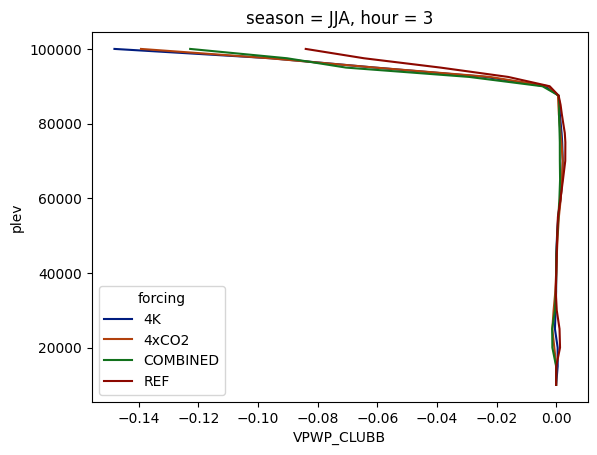

In [271]:
vpwp.sel(hour=3).plot(hue='forcing', y='plev')

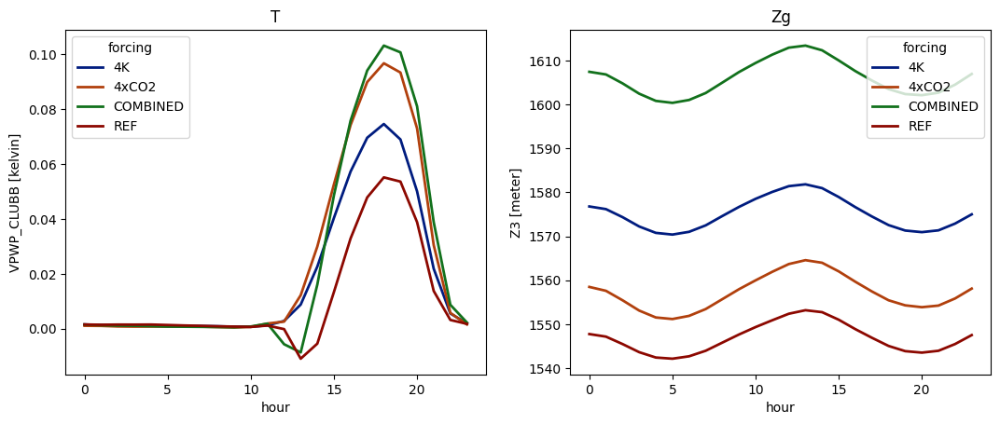

In [265]:
plev = 850

fig, axes = plt.subplots(ncols=2, figsize=(6.4*2, 4.8))
# T change
T_ = T.sel(plev=plev*100) * units('K')
# T_ = T_ - T_.sel(forcing='REF')
# T_ = T_ - T_.mean('hour')
T_.plot(
    ax=axes[0], hue='forcing', lw=2
)
axes[0].set_title('T')
# Zg change
Zg_ = z3.sel(plev=plev*100) * units('m')
# Zg_ = Zg_ - Zg_.sel(forcing='REF')
# Zg_ = Zg_ - Zg_.mean('hour')
Zg_.plot(
    ax=axes[1], hue='forcing', lw=2,
)
axes[1].set_title('Zg')
plt.show()

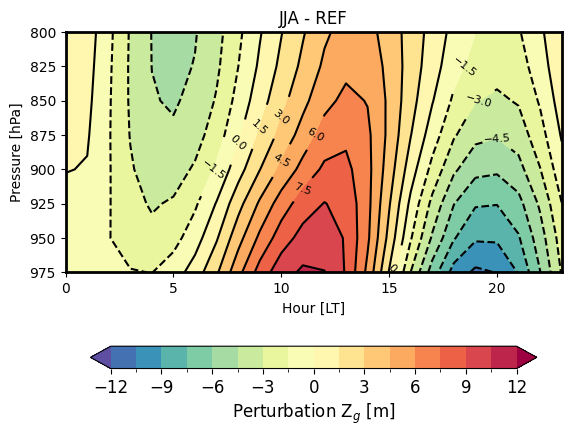

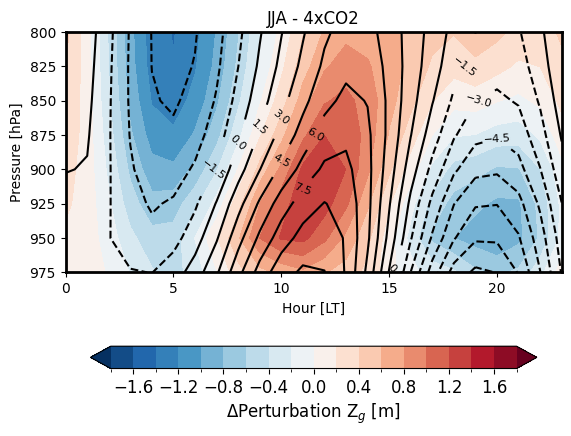

In [224]:
def plot_z3_ref(z3):
    z3_ = z3.sel(forcing='REF')
    daily_diff = z3_-z3_.mean('hour')
    fig, ax = plt.subplots()
    c = daily_diff.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral_r', as_cmap=True),
        extend='both',
    )
    contours = daily_diff.plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r'Perturbation Z$_g$ [m]', fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')
    ax.set_title('JJA - REF')
    plt.show()

def plot_z3_change(z3, forcing):
    daily_diff = z3-z3.mean('hour')
    forcing_diff = daily_diff.sel(forcing=forcing) - daily_diff.sel(forcing='REF')
    fig, ax = plt.subplots()
    c = forcing_diff.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap='RdBu_r',
        extend='both',
    )
    contours = daily_diff.sel(forcing='REF').plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r'$\Delta$Perturbation Z$_g$ [m]', fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')
    ax.set_title(f'JJA - {forcing}')
    plt.show()
    
plot_z3_ref(z3)
plot_z3_change(z3, '4xCO2')

#### Diabatic heating

$$\frac{d\theta}{dt}$$

THIS IS WRONG, WE DON'T HAVE THE FULL DERIVATIVE

In [299]:
exner_fxn = mpcalc.exner_function(ds_vars.plev * units('Pa')).metpy.dequantify()
theta = season_diurnal_cycle(
    spatial_mean(ds_vars.T / exner_fxn).rename('theta')
).squeeze()
diabatic = mpcalc.first_derivative(theta, axis='hour')

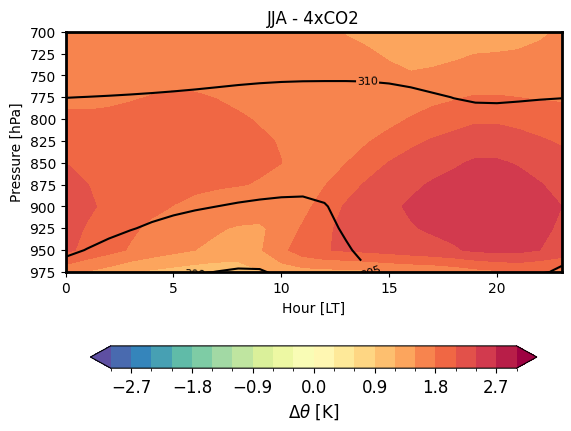

In [302]:
def plot_theta_change(theta, forcing):
    ref = theta.sel(forcing='REF')
    difference = theta.sel(forcing=forcing) - ref
    fig, ax = plt.subplots()
    c = difference.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral_r', as_cmap=True),
        extend='both',
    )
    contours = ref.plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r'$\Delta \theta$ [K]', fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')
    ax.set_title(f'JJA - {forcing}')
    plt.show()
plot_theta_change(theta, forcing='4xCO2')

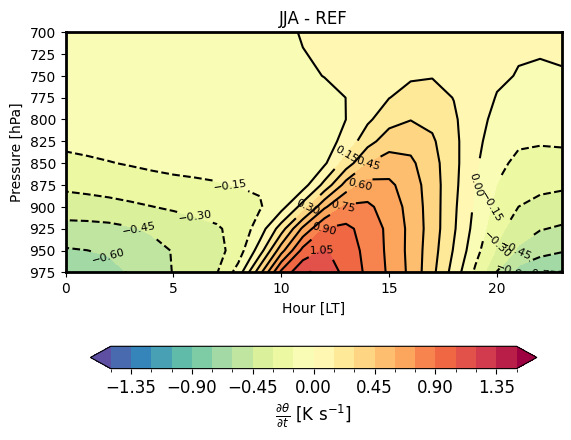

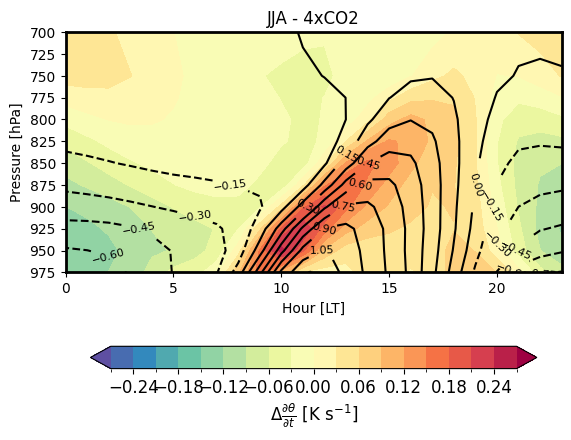

In [306]:
def plot_diabatic_ref(diabatic):
    diabatic_ = diabatic.sel(forcing='REF')
    fig, ax = plt.subplots()
    c = diabatic_.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral_r', as_cmap=True),
        extend='both',
    )
    contours = diabatic_.plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r'$\frac{\partial \theta}{ \partial t}$ [K s$^{-1}$]', fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')
    ax.set_title('JJA - REF')
    plt.show()

def plot_diabatic_change(diabatic, forcing):
    ref = diabatic.sel(forcing='REF')
    difference = diabatic.sel(forcing=forcing) - ref
    fig, ax = plt.subplots()
    c = difference.plot.contourf(
        ax=ax, x='hour',
        # vmin=0, vmax=10000,
        levels=10*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral_r', as_cmap=True),
        extend='both',
    )
    contours = ref.plot.contour(
        ax=ax,x='hour',
        # vmin=-3,
        # vmax=3,
        levels=10*2+1,
        colors='black',
    )
    ax.clabel(contours, fontsize=8, inline_spacing=1)
    cbar = fig.colorbar(
        c, ax=ax,
        shrink=0.9, orientation='horizontal', pad=0.2
    )
    cbar.set_label(r'$\Delta$$\frac{\partial \theta}{\partial t}$ [K s$^{-1}$]', fontsize='large')
    cbar.ax.tick_params(labelsize='large')
    big_ax(ax)
    ax.set_ylim([975*100, 700*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 775, 750, 725, 700])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')
    ax.set_title(f'JJA - {forcing}')
    plt.show()
    
plot_diabatic_ref(diabatic)
plot_diabatic_change(diabatic, '4xCO2')

## Figure - geostrophic winds in LLJ region

### Prep data
Add a 5 degree buffer which should be more than enough.

In [5]:
ds_sel = ds[['V', 'Z3',]]\
    .sel(lat=slice(25, 45), lon=slice(-105+360, -90+360))\
    .sel(plev=slice(800*100, 975*100))
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 13.39 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [6]:
zg = ds_plot.metpy.parse_cf()\
    .metpy.quantify()\
    .Z3
Ug, Vg = mpcalc.geostrophic_wind(zg*mpconst.earth_gravity)
ds_plot['Ug'] = Ug.metpy.dequantify()
ds_plot['Vg'] = Vg.metpy.dequantify()
reduced = season_diurnal_cycle(
    spatial_mean(
        sel_region(
            ds_plot, 'LLJ'
        )
    )
)
reduced

<xarray.Dataset> Size: 99kB
Dimensions:    (forcing: 4, plev: 8, season: 4, hour: 24)
Coordinates:
  * forcing    (forcing) object 32B '4K' '4xCO2' 'COMBINED' 'REF'
  * plev       (plev) int64 64B 80000 82500 85000 87500 90000 92500 95000 97500
    metpy_crs  object 8B Projection: latitude_longitude
  * season     (season) object 32B 'DJF' 'JJA' 'MAM' 'SON'
  * hour       (hour) int64 192B 0 1 2 3 4 5 6 7 8 ... 16 17 18 19 20 21 22 23
Data variables:
    V          (forcing, plev, season, hour) float64 25kB dask.array<chunksize=(1, 8, 1, 24), meta=np.ndarray>
    Z3         (forcing, plev, season, hour) float64 25kB dask.array<chunksize=(1, 8, 1, 24), meta=np.ndarray>
    Ug         (forcing, plev, season, hour) float64 25kB 8.619 ... -0.07312
    Vg         (forcing, plev, season, hour) float64 25kB 0.5413 0.511 ... 1.679

In [7]:
# Large scale effects
difference = reduced - reduced.sel(forcing='REF')
# Diurnal effects
difference_perturb = difference - difference.mean('hour')

### Plot

#### Raw change

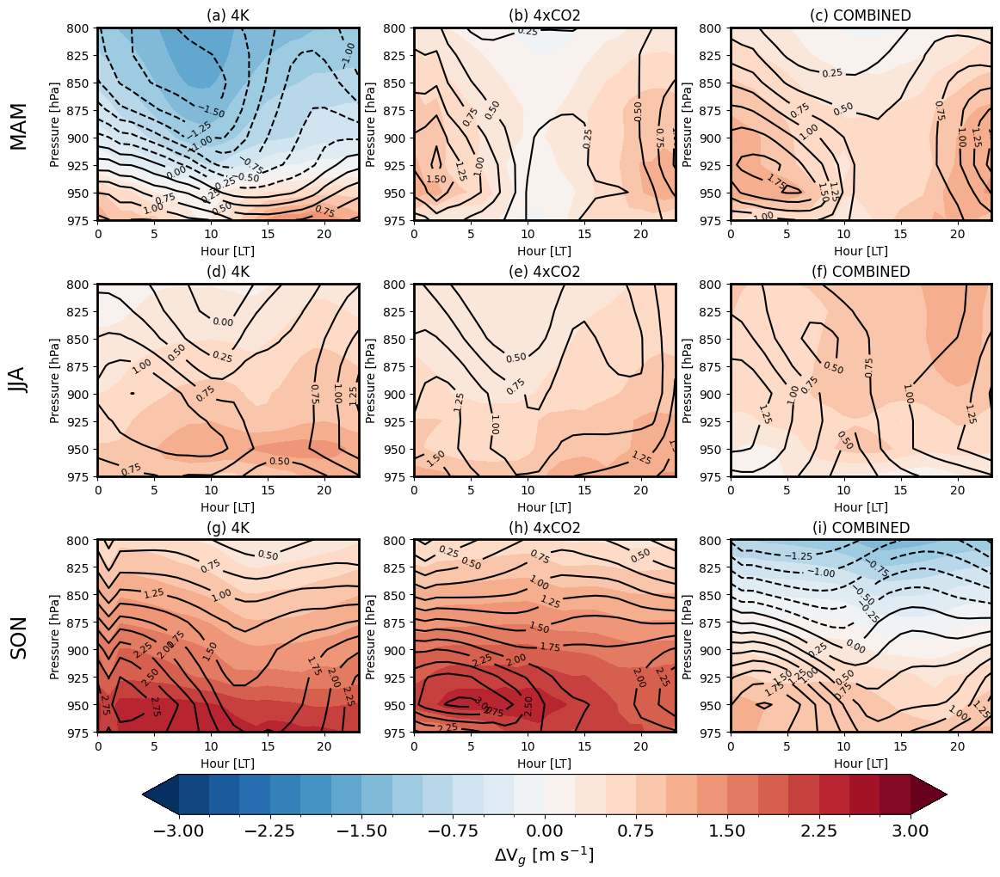

In [8]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = difference.sel(season=season, forcing=forcing)
        c = da.Vg.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-3,
            vmax=3,
            levels=3*8+1,
            add_colorbar=False,
            cmap='RdBu_r',
            extend='both',
        )
        contours = da.V.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-3,
            vmax=3,
            levels=3*8+1,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, fontsize=8, inline_spacing=1)
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$V$_g$ [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Minus daily mean

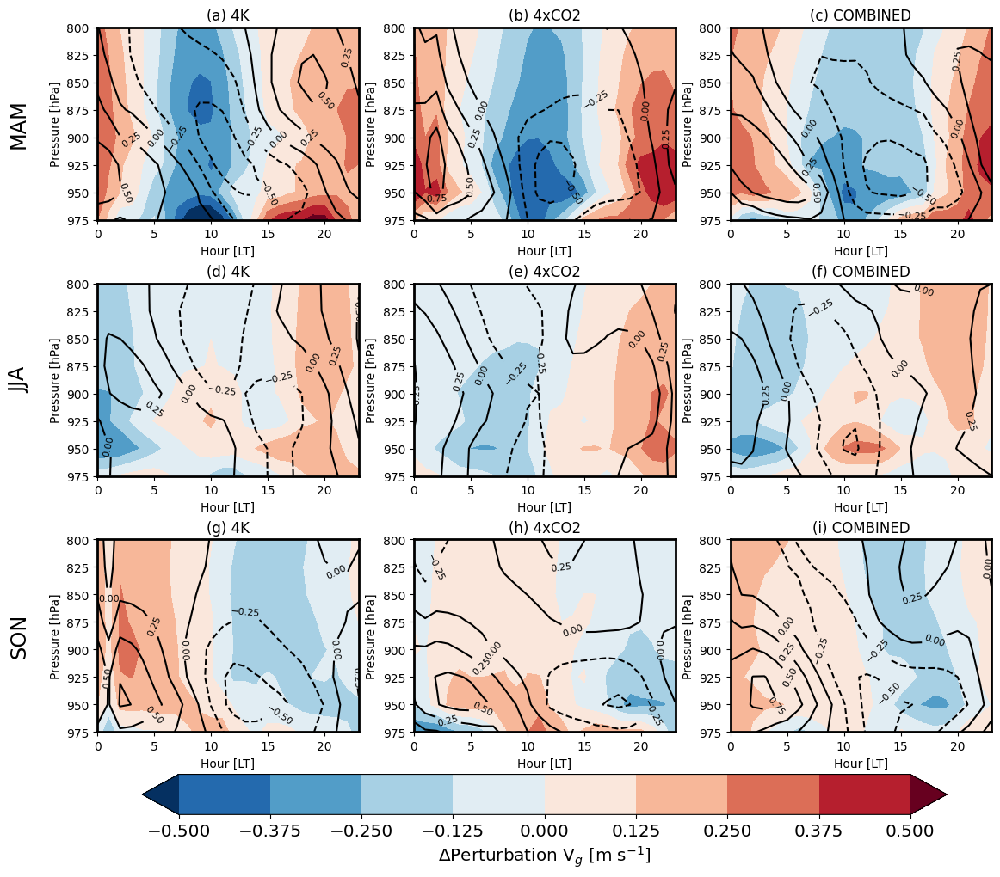

In [13]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = difference_perturb.sel(season=season, forcing=forcing)
        c = da.Vg.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-0.5,
            vmax=0.5,
            levels=1*8+1,
            add_colorbar=False,
            cmap='RdBu_r',
            extend='both',
        )
        contours = da.V.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-2,
            vmax=2,
            levels=2*8+1,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, fontsize=8, inline_spacing=1)
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$Perturbation V$_g$ [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Ratio of Vg to V
$$R=1-\frac{\text{Geostrophic change}}{\text{Total change}}=1-\frac{\Delta V_g}{\Delta V}$$

A value of 0 indicates that the geostrophic change is equal to the geostrophic change. Values >0 indicate the proportion of the wind that is faster. A value of -0.25 would indicate that the wind speed change is 25% less than the geostrophic change.

In [181]:
# What percentage of change is due to Vg
georatio = 1-(difference.Vg/difference.V).compute()

/home/valencig/.local/lib/python3.12/site-packages/dask/_task_spec.py:764: RuntimeWarning: invalid value encountered in divide
  return self.func(*new_argspec)
/home/valencig/.local/lib/python3.12/site-packages/dask/_task_spec.py:764: RuntimeWarning: invalid value encountered in divide
  return self.func(*new_argspec)
/home/valencig/.local/lib/python3.12/site-packages/dask/_task_spec.py:764: RuntimeWarning: invalid value encountered in divide
  return self.func(*new_argspec)
/home/valencig/.local/lib/python3.12/site-packages/dask/_task_spec.py:764: RuntimeWarning: invalid value encountered in divide
  return self.func(*new_argspec)


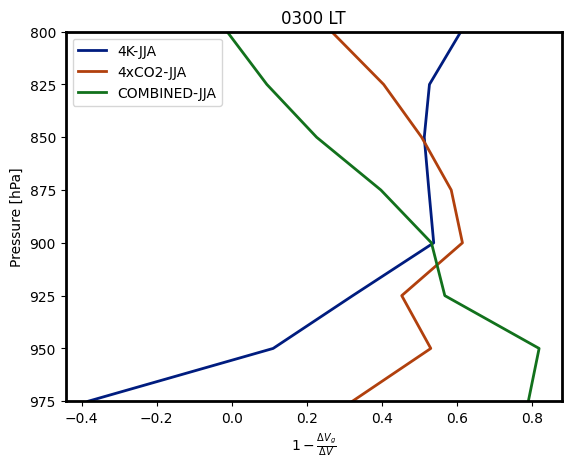

In [189]:
fig, ax = plt.subplots()
for linestyle, season in zip(['dashed', 'solid', 'dotted'], ['MAM', 'JJA', 'SON']):
    if season != 'JJA':
        continue
    for forcing, c in zip(['4K', '4xCO2', 'COMBINED'], sns.color_palette('dark')):
        da = georatio.sel(
            season=season, forcing=forcing, hour=3, plev=slice(800*100, None)
        )
        ax.plot(
            da, da.plev,
            lw=2, color=c, linestyle=linestyle,
            label=f'{forcing}-{season}'
        )
# Test combination
# da_4K = georatio.sel(
#             season='JJA', forcing='4K', hour=3, plev=slice(800*100, None)
#         )
# da_4xCO2 = georatio.sel(
#             season='JJA', forcing='4xCO2', hour=3, plev=slice(800*100, None)
#         )
# foo = da_4K + da_4xCO2
# ax.plot(
#     foo, foo.plev, color='k', lw=2
# )
# Cosmetic options
ax.legend()
big_ax(ax)
ax.set_xlabel(r'$1-\frac{\Delta V_g}{\Delta V}$')
# ax.set_xlim(-1, 1)
ax.set_ylabel('Pressure [hPa]')
ax.set_ylim([975*100, 800*100])
ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_title('0300 LT')
plt.show()

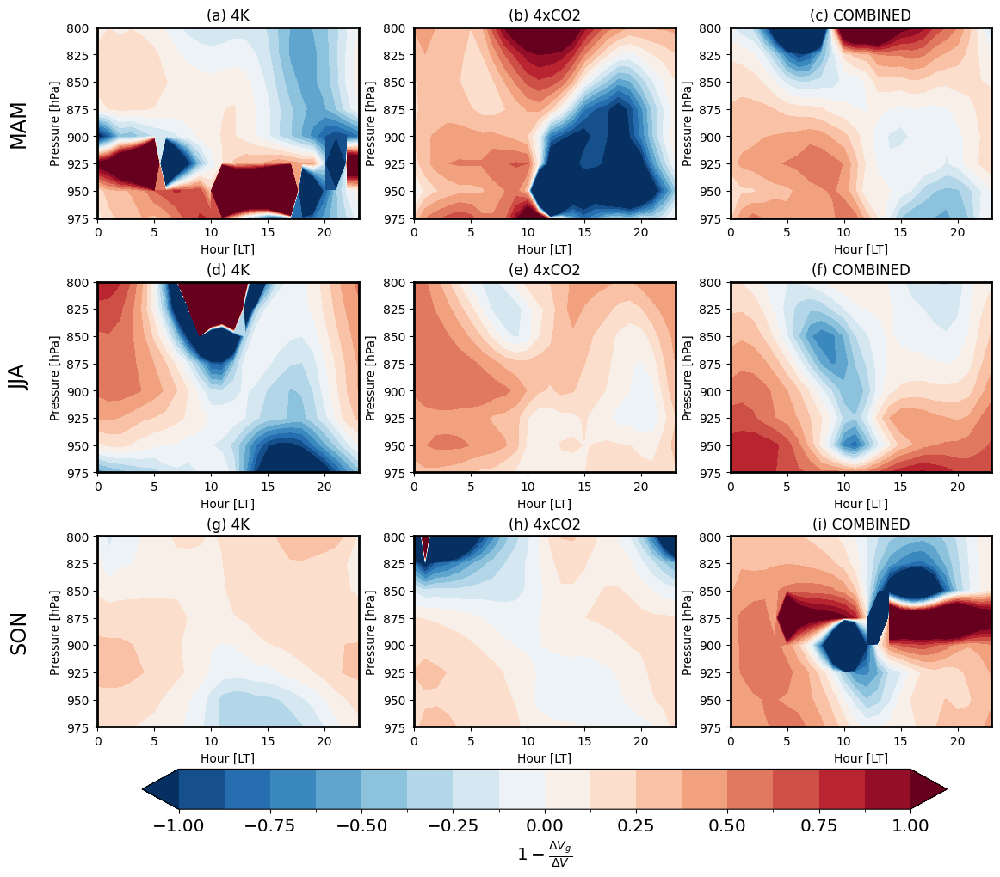

In [157]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = georatio.sel(season=season, forcing=forcing)
        c = da.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-1,
            vmax=1,
            levels=1*16+1,
            add_colorbar=False,
            cmap='RdBu_r',
            extend='both',
        )
        # contours = da.plot.contour(
        #     ax=axes[ax_cnt, f_cnt],
        #     x='hour',
        #     vmin=-300,
        #     vmax=300,
        #     levels=3*8+1,
        #     colors='black',
        # )
        axes[ax_cnt, f_cnt].clabel(contours, fontsize=8, inline_spacing=1)
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$1-\frac{\Delta V_g}{\Delta V}$', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

## Figure - geostrophic winds (OLD)

### Prep data

Full wind field

In [6]:
orog_plev = meridional_mean(sel_region(ds.orog_plev, 'rockies'))
ds_sel = meridional_mean(
    sel_region(ds.V, 'rockies')
    .where(ds['time.hour'] == 3, drop=True) # 0300 LT
    .groupby('time.season').mean()
)
fullwinds = client.persist(ds_sel)
progress(fullwinds)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 10.49 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

Geostrophic winds, need to select a region slightly larger than the rockies so I can have the full gradients. Add a 5 degree buffer which should be more than enough

In [7]:
# Need to keep it as a dataset for parse_cf()
zg = ds[['Z3']].sel(lat=slice(25, 45), lon=slice(-135+360, -65+360))\
    .where(ds['time.hour'] == 3, drop=True)\
    .metpy.parse_cf()\
    .metpy.quantify()\
    .Z3
zg = client.persist(zg)
progress(zg)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 10.48 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [8]:
Ug, Vg = mpcalc.geostrophic_wind(zg*mpconst.earth_gravity)
geowinds = meridional_mean(
    sel_region(
        Vg, 'rockies'
    )
    .groupby('time.season').mean()
).metpy.dequantify()

In [86]:
# Change in full winds
full_perturb = (fullwinds - fullwinds.sel(forcing='REF')).compute()
# Change in geostrophic winds
geo_perturb = (geowinds - geowinds.sel(forcing='REF')).compute()
# How much of full change is geostrophic
georatio = (full_perturb-geo_perturb)/full_perturb * 100

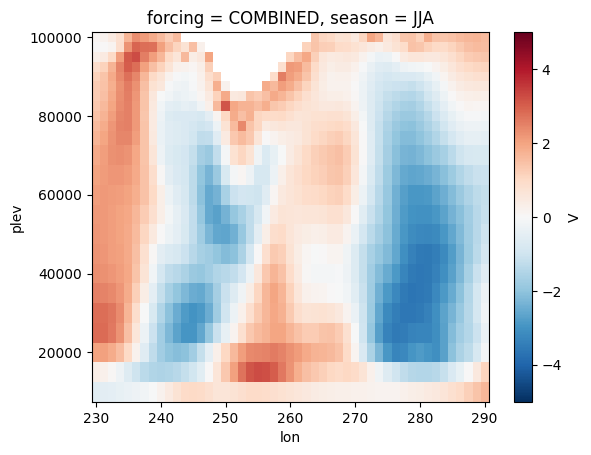

In [72]:
full_perturb.sel(forcing='COMBINED', season='JJA').plot(vmax=5)

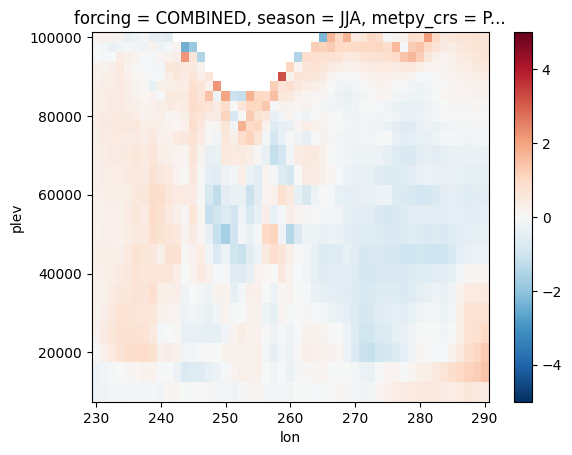

In [73]:
(full_perturb - geo_perturb).sel(forcing='COMBINED', season='JJA').plot(vmax=5)

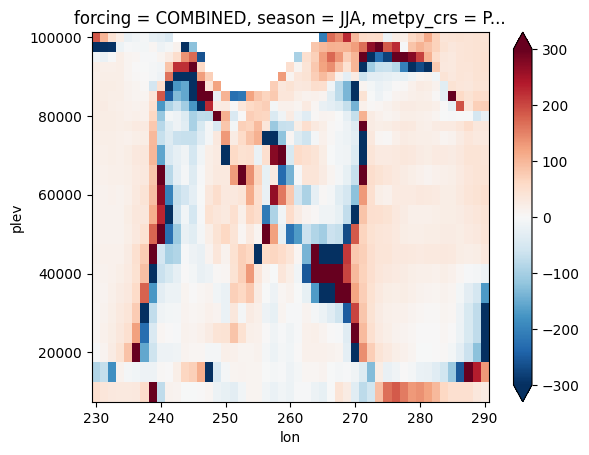

In [88]:
georatio.sel(forcing='COMBINED', season='JJA').plot(vmax=300)

### Plot

#### Geostrophic winds

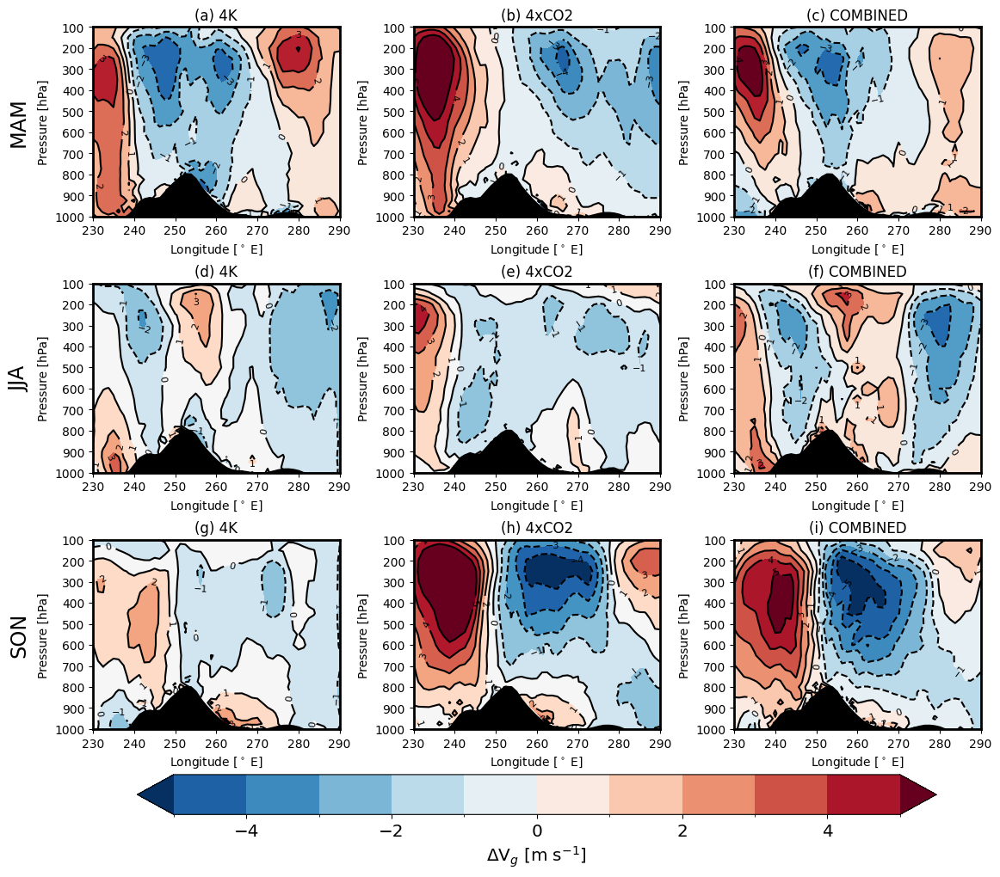

In [27]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    da_ref = geowinds.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = geowinds.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            levels=5*2+1,
            vmax=5,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        contours = difference.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            levels=5*2+1,
            vmax=5,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')        
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$V$_g$ [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Ratio between Vg and V

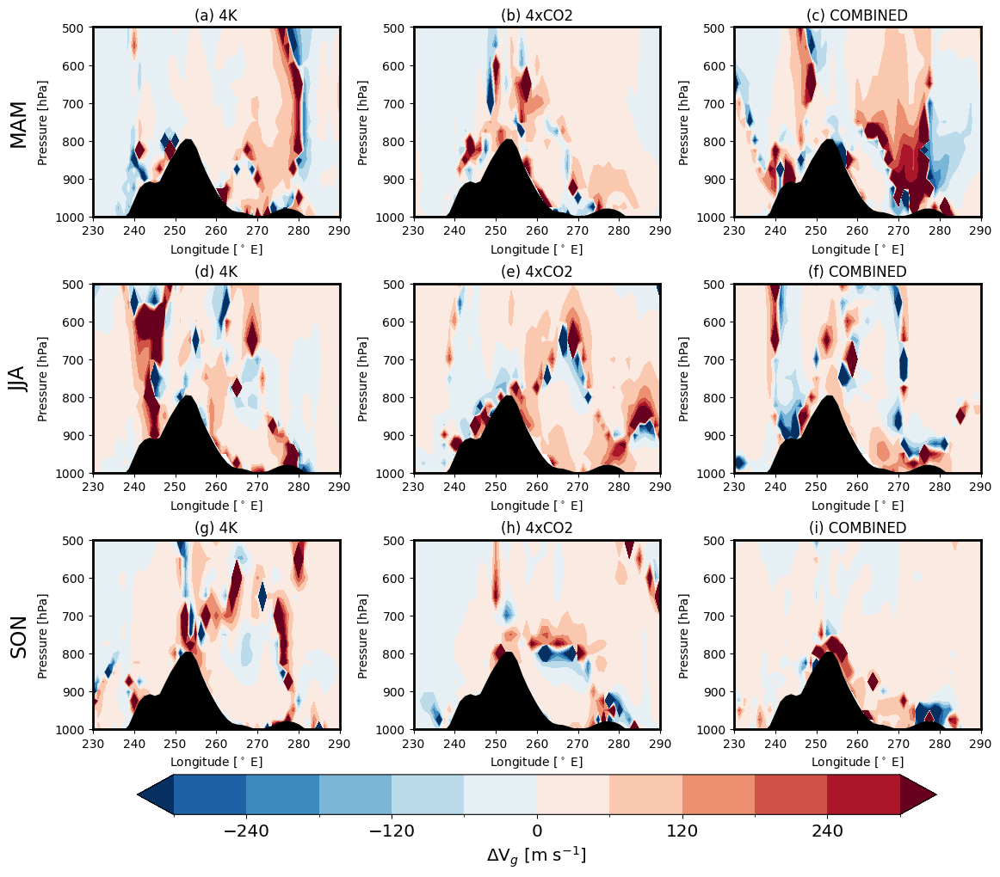

In [57]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = georatio.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            levels=5*2+1,
            vmax=300,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        # contours = difference.plot.contour(
        #     ax=axes[ax_cnt, f_cnt],
        #     levels=5*2+1,
        #     vmax=5,
        #     colors='black',
        # )
        # axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')        
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 500*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500])#, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$V$_g$ [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Difference between Vg and V

NameError: name 'geo' is not defined

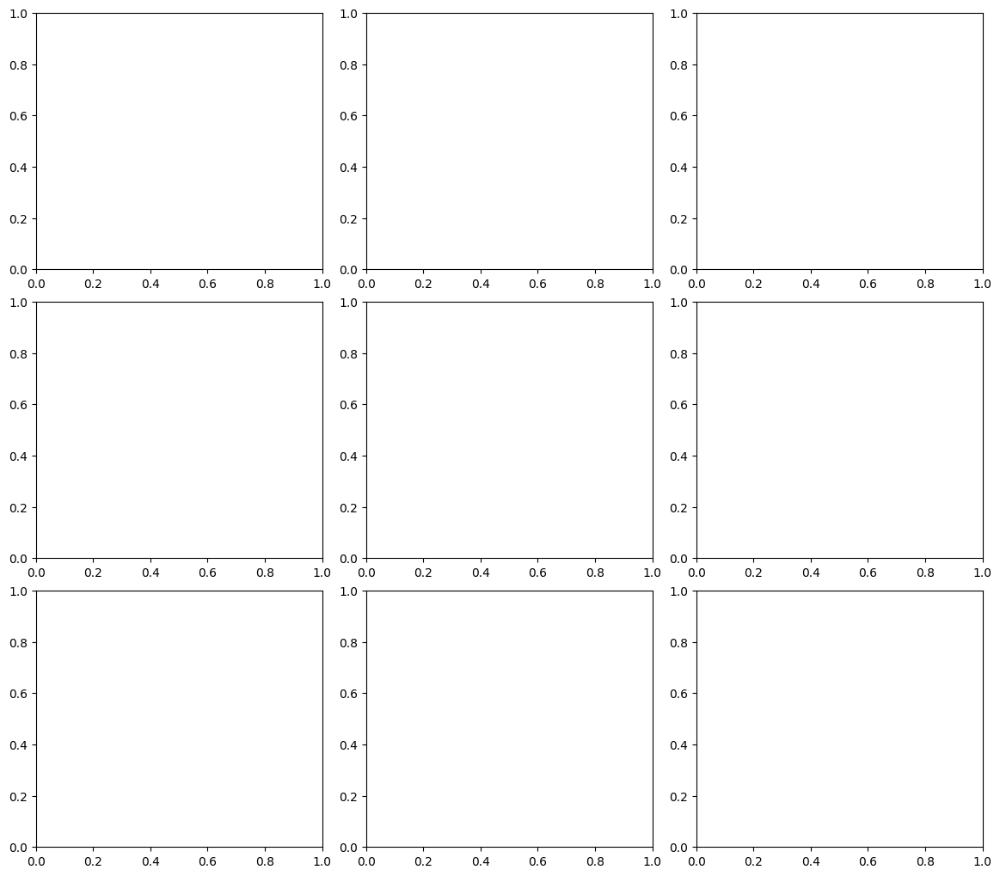

In [39]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    da_ref = change.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = change.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            levels=2*4+1,
            vmax=2,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        contours = difference.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            levels=2*4+1,
            vmax=2,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')        
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$(V$_g$-V) [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

## Figure - change in total jet strength

### Prep data

In [5]:
orog_plev = meridional_mean(sel_region(ds.orog_plev, 'rockies'))
ds_sel = meridional_mean(
    sel_region(ds.V, 'rockies')
    .groupby('time.season').mean()
)
future = client.compute(ds_sel)
progress(future)

VBox()

In [6]:
ds_plot = future.result()

### Plot

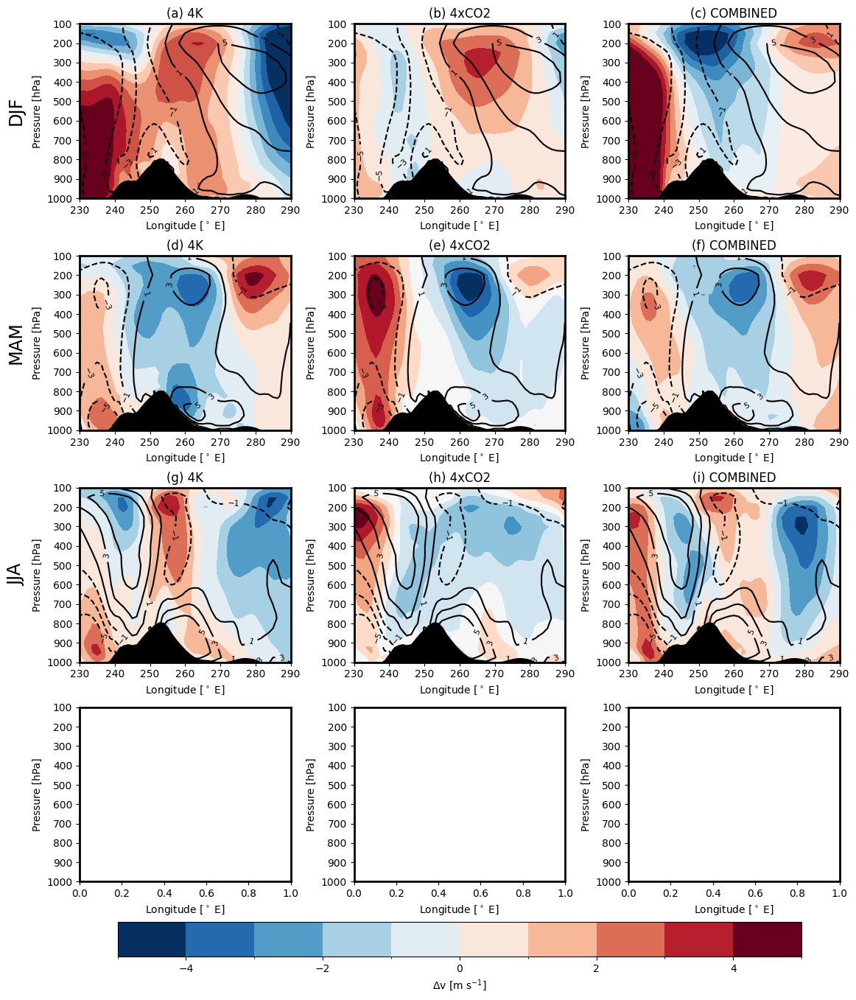

In [8]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)
cbar_kwargs = {'label': r'$\Delta$v [m s$^{-1}$]', 'shrink': 0.9, 'orientation': 'horizontal', 'pad': 0.005}
label_cnt = 0
for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']): ### add SON later
    da_ref = ds_plot.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = ds_plot.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            levels=11,
            vmax=5,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        contours = da_ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            levels=6,
            vmax=5,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')        
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
plt.show()

## Figure - change in diurnal winds

### Prep data

In [24]:
ds_sel = season_diurnal_cycle(
    spatial_mean(
        sel_region(ds.V, 'LLJ')
    )
)
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 10.58 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [25]:
perturb = ds_plot - ds_plot.mean('hour')

### Plot

#### Mean winds

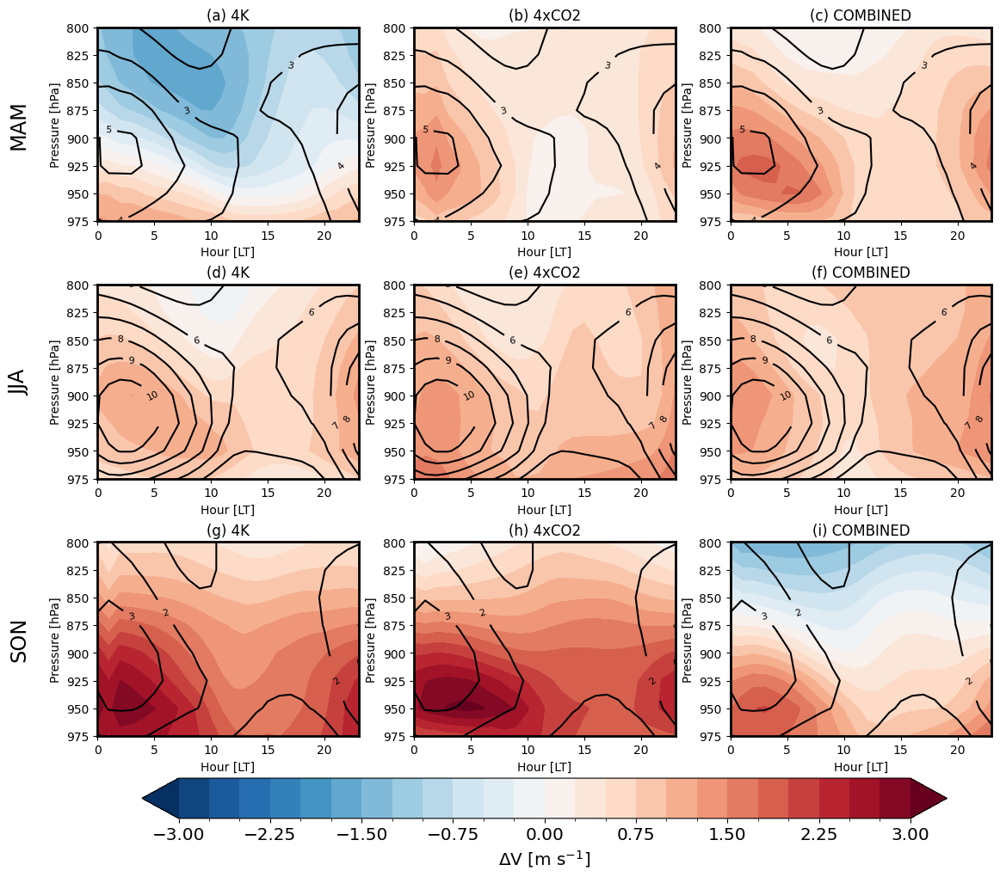

In [30]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']): ### add SON later
    da_ref = ds_plot.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = ds_plot.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-3,
            vmax=3,
            levels=6*4+1,
            add_colorbar=False,
            cmap='RdBu_r',
            extend='both',
        )
        contours = da_ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=0,
            vmax=12,
            levels=12*1+1,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])#, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$V [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Daily perturbation

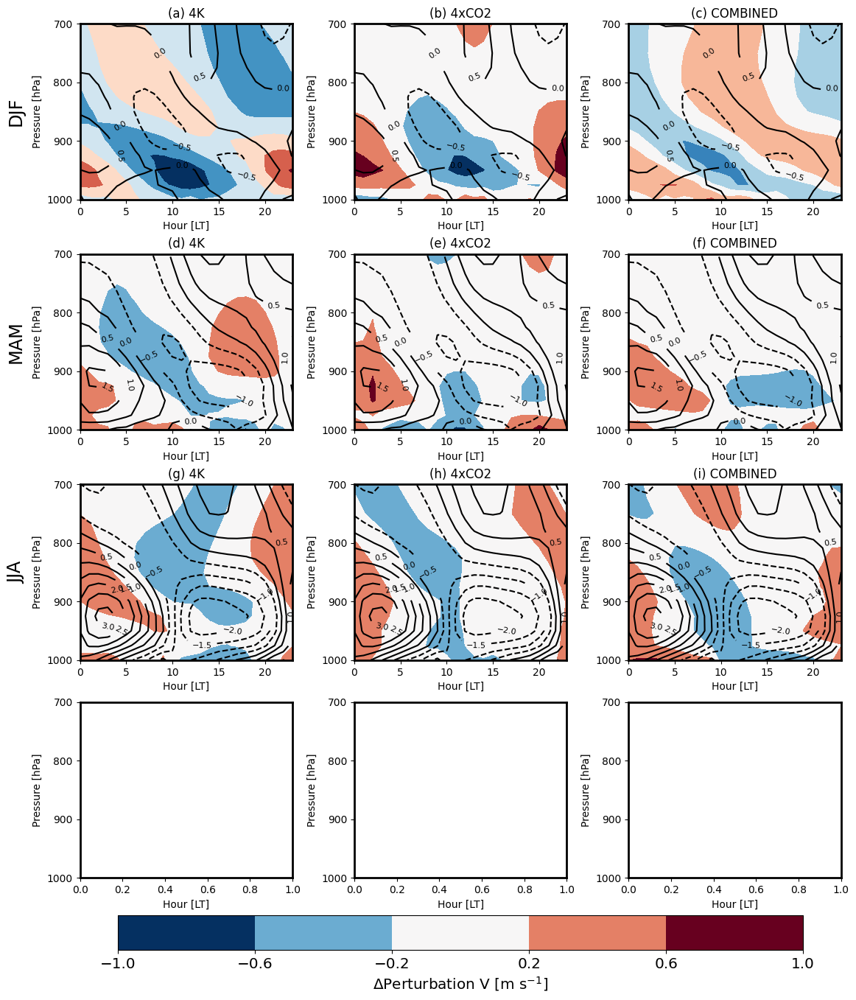

In [123]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)
cbar_kwargs = {'label': r'$\Delta$ pertubation v [m s$^{-1}$]', 'shrink': 0.9, 'orientation': 'horizontal', 'pad': 0.005}
label_cnt = 0
for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']): ### add SON later
    da_ref = perturb.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = perturb.sel(season=season, forcing=forcing)
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            levels=1*5+1,
            vmax=1,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        contours = da_ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmax=4,
            levels=17,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 700*100])
    ticks = np.array([1000, 900, 800, 700])#, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$Perturbation V [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

## Figure - change in coriolis inertial oscillation

### Prep data

In [ ]:
ds_sel = ds[['U',]]\
    .sel(plev=slice(800*100, None))\
    .where(llj_mask, drop=True)
future = client.compute(ds_sel)
progress(future)

In [14]:
ds_llj = future.result()
II = (-mpcalc.coriolis_parameter(ds_llj.lat) * ds_llj.U.metpy.quantify()).rename('II') * 10e5 * units('s')
# Now get hourly/seasonal cycle
by_hour = llj_region_mean(
    season_diurnal_cycle(II)
)
# Get perturbation
daily_deviation = by_hour - by_hour.mean('hour')

### Plot

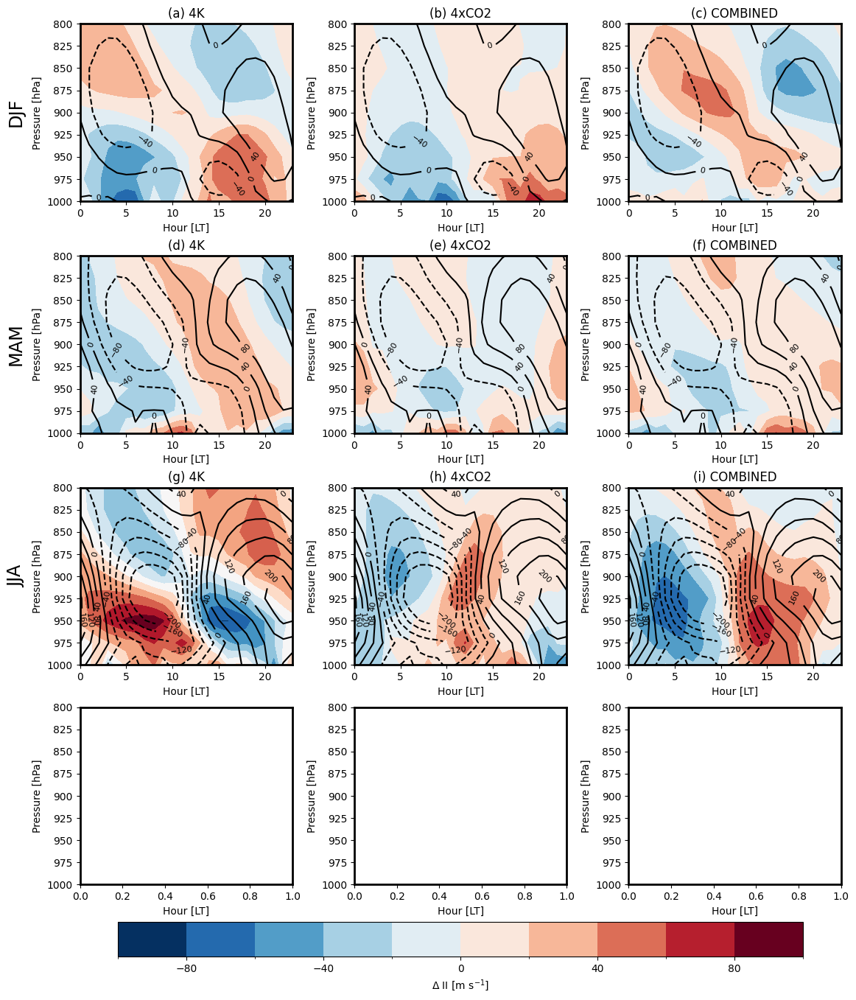

In [22]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)
cbar_kwargs = {'label': r'$\Delta$ II [m s$^{-1}$]', 'shrink': 0.9, 'orientation': 'horizontal', 'pad': 0.005}
label_cnt = 0
for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']): ### add SON later
    da_ref = daily_deviation.sel(season=season, forcing='REF').II
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = daily_deviation.sel(season=season, forcing=forcing).II
        difference = da - da_ref
        c = difference.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            levels=11,
            vmax=100,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        contours = da_ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            levels=11,
            vmax=200,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 800*100])
    ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Hour [LT]')
    ax.set_ylabel(r'Pressure [hPa]')

fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
plt.show()

In [ ]:
del ds_llj
gc.collect()

## Figure - change in pressure gradient force

### Prep data

Pad region for derivative

In [31]:
ds_sel = ds.Z3.sel(lat=slice(25, 45), lon=slice(-105+360, -90+360))\
    .sel(plev=slice(800*100, 975*100))
z3 = client.persist(ds_sel)
progress(z3)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 10.56 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [32]:
pgf = -mpcalc.first_derivative(z3.metpy.quantify() * mpconst.earth_gravity, axis='lat').rename('III') * 10e5 * units('s')
# Now get hourly/seasonal cycle
by_hour = season_diurnal_cycle(
    spatial_mean(
        sel_region(pgf, 'LLJ')
    )
).compute()

### Plot
Left plot is daily mean value, other three are perturbations.

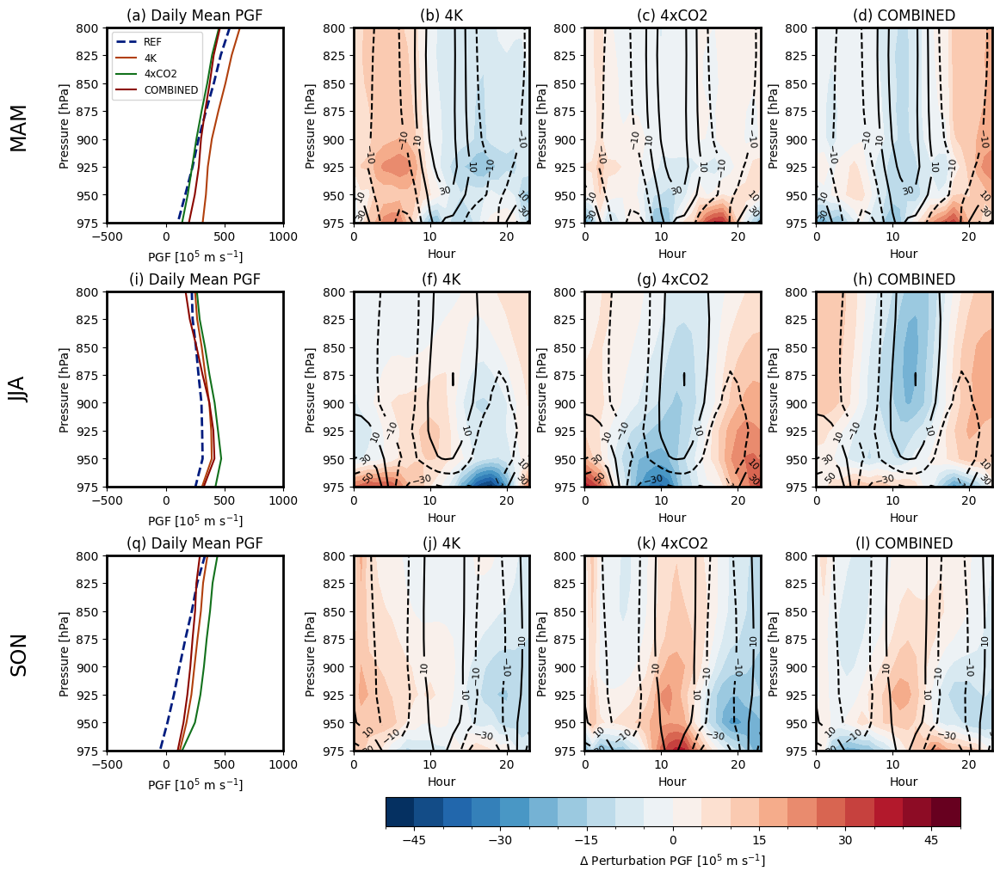

In [38]:
fig, axes = plt.subplots(
    ncols=4, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)
cbar_kwargs = {'label': r'$\Delta$ Perturbation PGF [10$^5$ m s$^{-1}$]', 'shrink': 0.9, 'orientation': 'horizontal', 'pad': 0.005}

label_cnt = 0

for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    da_season = by_hour.sel(season=season)
    daily_mean = da_season.mean('hour')
    # Plot 1: mean daily terms (plot manually to make it look nicer)
    daily_mean.sel(forcing='REF').plot(
        ax=axes[ax_cnt, 0],
        y='plev', label='REF', linestyle='dashed', lw=2,
    )
    daily_mean.sel(forcing='4K').plot(
        ax=axes[ax_cnt, 0],
        y='plev', label='4K',
    )
    daily_mean.sel(forcing='4xCO2').plot(
        ax=axes[ax_cnt, 0],
        y='plev', label='4xCO2',
    )
    daily_mean.sel(forcing='COMBINED').plot(
        ax=axes[ax_cnt, 0],
        y='plev', label='COMBINED',
    )
    axes[ax_cnt, 0].set_xlim(-500, 1000)
    axes[ax_cnt, 0].set_title(f'({string.ascii_lowercase[label_cnt+label_cnt]}) Daily Mean PGF')
    label_cnt+=1
    axes[ax_cnt, 0].set_xlabel(r'PGF [10$^5$ m s$^{-1}$]')
    if ax_cnt == 0:
        axes[ax_cnt, 0].legend(fontsize='small')

    # Now get differences from daily means
    perturb = da_season - daily_mean
    perturb_ref = perturb.sel(forcing='REF')

    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = perturb.sel(forcing=forcing) - perturb_ref
        # PGF
        c = da.plot.contourf(
            ax=axes[ax_cnt, f_cnt+1],
            x='hour',
            vmax=50,
            levels=10*2+1,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        # c = perturb_ref.plot.contourf(
        #     ax=axes[ax_cnt, f_cnt+1],
        #     x='hour',
        #     levels=6,
        #     vmax=50,
        #     cmap='RdBu_r',
        # )
        # Add contours for reference
        contours = perturb_ref.plot.contour(
            ax=axes[ax_cnt, f_cnt+1],
            x='hour',
            levels=6,
            vmax=50,
            colors='black',
        )
        axes[ax_cnt, f_cnt+1].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt+1].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        axes[ax_cnt, f_cnt+1].set_xlabel(r'Hour')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.5, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')

fig.colorbar(c, ax=axes[:, 1:], **cbar_kwargs)

plt.show()

In [61]:
del z3
gc.collect()

357813

## Figure - buoyance at 1800 LT

### Prep-data
Need to redo this to make it more efficient

In [ ]:
ds_sel = ds[['U', 'OMEGA', 'Z3', 'PBLH', 'orog_plev']]\
    .where(rockies_mask, drop=True)
ds_rockies = client.persist(ds_sel)
progress(ds_rockies)

In [ ]:
# ds_rockies = future.result()
# ZONAL pressure gradient force
pgf = -mpcalc.first_derivative(ds_rockies.Z3.metpy.quantify() * mpconst.earth_gravity, axis='lon') * 10e5 * units('s')
# Get daily means
scaled_omega = ds_rockies['OMEGA'] * 50
# Combined
by_hour = season_diurnal_cycle(
    slice_rockies(
        xr.merge([
        pgf.rename('PGF'),
        ds_rockies.U, 
        scaled_omega.rename('OMEGA_50x')
    ]))
)
# At 1800
hour_cycle = by_hour.sel(hour=18) - by_hour.mean('hour')
future = client.compute(hour_cycle)
progress(future)

In [ ]:
ds_plot = future.result()

### Plot

In [ ]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)
cbar_kwargs = {'label': r'$\Delta$ Perturbation PGF [m s$^{-1}$]', 'shrink': 0.9, 'orientation': 'horizontal', 'pad': 0.005}
label_cnt = 0
cesm2_orog = slice_rockies(ds_rockies.orog_plev)
for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']): ### add SON later
    da_ref = ds_plot.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        difference = ds_plot.sel(season=season, forcing=forcing)# - da_ref
        # c = plot_rockies(
        #     axes[ax_cnt, f_cnt], difference.PGF, ds_rockies,
        #     pbl=False,
        #     plot_kwargs={
        #         'levels':21,
        #         'vmax':100,
        #         'cmap': 'RdBu_r',
        #         'add_colorbar': False,
        #     },
        # )
        c = da.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            levels=21,
            vmax=100,
            cmap='RdBu_r',
            add_colorbar=False,
        )
        ax.fill_between(cesm2_orog.lon, 1000*100, cesm2_orog, color='k')
        contours = da_ref.PGF.plot.contour(
           ax=axes[ax_cnt, f_cnt],
            x='lon',
            levels=11,
            vmax=100,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        q = difference.plot.quiver(
            ax=axes[ax_cnt, f_cnt],
            x='lon', y='plev',
            u='U', v='OMEGA_50x',
            add_guide=False,
            scale=150, 
            headwidth=10, headlength=10,
        )
        ref_magnitude = 3
        ax.quiverkey(
            q, X=0.8, Y=1.05, U=ref_magnitude, 
            label=f'{ref_magnitude}'+' m s$^{-1}$', 
            labelpos='E'
        )
        
        # Labels
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt + f_cnt]}) {forcing}')
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    label_cnt += 3
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 100*100])
    ticks = np.array([1000, 900, 800, 700, 600, 500, 400, 300, 200, 100])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

fig.colorbar(c, ax=axes.ravel().tolist(), **cbar_kwargs)
plt.show()

## Figure - change in eddy diffusivity

### Prep data

In [27]:
ds_sel = sel_region(ds[['U', 'V', 'RHO_CLUBB', 'UPWP_CLUBB', 'VPWP_CLUBB']], region='LLJ')\
    .sel(plev=slice(800*100, 975*100))
ds_llj = client.persist(ds_sel)
progress(ds_llj)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 26.47 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [ ]:
# ds_llj = future.result()
Km = get_Km_gentile(ds_llj).compute()
Km_reduced = season_diurnal_cycle(spatial_mean(Km))
Km_reduced

### Plot

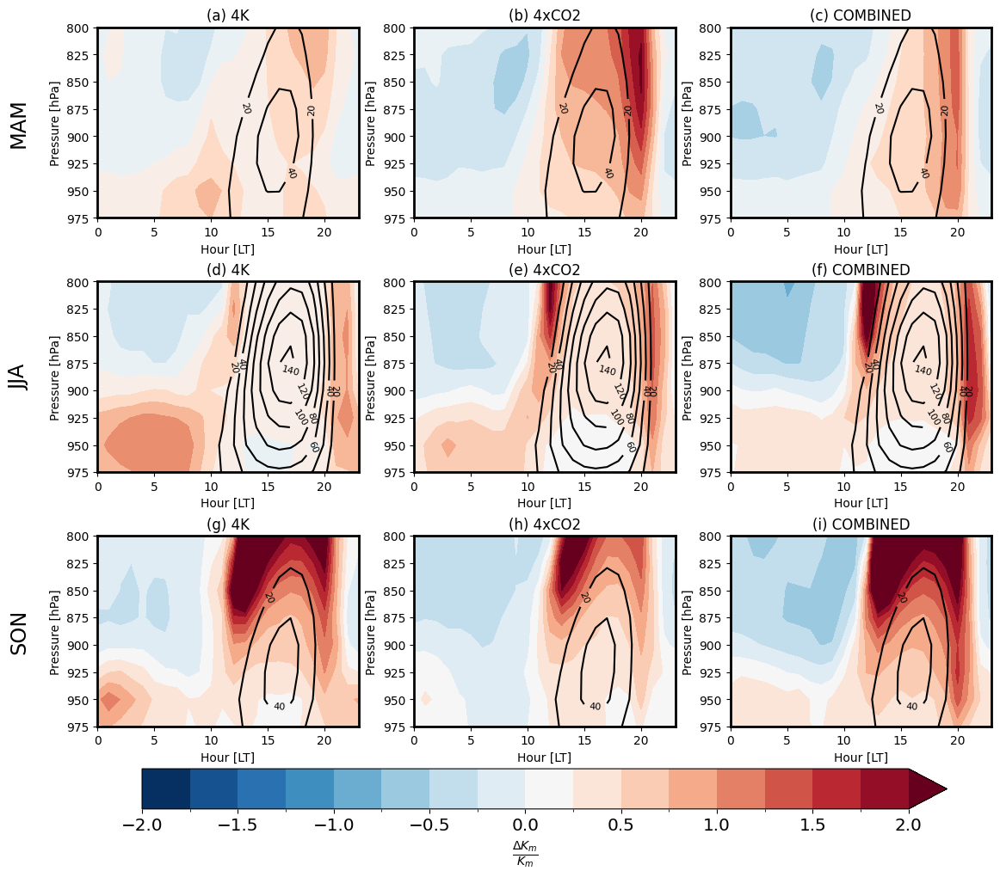

In [31]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)

label_cnt = 0

for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = Km_reduced.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        ratio = (Km_reduced.sel(forcing=forcing, season=season) - ref)/ref
        # PGF
        c = ratio.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-2,
            vmax=2,
            levels=2*8+1,
            # vmax=30,
            # levels=13,
            add_colorbar=False,
            cmap='RdBu_r',
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=0, 
            vmax=200,
            levels=5*2+1,
            # cmap=sns.color_palette('icefire', as_cmap=True),
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\frac{\Delta K_m}{K_m}$', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

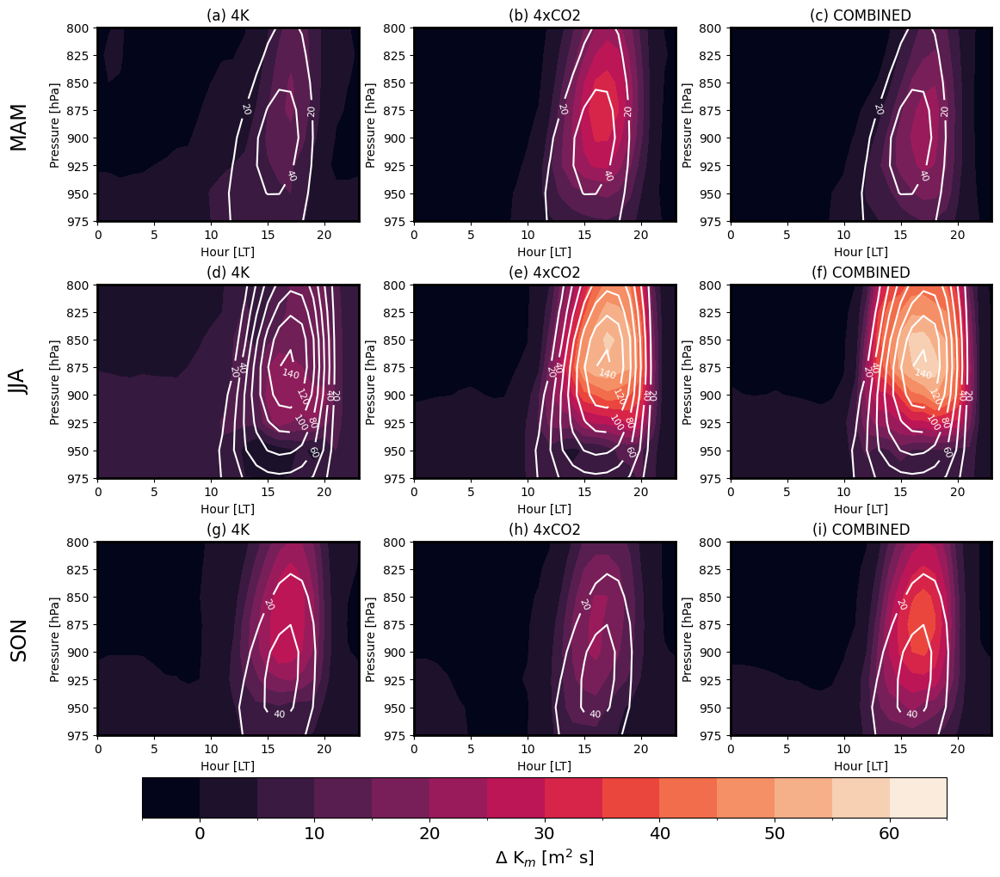

In [32]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)

label_cnt = 0

for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = Km_reduced.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = Km_reduced.sel(forcing=forcing, season=season) - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=-5,
            vmax=65,
            levels=15,
            # vmax=30,
            # levels=13,
            add_colorbar=False,
            cmap=sns.color_palette('rocket', as_cmap=True),
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=0, 
            vmax=200,
            levels=5*2+1,
            # cmap=sns.color_palette('icefire', as_cmap=True),
            colors='white',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ K$_m$ [m$^2$ s]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

# Plots of large scale conditions

## Figure - change in temperature

### Prep data

!!! NOW DOING MEAN ACROSS PRESSURE LEVELS!!!

In [5]:
ds_sel = season_diurnal_cycle(sel_region(ds.T.sel(plev=slice(800*100, None)), 'conus')).mean('plev')
temp = client.persist(ds_sel)
progress(temp)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 16.87 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

### Plot

#### Mean T change

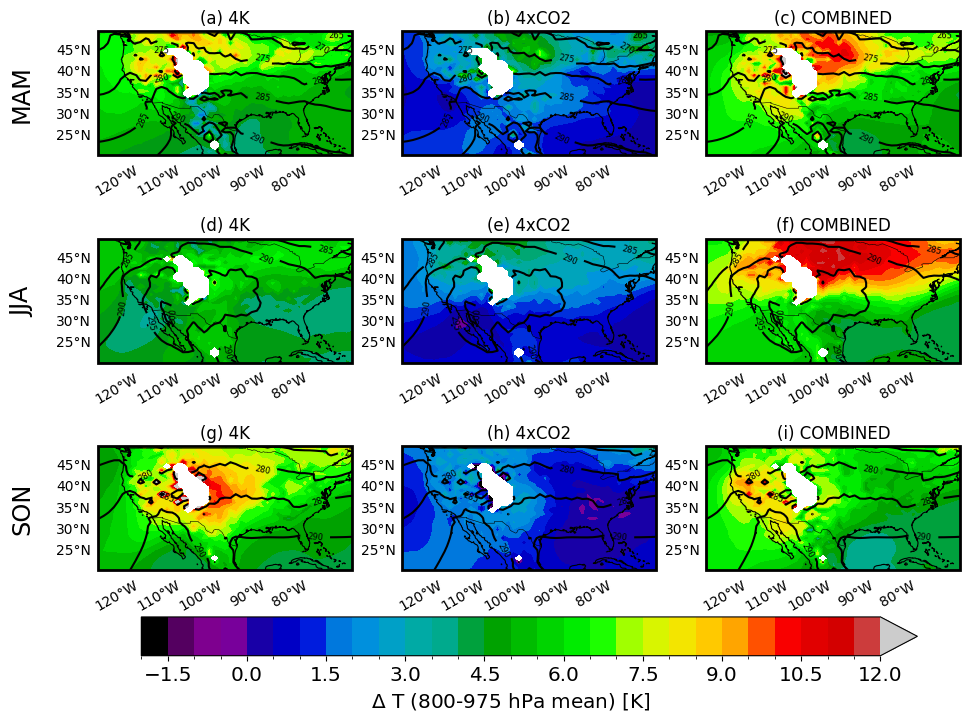

In [8]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = temp.sel(season=season, forcing='REF').mean('hour').T
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = temp.sel(forcing=forcing, season=season).mean('hour').T - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-2,
            vmax=12,
            levels=14*2+1,
            add_colorbar=False,
            cmap='nipy_spectral',
            # cmap='gist_ncar',
            # cmap = sns.color_palette('Spectral_r', as_cmap=True),
            transform=ccrs.PlateCarree(),
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=260,
            vmax=300,
            levels=9,
            transform=ccrs.PlateCarree(),
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    # ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
    #          color='black', linewidth=1,
    #          transform=ccrs.Geodetic(), #remove this line to get straight lines
    #          )

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ T (800-975 hPa mean) [K]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### By hour

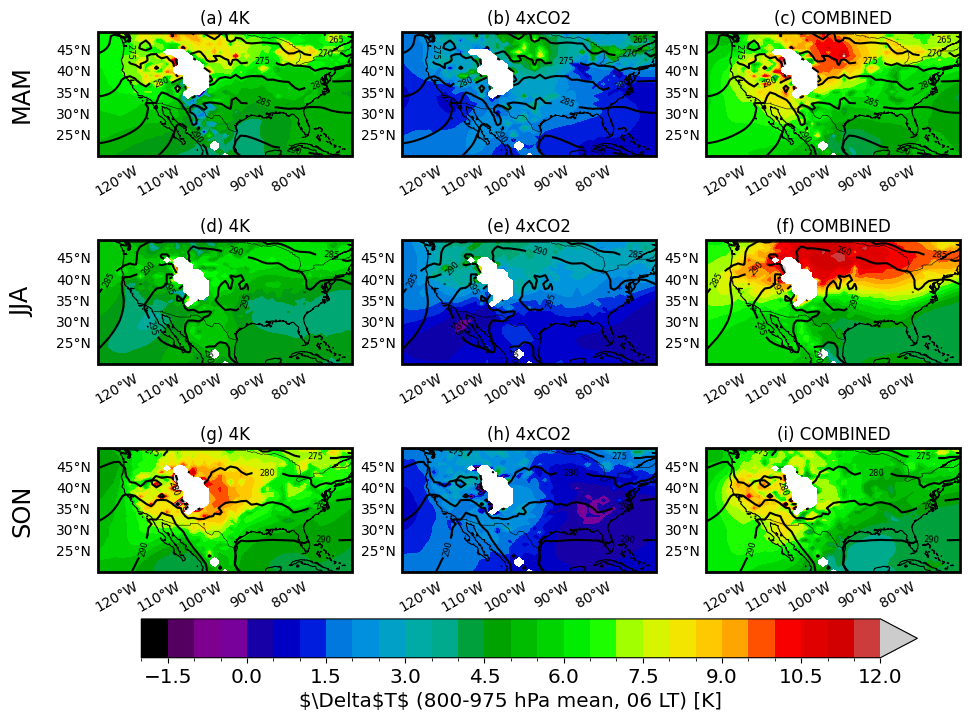

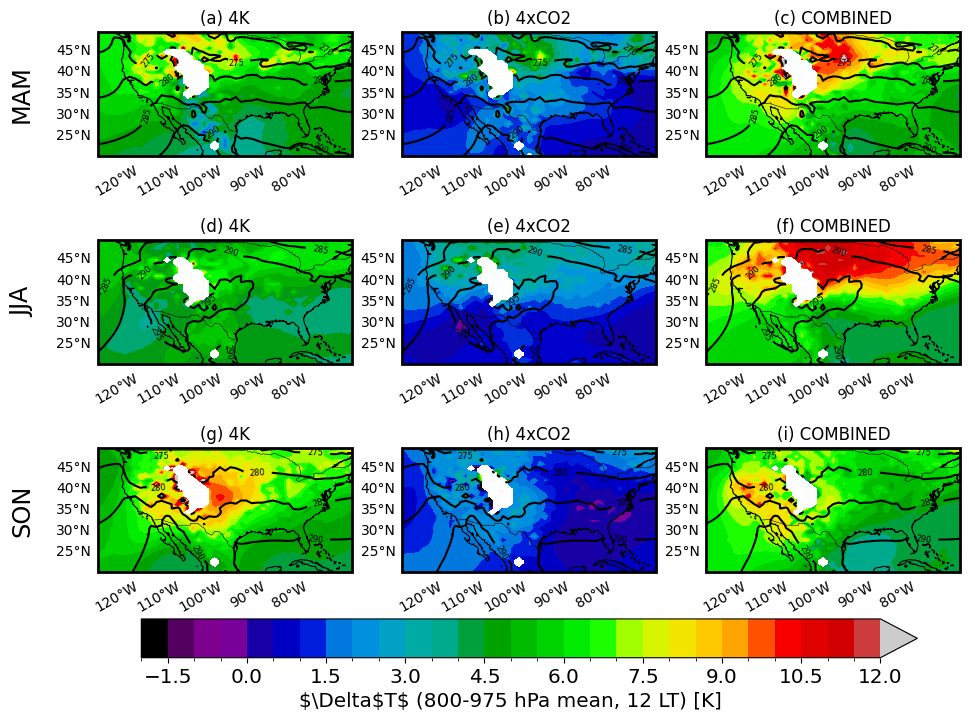

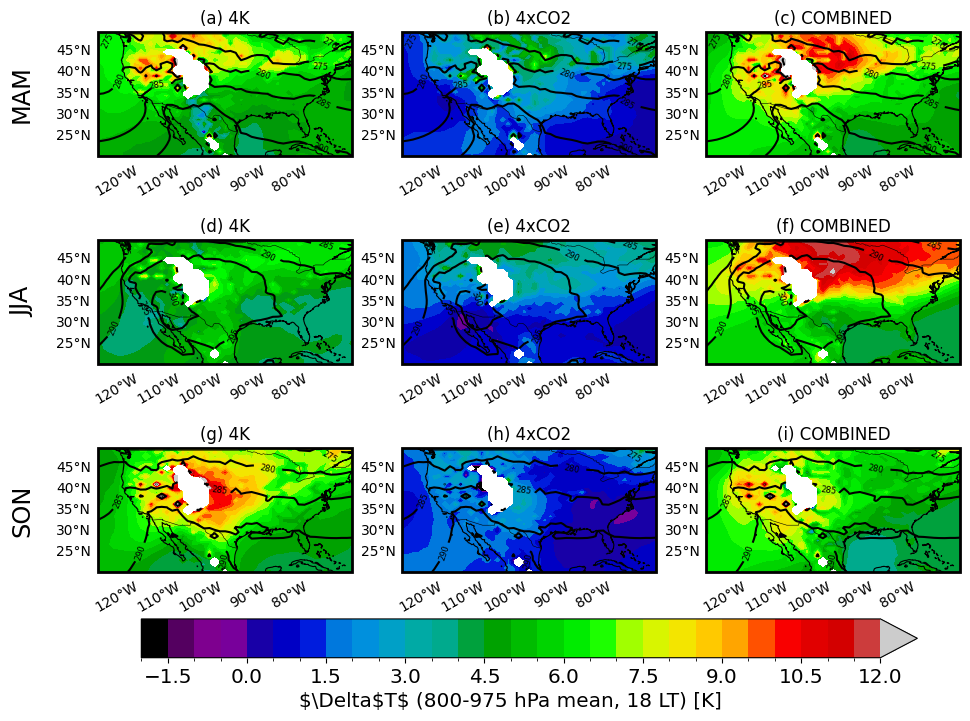

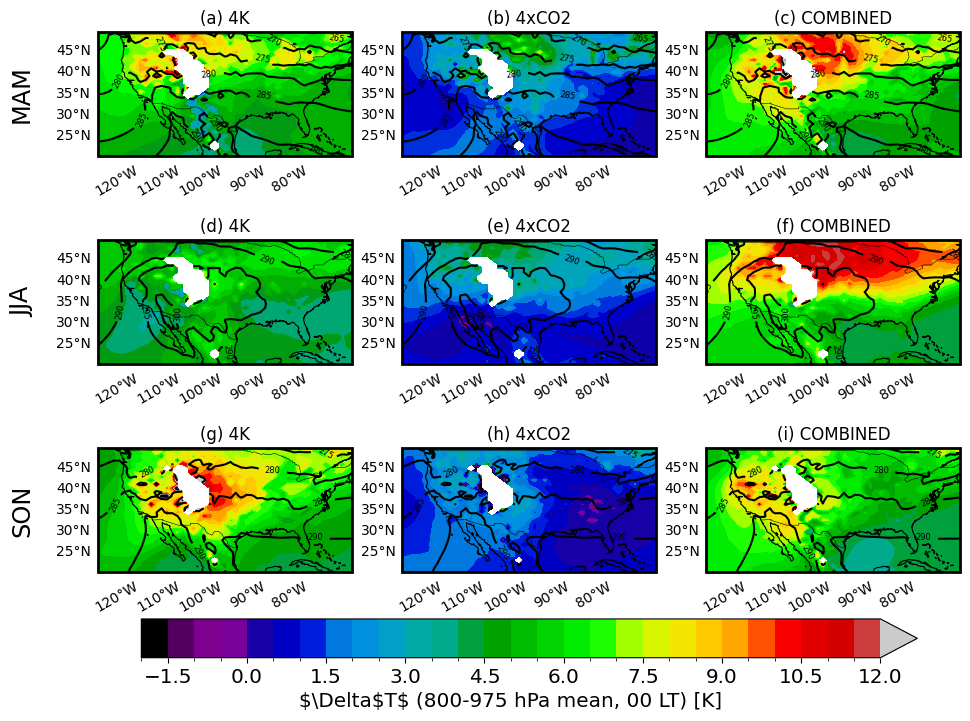

In [10]:
def plot_T_change(hour):
    fig, axes = plt.subplots(
        ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
        layout='constrained',
        subplot_kw={'projection': ccrs.PlateCarree()}, 
    
    )
    
    label_cnt = 0
    for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
        ref = temp.sel(season=season, forcing='REF').sel(hour=hour).T
        for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
            diff = temp.sel(forcing=forcing, season=season).sel(hour=hour).T - ref
            # PGF
            c = diff.plot.contourf(
                ax=axes[ax_cnt, f_cnt],
                x='lon',
                vmin=-2,
                vmax=12,
                levels=14*2+1,
                add_colorbar=False,
                cmap='nipy_spectral',
                # cmap='gist_ncar',
                # cmap = sns.color_palette('Spectral_r', as_cmap=True),
                transform=ccrs.PlateCarree(),
            )
            # Add contours for reference
            contours = ref.plot.contour(
                ax=axes[ax_cnt, f_cnt],
                x='lon',
                vmin=260,
                vmax=300,
                levels=9,
                transform=ccrs.PlateCarree(),
                colors='black',
            )
            axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
            axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
            label_cnt+=1
        axes[ax_cnt, 0].text(
            -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
            fontsize='xx-large', ha='center', va='center', rotation='vertical'
        )
        
    for i, ax in enumerate(axes.flatten()):
        big_ax(ax)
        add_latlon(ax)
        ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    
    cbar = fig.colorbar(
        c, ax=axes.ravel().tolist(),
        shrink=0.9, orientation='horizontal', pad=0.005
    )
    cbar.set_label(r'$\Delta$T '+f'(800-975 hPa mean, {str(hour).zfill(2)} LT) [K]', fontsize='x-large')
    cbar.ax.tick_params(labelsize='x-large')
    
    plt.show()
plot_T_change(6)
plot_T_change(12)
plot_T_change(18)
plot_T_change(0)

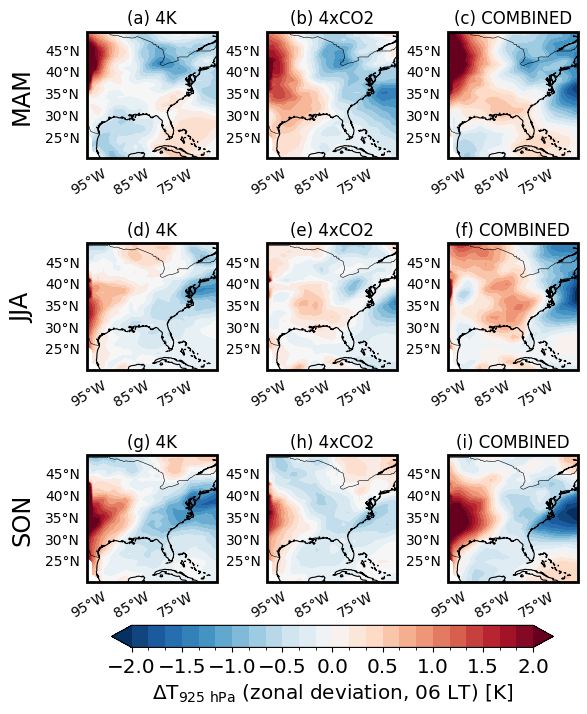

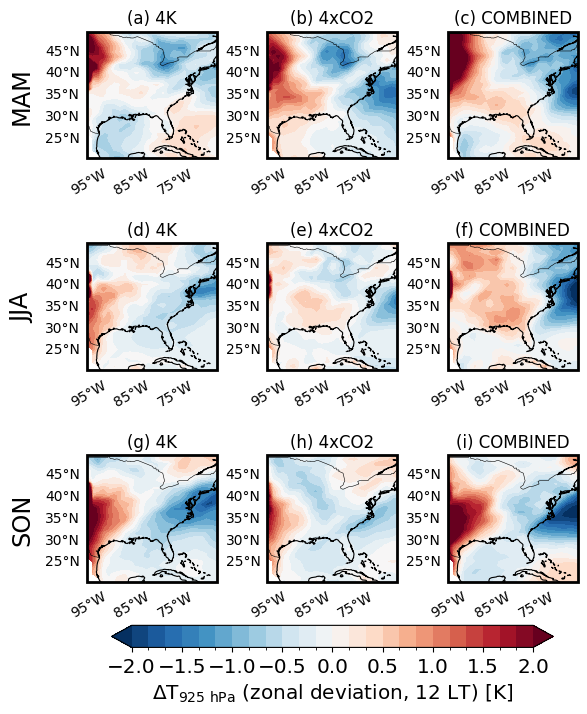

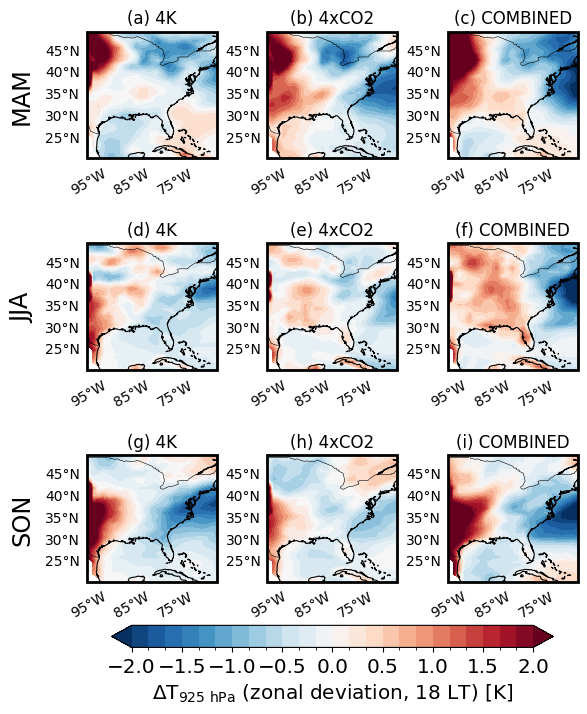

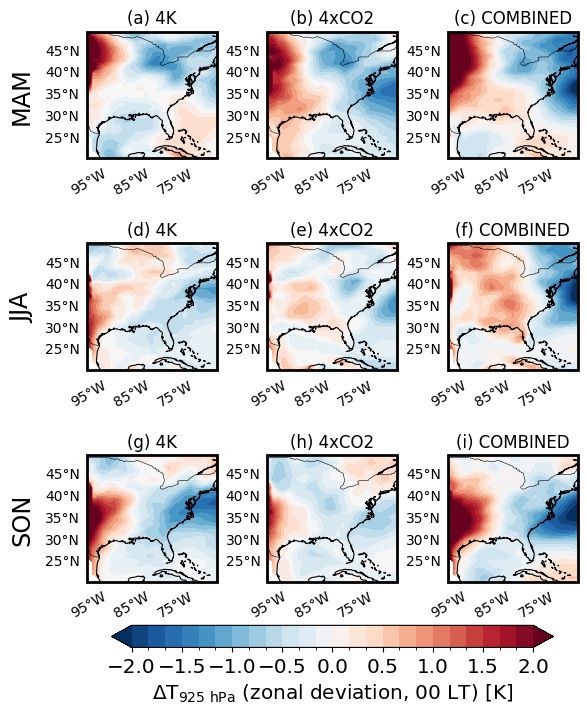

In [194]:
def plot_T_change(hour):
    fig, axes = plt.subplots(
        ncols=3, nrows=3, figsize=(6.4*0.3*3, 4.8*0.5*3),
        layout='constrained',
        subplot_kw={'projection': ccrs.PlateCarree()}, 
    
    )
    
    label_cnt = 0
    for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
        ref = temp.sel(season=season, forcing='REF', hour=hour, lon=slice(260, None)).T
        for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
            diff = temp.sel(forcing=forcing, season=season, hour=hour, lon=slice(260, None)).T - ref
            perturb_diff = diff - diff.mean('lon')
            # PGF
            c = perturb_diff.plot.contourf(
                ax=axes[ax_cnt, f_cnt],
                x='lon',
                vmin=-2,
                vmax=2,
                levels=2*12+1,
                add_colorbar=False,
                cmap='RdBu_r',
                # cmap = sns.color_palette('Spectral_r', as_cmap=True),
                transform=ccrs.PlateCarree(),
            )
            # Add contours for reference
            # contours = diff.mean('hour').plot.contour(
            #     ax=axes[ax_cnt, f_cnt],
            #     x='lon',
                # vmin=260,
                # vmax=300,
            #     levels=9,
            #     transform=ccrs.PlateCarree(),
            #     colors='black',
            # )
            # axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
            axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
            label_cnt+=1
        axes[ax_cnt, 0].text(
            -0.5, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
            fontsize='xx-large', ha='center', va='center', rotation='vertical'
        )
        
    for i, ax in enumerate(axes.flatten()):
        big_ax(ax)
        add_latlon(ax)
        ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
        ax.add_feature(cfeature.BORDERS, linewidth=0.4)
        # ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
        #          color='black', linewidth=1,
        #          transform=ccrs.Geodetic(), #remove this line to get straight lines
        #          )
    
    cbar = fig.colorbar(
        c, ax=axes.ravel().tolist(),
        shrink=0.9, orientation='horizontal', pad=0.01
    )
    cbar.set_label(r'$\Delta$T$_{925\ \text{hPa}}$ '+f'(zonal deviation, {str(hour).zfill(2)} LT) [K]', fontsize='x-large')
    cbar.ax.tick_params(labelsize='x-large')
    
    plt.show()
    return None

plot_T_change(6)
plot_T_change(12)
plot_T_change(18)
plot_T_change(0)

## Figure - change in wind speed and geopotential height

### Prep data

In [199]:
orog_mask = xr.where(ds.orog_plev <= 925*100, 1, np.nan)
ds_sel = ds[['U', 'V', 'Z3']]\
    .sel(plev=925*100)\
    .groupby('time.season').mean()
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 25.94 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

2025-11-05 16:48:06,401 - distributed.worker.state_machine - WARNING - Async instruction for <Task cancelled name="execute(('vertical_remap-getitem-ea18d4a367040d37bdb35cd9595203a5', 0, 8, 0, 0))" coro=<Worker.execute() done, defined at /home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/worker_state_machine.py:3607>> ended with CancelledError
2025-11-05 16:48:06,402 - distributed.worker.state_machine - WARNING - Async instruction for <Task cancelled name="execute(('concatenate-open_dataset-original-broadcast_to-e2a7607b2ad8d52cfecf47f529ce4bb8', 0, 466, 0, 0, 0))" coro=<Worker.execute() done, defined at /home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/worker_state_machine.py:3607>> ended with CancelledError
2025-11-05 16:48:06,402 - distributed.worker.state_machine - WARNING - Async instruction for <Task cancelled name="execute(('concatenate-open_dataset-original-broadcast_to-e2a7607b2ad8d52cfecf47f529ce4bb8', 0, 137, 0, 0, 0))" coro=<Worker.

In [7]:
ds_plot['z3_800'] = ds_plot.Z3 - 800

### Plot

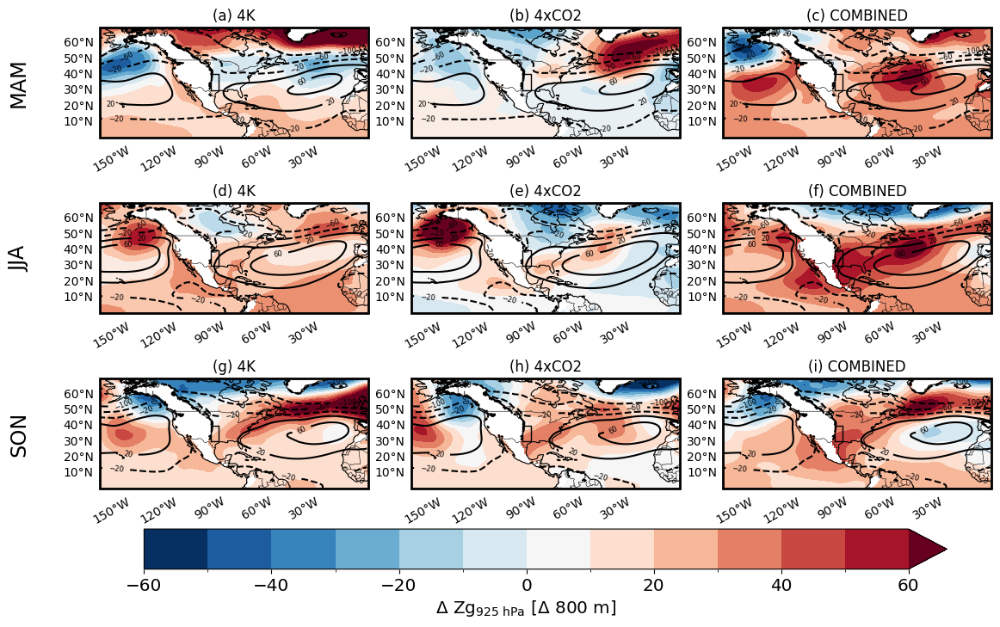

In [9]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    perturb_ref = ds_plot.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = ds_plot.sel(forcing=forcing, season=season) - perturb_ref
        c = da.z3_800.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            vmax=60,
            levels=13,
            transform=ccrs.PlateCarree(),
            add_colorbar=False,
            cmap='RdBu_r',
        )
        # q = da.coarsen(lon=2, lat=2).mean().plot.quiver(
        #     ax=axes[ax_cnt, f_cnt], 
        #     x='lon', y='lat',
        #     u='U',
        #     v='V',
        #     transform=ccrs.PlateCarree(),
        #     add_guide=False,
        #     scale=150
        # )
        # ref_magnitude = 8
        # axes[ax_cnt, f_cnt].quiverkey(
        #     q, X=0.8, Y=1.05, U=ref_magnitude, 
        #     label=f'{ref_magnitude}'+' m s$^{-1}$', 
        #     labelpos='E'
        # )
        contours = perturb_ref.z3_800.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-100,
            vmax=100,
            levels=6,
            transform=ccrs.PlateCarree(),
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        
        # CESM2 NaN mask using xarray.plot()
        orog_mask.plot(
            ax=axes[ax_cnt, f_cnt],
            transform=ccrs.PlateCarree(),
            cmap='binary_r',
            add_colorbar=False,
            vmin=0, vmax=1
        )
        
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    # ax.add_feature(cfeature.STATES, linewidth=0.4)
    # Plot GPLLJ region
    ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
             color='black', linewidth=1,
             transform=ccrs.Geodetic(), #remove this line to get straight lines
             )
cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ Zg$_{925\ \text{hPa}}$ [$\Delta \ 800$ m]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')
plt.show()

In [10]:
trimmed = sel_region(ds_plot, 'conus')

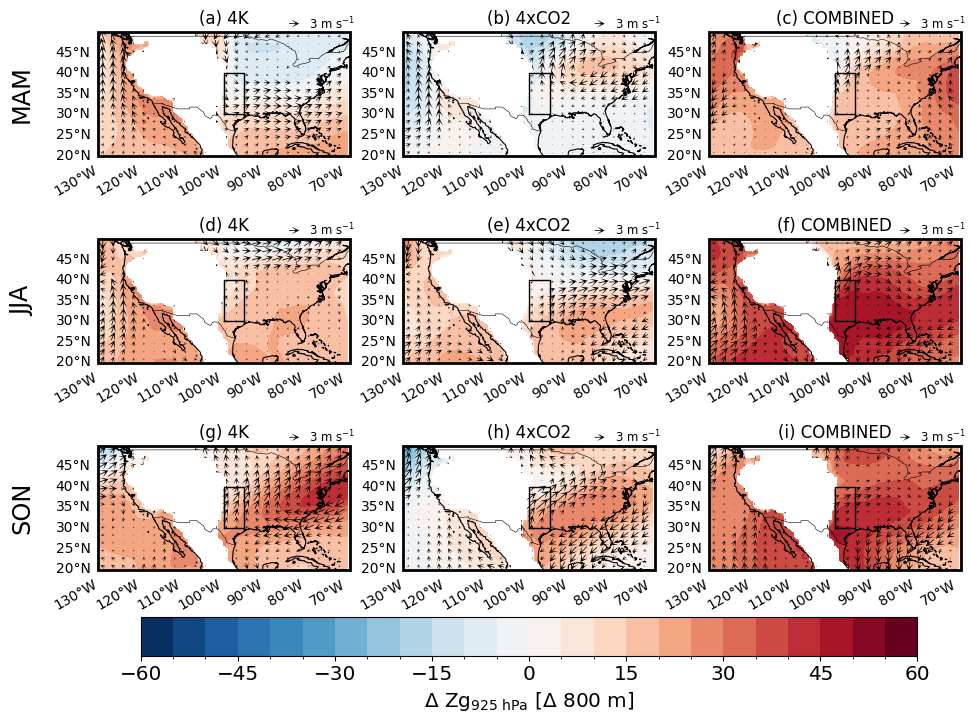

In [16]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']): ### add SON later
    perturb_ref = trimmed.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = trimmed.sel(forcing=forcing, season=season) - perturb_ref
        
        c = da.z3_800.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            vmin=-60,
            vmax=60,
            levels=6*4+1,
            transform=ccrs.PlateCarree(),
            add_colorbar=False,
            cmap='RdBu_r',
        )
        q = da.coarsen(lon=2, lat=2, boundary='trim').mean().plot.quiver(
            ax=axes[ax_cnt, f_cnt], 
            x='lon', y='lat',
            u='U',
            v='V',
            transform=ccrs.PlateCarree(),
            add_guide=False,
            scale=75,
            headwidth=10, headlength=10
        )
        ref_magnitude = 3
        axes[ax_cnt, f_cnt].quiverkey(
            q, X=0.8, Y=1.07, U=ref_magnitude, 
            label=f'{ref_magnitude}'+' m s$^{-1}$', 
            labelpos='E', fontproperties={'size': 'small'}
        )
        # CESM2 NaN mask using xarray.plot()
        sel_region(orog_mask, 'conus').plot(
            ax=axes[ax_cnt, f_cnt],
            transform=ccrs.PlateCarree(),
            cmap='binary_r',
            add_colorbar=False,
            vmin=0, vmax=1
        )
        
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    # ax.add_feature(cfeature.STATES, linewidth=0.4)
    # Plot GPLLJ region
    ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
             color='black', linewidth=1,
             transform=ccrs.Geodetic(), #remove this line to get straight lines
             )
cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ Zg$_{925\ \text{hPa}}$ [$\Delta \ 800$ m]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')
plt.show()

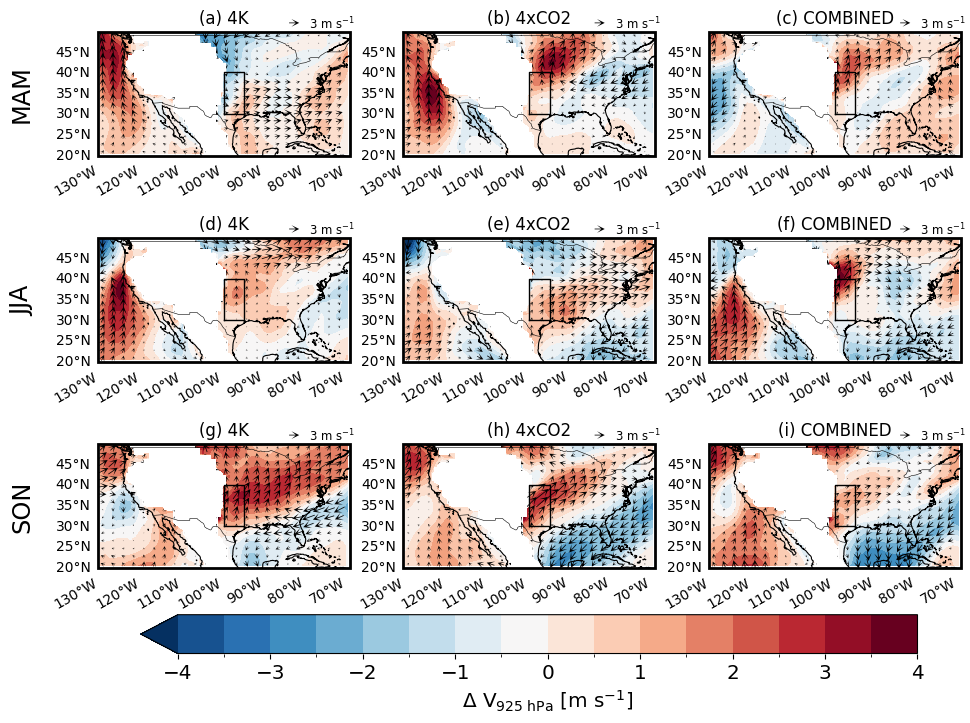

In [18]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']): ### add SON later
    perturb_ref = trimmed.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = trimmed.sel(forcing=forcing, season=season) - perturb_ref
        
        c = da.V.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            vmax=4,
            levels=17,
            transform=ccrs.PlateCarree(),
            add_colorbar=False,
            cmap='RdBu_r',
        )
        q = da.coarsen(lon=2, lat=2, boundary='trim').mean().plot.quiver(
            ax=axes[ax_cnt, f_cnt], 
            x='lon', y='lat',
            u='U',
            v='V',
            transform=ccrs.PlateCarree(),
            add_guide=False,
            scale=75,
            headwidth=10, headlength=10
        )
        ref_magnitude = 3
        axes[ax_cnt, f_cnt].quiverkey(
            q, X=0.8, Y=1.07, U=ref_magnitude, 
            label=f'{ref_magnitude}'+' m s$^{-1}$', 
            labelpos='E', fontproperties={'size': 'small'}
        )
        
        # CESM2 NaN mask using xarray.plot()
        sel_region(orog_mask, 'conus').plot(
            ax=axes[ax_cnt, f_cnt],
            transform=ccrs.PlateCarree(),
            cmap='binary_r',
            add_colorbar=False,
            vmin=0, vmax=1
        )
        
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    # ax.add_feature(cfeature.STATES, linewidth=0.4)
    # Plot GPLLJ region
    ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
             color='black', linewidth=1,
             transform=ccrs.Geodetic(), #remove this line to get straight lines
             )
cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ V$_{925\ \text{hPa}}$ [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')
plt.show()

##  Figure - precip changes

### Prep data

In [7]:
ds_sel = sel_region(ds.PRECT, 'conus')\
    .groupby('time.season').mean()\
    * 8.64e7 # convert to mm/day
precip = client.persist(ds_sel)
progress(precip)

VBox()

### Plot

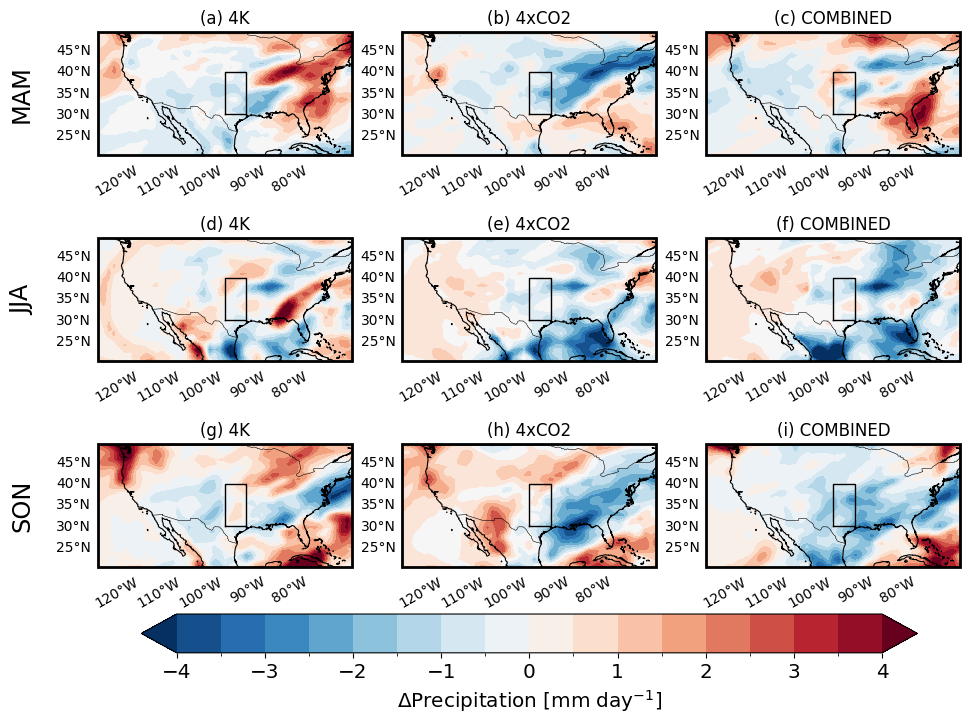

In [18]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = precip.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = precip.sel(forcing=forcing, season=season) - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-4,
            vmax=4,
            levels=4*4+1,
            add_colorbar=False,
            cmap='RdBu_r',
            transform=ccrs.PlateCarree(),
        )
        # Add contours for reference
        # contours = ref.plot.contour(
        #     ax=axes[ax_cnt, f_cnt],
        #     x='lon',
        #     vmin=0,
        #     vmax=7,
        #     levels=8,
        #     transform=ccrs.PlateCarree(),
        #     colors='black',
        # )
        # axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
             color='black', linewidth=1,
             transform=ccrs.Geodetic(), #remove this line to get straight lines
             )

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$Precipitation [mm day$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

## Figure - relative humidity changes

### Prep data

In [29]:
ds_sel = season_diurnal_cycle(sel_region(ds[['T', 'Q']], 'conus').sel(plev=slice(750*100, None)))
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 21.44 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [30]:
ds_plot = ds_plot.compute()

In [31]:
# Relative humidity in %
RH = mpcalc.relative_humidity_from_specific_humidity(
    ds_plot.plev * units('Pa'),
    ds_plot.T * units('K'),
    ds_plot.Q * units('kg/kg')
) * 100

### Plot

#### Top view

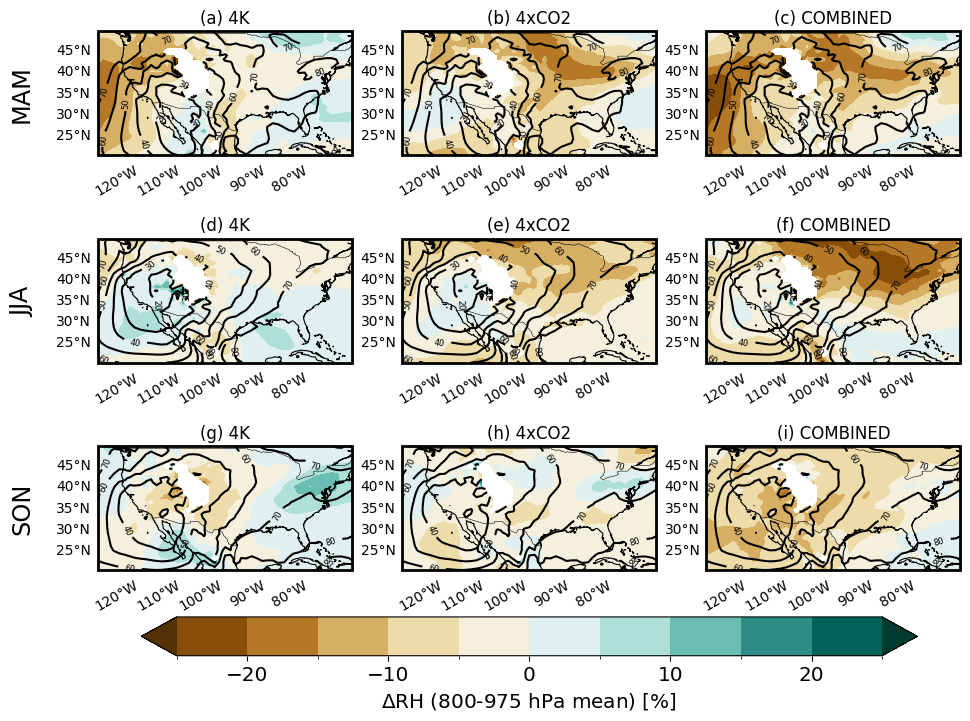

In [32]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = RH.sel(season=season, forcing='REF', plev=slice(800*100, 975*100)).mean(['hour', 'plev'])
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = RH.sel(forcing=forcing, season=season, plev=slice(800*100, 975*100)).mean(['hour', 'plev']) - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-25,
            vmax=25,
            levels=5*2+1,
            add_colorbar=False,
            cmap='BrBG',
            transform=ccrs.PlateCarree(),
            extend='both',
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=0,
            vmax=100,
            levels=11,
            transform=ccrs.PlateCarree(),
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)
    # ax.plot([-100, -95, -95, -100, -100], [30, 30, 40, 40, 30],
    #          color='black', linewidth=1,
    #          transform=ccrs.Geodetic(), #remove this line to get straight lines
    #          )

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$RH (800-975 hPa mean) [%]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Side view

In [33]:
orog_plev = meridional_mean(sel_region(ds.orog_plev, 'rockies'))
side = meridional_mean(sel_region(RH, 'rockies'))

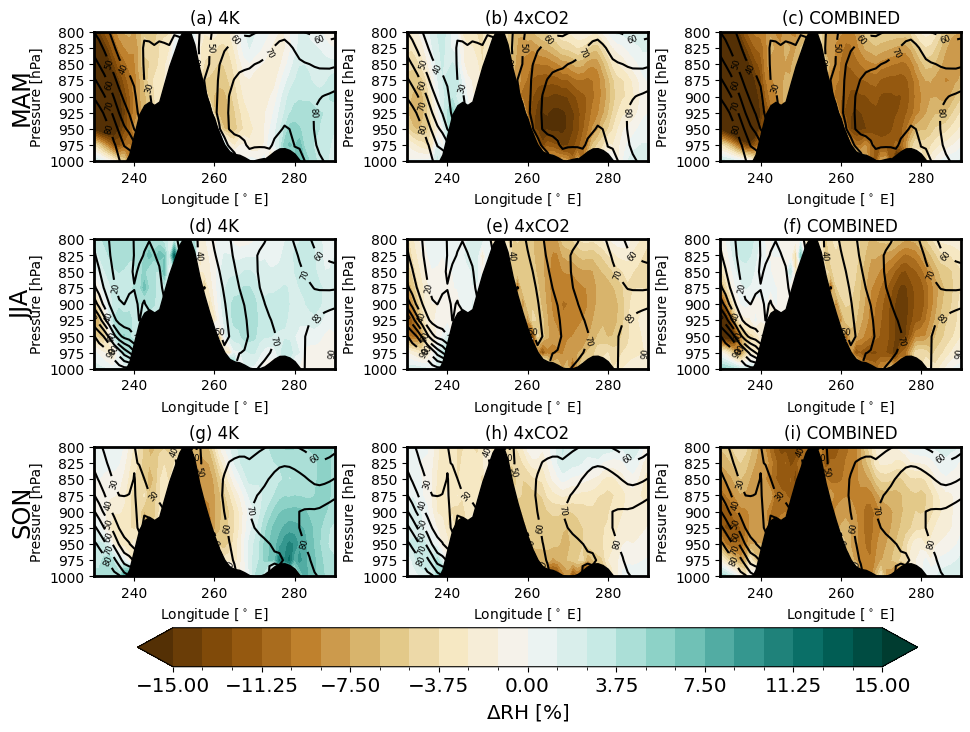

In [42]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',

)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = side.sel(season=season, forcing='REF', plev=slice(800*100, None)).mean('hour')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = side.sel(forcing=forcing, season=season, plev=slice(800*100, None)).mean('hour') - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-15,
            vmax=15,
            levels=3*8+1,
            add_colorbar=False,
            cmap='BrBG',
            extend='both',
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=0,
            vmax=100,
            levels=11,
            colors='black',
        )
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
        
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([1000*100, 800*100])
    ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$RH [%]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

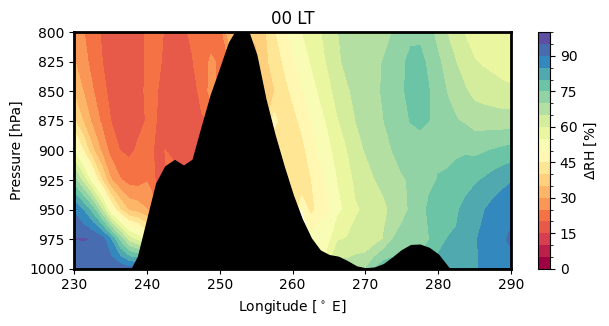

In [43]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = side.sel(season='JJA', forcing='REF').sel(hour=0).plot.contourf(
    ax=ax,
    x='lon',
    vmin=0,
    vmax=100,
    levels=10*2+1,
    add_colorbar=False,
    cmap=sns.color_palette('Spectral', as_cmap=True),
    # extend='both',
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'$\Delta$RH [%]')

orog_patch = ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([1000*100, 800*100])
ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = side.sel(season='JJA', forcing='REF', hour=hour).plot.contourf(
        ax=ax,
        x='lon',
        vmin=0,
        vmax=100,
        levels=10*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral', as_cmap=True),
    )
    ax.set_ylim([1000*100, 800*100])
    orog_patch =  ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save('../figures/RH_REF.gif', writer='pillow', fps=2)

In [48]:
forcing = 'COMBINED'
side_diff = (side.sel(forcing=forcing) - side.sel(forcing='REF')).sel(season='JJA')
save_name = f'../figures/RH_{forcing}.gif'

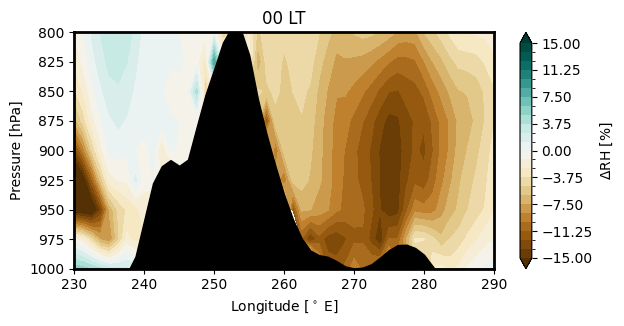

In [49]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = side_diff.sel(hour=0).plot.contourf(
    ax=ax,
    x='lon',
    vmin=-15,
    vmax=15,
    levels=3*8+1,
    add_colorbar=False,
    cmap='BrBG',
    extend='both',
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'$\Delta$RH [%]')

orog_patch = ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([1000*100, 800*100])
ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = side_diff.sel(hour=hour).plot.contourf(
        ax=ax,
        x='lon',
        vmin=-15,
        vmax=15,
        levels=3*8+1,
        add_colorbar=False,
        cmap='BrBG',
        extend='both',
    )
    ax.set_ylim([1000*100, 800*100])
    orog_patch =  ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save(save_name, writer='pillow', fps=2)

## Figure - Moisture Transport

#### Prep data

In [50]:
ds_sel = season_diurnal_cycle(sel_region(ds.VQ, 'conus').sel(plev=slice(800*100, None)))
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 16.87 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [51]:
vq = ds_plot.compute()

### Plot

#### Top view

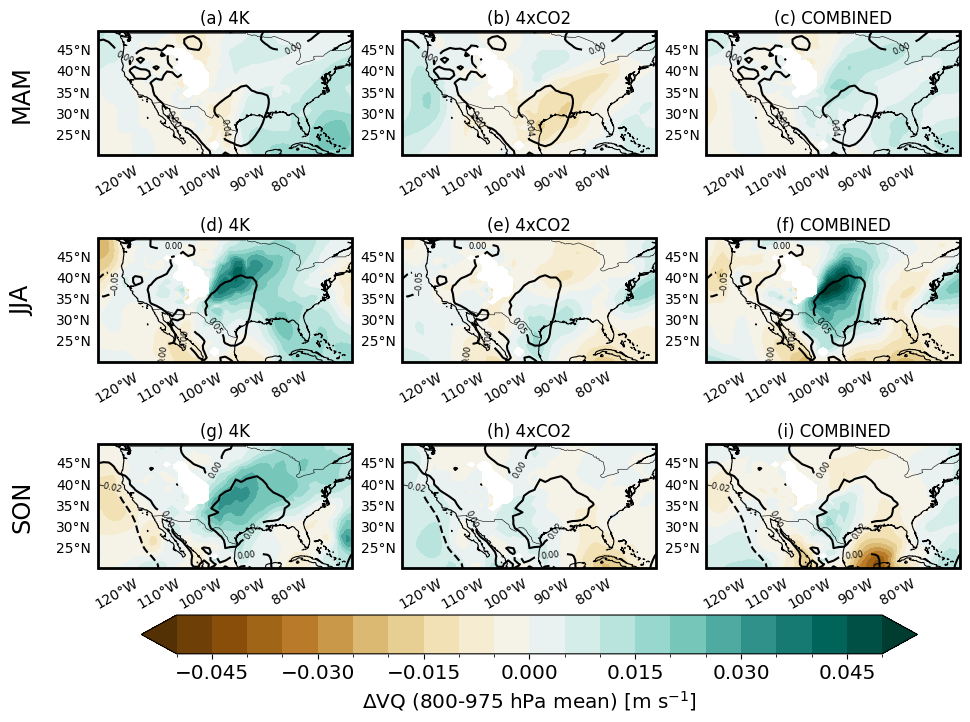

In [52]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',
    subplot_kw={'projection': ccrs.PlateCarree()}, 

)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = vq.sel(season=season, forcing='REF').mean(['hour', 'plev'])
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = vq.sel(forcing=forcing, season=season).mean(['hour', 'plev']) - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-0.05,
            vmax=0.05,
            levels=5*4+1,
            add_colorbar=False,
            cmap='BrBG',
            transform=ccrs.PlateCarree(),
            extend='both',
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            # vmin=0,
            # vmax=100,
            levels=5,
            transform=ccrs.PlateCarree(),
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    add_latlon(ax)
    ax.add_feature(cfeature.COASTLINE, linewidth=0.8)
    ax.add_feature(cfeature.BORDERS, linewidth=0.4)

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$VQ (800-975 hPa mean) [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Side view

In [53]:
orog_plev = meridional_mean(sel_region(ds.orog_plev, 'rockies'))
side = meridional_mean(sel_region(vq, 'rockies'))

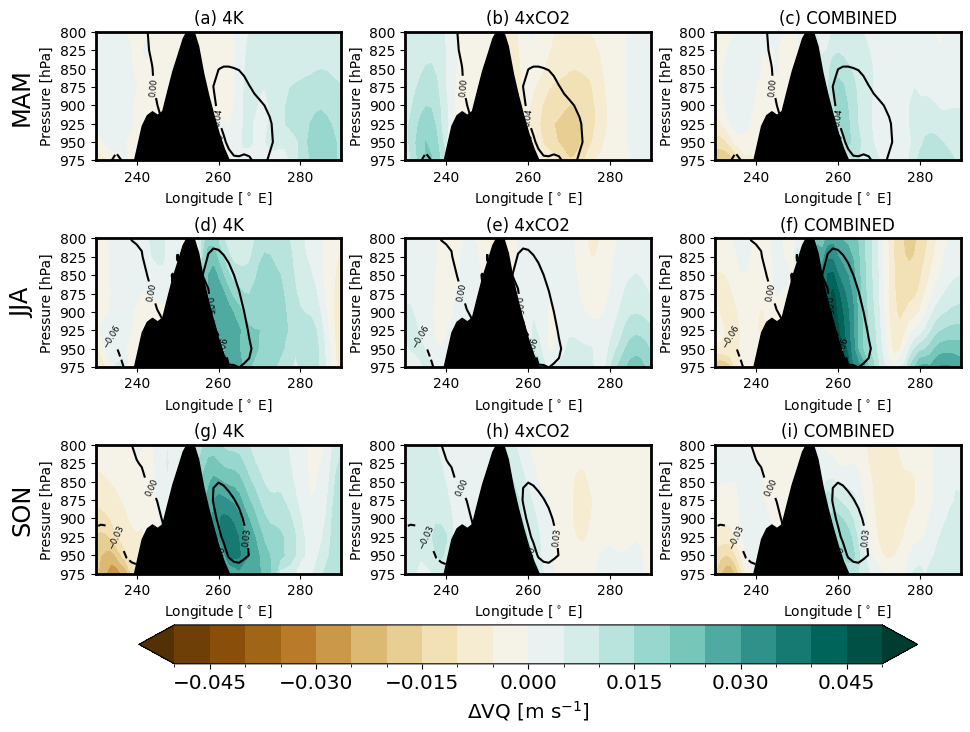

In [54]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.5*3, 4.8*0.5*3),
    layout='constrained',

)
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    ref = side.sel(season=season, forcing='REF').mean('hour')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        diff = side.sel(forcing=forcing, season=season).mean('hour') - ref
        # PGF
        c = diff.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            vmin=-0.05,
            vmax=0.05,
            levels=5*4+1,
            add_colorbar=False,
            cmap='BrBG',
            extend='both',
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='lon',
            # vmin=0,
            # vmax=100,
            levels=5,
            colors='black',
        )
        axes[ax_cnt, f_cnt].fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=6)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
        
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_xlabel(r'Longitude [$^\circ$ E]')
    ax.set_ylabel(r'Pressure [hPa]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$VQ [m s$^{-1}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

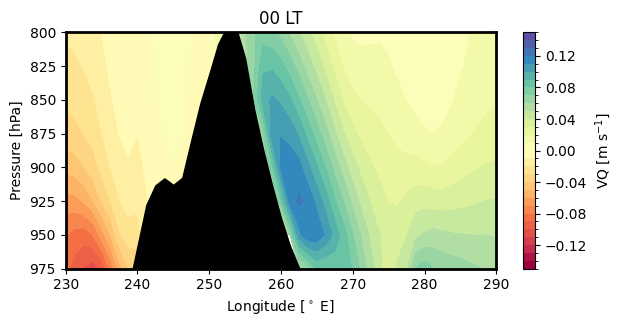

In [55]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = side.sel(season='JJA', forcing='REF').sel(hour=0).plot.contourf(
    ax=ax,
    x='lon',
    vmin=-0.15,
    vmax=0.15,
    levels=15*2+1,
    add_colorbar=False,
    cmap=sns.color_palette('Spectral', as_cmap=True),
    # extend='both',
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'VQ [m s$^{-1}$]')

orog_patch = ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([975*100, 800*100])
ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = side.sel(season='JJA', forcing='REF', hour=hour).plot.contourf(
        ax=ax,
        x='lon',
        vmin=-0.15,
        vmax=0.15,
        levels=15*2+1,
        add_colorbar=False,
        cmap=sns.color_palette('Spectral', as_cmap=True),
    )
    ax.set_ylim([975*100, 800*100])
    orog_patch =  ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save('../figures/VQ_REF.gif', writer='pillow', fps=2)

In [60]:
forcing = 'COMBINED'
side_diff = (side.sel(forcing=forcing) - side.sel(forcing='REF')).sel(season='JJA')
save_name = f'../figures/VQ_{forcing}.gif'

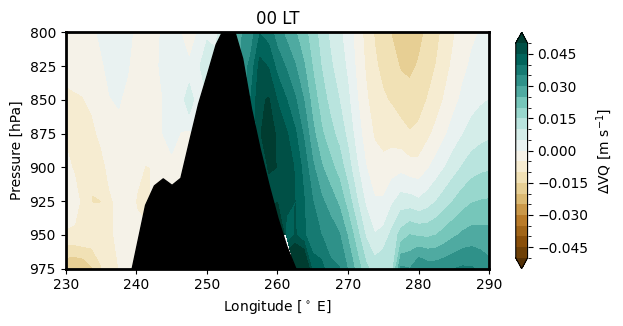

In [61]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = side_diff.sel(hour=0).plot.contourf(
    ax=ax,
    x='lon',
    vmin=-0.05,
    vmax=0.05,
    levels=5*4+1,
    add_colorbar=False,
    cmap='BrBG',
    extend='both',
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'$\Delta$VQ [m s$^{-1}$]')

orog_patch = ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([975*100, 800*100])
ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = side_diff.sel(hour=hour).plot.contourf(
        ax=ax,
        x='lon',
        vmin=-0.05,
        vmax=0.05,
        levels=5*4+1,
        add_colorbar=False,
        cmap='BrBG',
        extend='both',
    )
    ax.set_ylim([975*100, 800*100])
    orog_patch =  ax.fill_between(orog_plev.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save(save_name, writer='pillow', fps=2)

# Plot of temperature profiles/stability

## Figure - potential temperature and Richardson number

### Prep data

In [23]:
ds_sel = sel_region(ds[['T', 'U', 'V', 'RHO_CLUBB']], 'LLJ')\
        .sel(plev=slice(500*100, 975*100))
ds_plot = client.persist(ds_sel)
progress(ds_plot)

!!! Using a different bounding box to test !!!

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 37.97 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

Gradient richardson number:
$$Ri_g = \frac{g}{\theta}\frac{\partial \theta /\partial z}{(\partial u/\partial z)^2 +(\partial v/\partial z)^2}$$

In [32]:
exner_fxn = mpcalc.exner_function(ds.plev * units('Pa')).metpy.dequantify()
theta = (ds_plot.T / exner_fxn).rename('theta').compute()
# Need these to be in height coordinates so use hydrostatic balance
factor = - ds_plot.RHO_CLUBB.metpy.quantify() * mpconst.earth_gravity
# We lose all units
dthetadz = (mpcalc.first_derivative(theta, axis='plev') * factor).metpy.dequantify().compute()
dudz = (mpcalc.first_derivative(ds_plot.U, axis='plev') * factor).metpy.dequantify().compute()
dvdz = (mpcalc.first_derivative(ds_plot.V, axis='plev') * factor).metpy.dequantify().compute()

Ri_g = (mpconst.earth_gravity / theta) * (dthetadz / (dudz ** 2 + dvdz ** 2))

In [33]:
theta_reduced = season_diurnal_cycle(spatial_mean(theta))
Ri_g_reduced = season_diurnal_cycle(spatial_mean(Ri_g))

In [41]:
perturb = theta - theta.mean('hour')

### Plot

0600 LT is dashed, 1800 LT is dotted

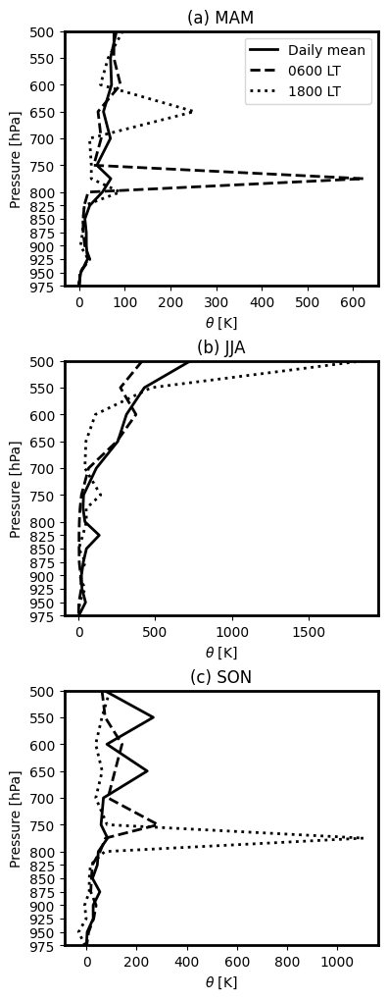

In [34]:
# Change at 0300 and 1800 LT
daily = Ri_g_reduced.mean('hour')
night = Ri_g_reduced.sel(hour=6)
day = Ri_g_reduced.sel(hour=18)

fig, axes = plt.subplots(
    ncols=1, nrows=3, figsize=(6.4*0.6, 4.8*0.7*3),
    layout='constrained'
)
colors = sns.color_palette('dark')
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    forcing='REF'
    c = 'k'
    daily.sel(season=season, forcing=forcing).plot(
        ax=axes[ax_cnt], y='plev',
        color=c, lw=2,
        label='Daily mean',
    )
    night.sel(season=season, forcing=forcing).plot(
        ax=axes[ax_cnt], y='plev',
        color=c, lw=2, linestyle='dashed',
        label='0600 LT',
    )
    day.sel(season=season, forcing=forcing).plot(
        ax=axes[ax_cnt], y='plev',
        color=c, lw=2, linestyle='dotted',
        label='1800 LT'
    )
    axes[ax_cnt].set_title(f'({string.ascii_lowercase[ax_cnt]}) {season}')

for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 500*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800, 750, 700, 650, 600, 550, 500])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel(r'$\theta$ [K]')

axes[0].legend()

plt.show()

#### Daily pertubation

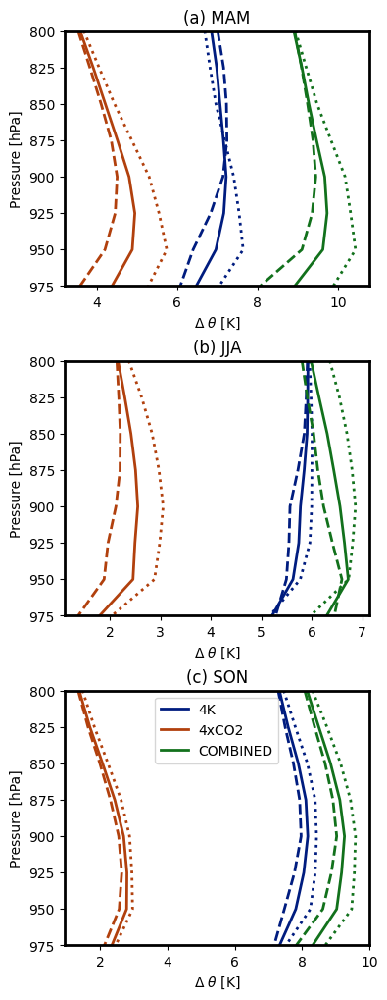

In [54]:
# Change at 0600 and 1800 LT
daily = theta.mean('hour') - theta.mean('hour').sel(forcing='REF')
night = theta.sel(hour=6) - theta.sel(hour=6, forcing='REF')
day = theta.sel(hour=18) - theta.sel(hour=18, forcing='REF')

fig, axes = plt.subplots(
    ncols=1, nrows=3, figsize=(6.4*0.6, 4.8*0.7*3),
    layout='constrained'
)
colors = sns.color_palette('dark')
label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']):
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        c = colors[f_cnt]
        # if forcing == 'REF':
        #     c = 'k'
        daily.sel(season=season, forcing=forcing).plot(
            ax=axes[ax_cnt], y='plev',
            color=c, lw=2,
            label=forcing,
        )
        night.sel(season=season, forcing=forcing).plot(
            ax=axes[ax_cnt], y='plev',
            color=c, lw=2, linestyle='dashed',
        )
        day.sel(season=season, forcing=forcing).plot(
            ax=axes[ax_cnt], y='plev',
            color=c, lw=2, linestyle='dotted',
        )
        axes[ax_cnt].set_title(f'({string.ascii_lowercase[ax_cnt]}) {season}')

for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel(r'$\Delta $ $\theta$ [K]')

axes[2].legend()

plt.show()

## Figure - side profiles of theta and PGF (JJA)

In [5]:
ds_sel = season_diurnal_cycle(
    meridional_mean(
        sel_region(ds[['T', 'U', 'Z3', 'OMEGA', 'PBLH', 'orog_plev']], 'rockies')
        .where(ds['time.month'].isin([6,7,8]), drop=True)
        .sel(plev=slice(750*100, None))
    )
)
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 34.18 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [6]:
ds_plot = ds_plot.compute().squeeze()
ds_plot

<xarray.Dataset> Size: 2MB
Dimensions:    (forcing: 4, plev: 11, lon: 49, hour: 24)
Coordinates:
  * lon        (lon) float64 392B 230.0 231.2 232.5 233.8 ... 287.5 288.8 290.0
  * forcing    (forcing) object 32B '4K' '4xCO2' 'COMBINED' 'REF'
  * plev       (plev) int64 88B 75000 77500 80000 82500 ... 95000 97500 100000
    season     <U3 12B 'JJA'
  * hour       (hour) int64 192B 0 1 2 3 4 5 6 7 8 ... 16 17 18 19 20 21 22 23
Data variables:
    T          (forcing, plev, lon, hour) float64 414kB 288.3 288.3 ... 296.1
    U          (forcing, plev, lon, hour) float64 414kB 1.382 1.241 ... 2.354
    Z3         (forcing, plev, lon, hour) float64 414kB 2.651e+03 ... 185.7
    OMEGA      (forcing, plev, lon, hour) float64 414kB 0.05958 ... -0.002824
    PBLH       (forcing, lon, hour) float64 38kB 514.5 509.4 ... 552.7 553.7
    orog_plev  (lon, hour) float64 9kB 1.013e+05 1.013e+05 ... 1.013e+05

In [7]:
exner_fxn = mpcalc.exner_function(ds_plot.plev * units('Pa')).metpy.dequantify()
theta = (ds_plot.T / exner_fxn).rename(r'$\theta$ [$^\circ$C]') - 273.15
u = ds_plot.U
omega = ds_plot.OMEGA * 50 # scaling factor
orog_plev = ds_plot.orog_plev.isel(hour=0)
winds = xr.merge([u, omega])

### Plot

#### Potential temperature

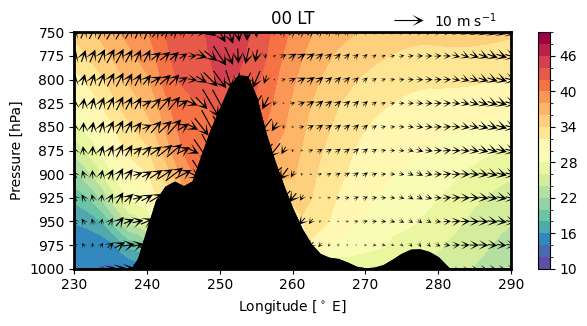

In [8]:
from matplotlib.animation import FuncAnimation
import matplotlib

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = theta.sel(forcing='REF').isel(hour=0).plot.contourf(
    ax=ax, 
    vmin=10, vmax=50, levels=4*5+1, 
    cmap=sns.color_palette('Spectral_r', as_cmap=True),
    add_colorbar=False  # We'll add it manually to prevent issues
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax)

# Initial quiver plot
q = winds.sel(forcing='REF').isel(hour=0).plot.quiver(
    x='lon', y='plev',
    u='U', v='OMEGA',
    add_guide=False,
    scale=150, 
    headwidth=10, headlength=10,
)

ref_magnitude = 10
quiver_key = ax.quiverkey(
    q, X=0.8, Y=1.05, U=ref_magnitude, 
    label=f'{ref_magnitude}'+' m s$^{-1}$', 
    labelpos='E'
)

ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')
orog_patch = ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([1000*100, 750*100])
ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800, 775, 750])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, q, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = ax.contourf(
        theta.lon, theta.plev, 
        theta.sel(forcing='REF').isel(hour=frame).values,
        vmin=10, vmax=50, levels=4*5+1,
        cmap=sns.color_palette('Spectral_r', as_cmap=True)
    )
    
    # Update quiver plot
    new_winds = winds.sel(forcing='REF').isel(hour=frame)
    q = ax.quiver(
        new_winds.lon, new_winds.plev,
        new_winds.U, new_winds.OMEGA,
        scale=150, 
        headwidth=10, headlength=10,
    )
    orog_patch = ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, q, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save('../figures/theta_REF.gif', writer='pillow', fps=2)

#### Changes

In [15]:
forcing = '4xCO2'
save_name = f'../figures/theta_{forcing}.gif'

theta_diff = theta.sel(forcing=forcing)-theta.sel(forcing='REF')
winds_diff = winds.sel(forcing=forcing)-winds.sel(forcing='REF')

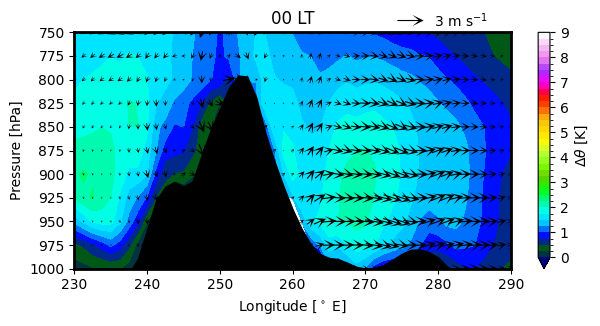

In [16]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = theta_diff.isel(hour=0).plot.contourf(
    ax=ax, 
    vmin=0, vmax=9, levels=9*4+1, 
    cmap='gist_ncar',
    add_colorbar=False  # We'll add it manually to prevent issues
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'$\Delta \theta$ [K]')

# Initial quiver plot
q = winds_diff.isel(hour=0).plot.quiver(
    x='lon', y='plev',
    u='U', v='OMEGA',
    add_guide=False,
    scale=50, 
    headwidth=10, headlength=10,
)

ref_magnitude = 3
quiver_key = ax.quiverkey(
    q, X=0.8, Y=1.05, U=ref_magnitude, 
    label=f'{ref_magnitude}'+' m s$^{-1}$', 
    labelpos='E'
)

ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([1000*100, 750*100])
ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800, 775, 750])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, q, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = ax.contourf(
        theta_diff.lon, theta_diff.plev, 
        theta_diff.isel(hour=frame).values,
        vmin=0, vmax=9, levels=9*4+1, 
        cmap='gist_ncar',
    )
    
    # Update quiver plot
    new_winds = winds_diff.isel(hour=frame)
    q = ax.quiver(
        new_winds.lon, new_winds.plev,
        new_winds.U, new_winds.OMEGA,
        scale=50, 
        headwidth=10, headlength=10,
    )
    orog_patch = ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, q, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save(save_name, writer='pillow', fps=2)

#### PGF

$$V_g = \frac{1}{f}\frac{\partial \Phi}{\partial \lambda}$$

In zonal momentum equation PGF is also $\times -1$

In [17]:
# ZONAL pressure gradient force
# need a placeholder latitude for metpy, it isn't used
expanded = ds_plot.metpy.parse_cf().Z3\
    .expand_dims({'lat': [35]})
pgf = -1 * mpcalc.first_derivative(expanded * mpconst.earth_gravity, axis='lon').squeeze().metpy.dequantify() * 10e5

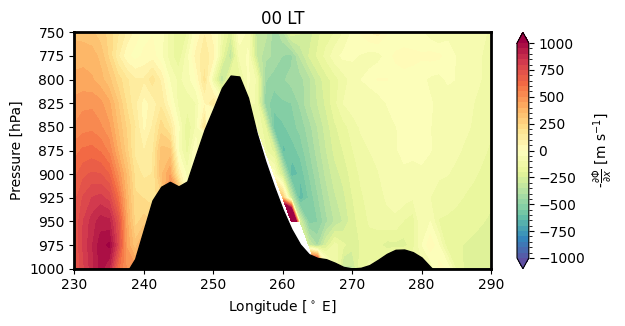

In [68]:
from matplotlib.animation import FuncAnimation
import matplotlib

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = pgf.sel(forcing='REF').isel(hour=0).plot.contourf(
    ax=ax, 
    vmin=-1000, vmax=1000, levels=10*4+1, 
    cmap=sns.color_palette('Spectral_r', as_cmap=True),
    extend='both',
    add_colorbar=False  # We'll add it manually to prevent issues
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'-$\frac{\partial \Phi}{\partial x}$ [m s$^{-1}$]')

ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([1000*100, 750*100])
ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800, 775, 750])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = ax.contourf(
        pgf.lon, pgf.plev, 
        pgf.sel(forcing='REF').isel(hour=frame).values,
        vmin=-1000, vmax=1000, levels=10*4+1,  extend='both',
        cmap=sns.color_palette('Spectral_r', as_cmap=True)
    )
    orog_patch = ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save('../figures/PGF_REF.gif', writer='pillow', fps=2)

#### Changes

In [73]:
forcing = 'COMBINED'
save_name = f'../figures/PGF_{forcing}.gif'

pgf_diff = pgf.sel(forcing=forcing)-pgf.sel(forcing='REF')

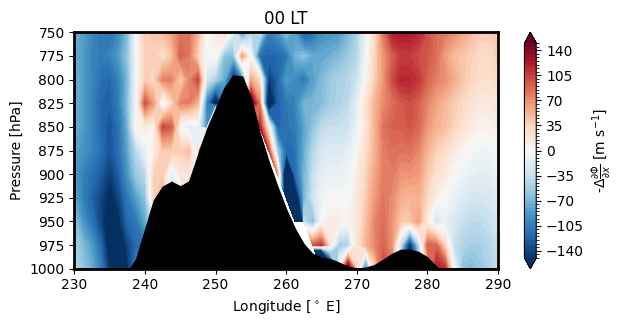

In [74]:
from matplotlib.animation import FuncAnimation
import matplotlib

# Set up the figure and axis
fig, ax = plt.subplots(figsize=(6.4, 4.8*0.7))

# Initial plot
im = pgf_diff.isel(hour=0).plot.contourf(
    ax=ax, 
    vmin=-150, vmax=150, levels=15*4+1, 
    cmap='RdBu_r',
    extend='both',
    add_colorbar=False  # We'll add it manually to prevent issues
)
# Add colorbar manually to ensure it doesn't change
cbar = plt.colorbar(im, ax=ax, label=r'-$\Delta \frac{\partial \Phi}{\partial x}$ [m s$^{-1}$]')

ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')

big_ax(ax)
ax.set_ylim([1000*100, 750*100])
ticks = np.array([1000, 975, 950, 925, 900, 875, 850, 825, 800, 775, 750])
ax.set_yticks(ticks*100)
ax.set_yticklabels(ticks)
ax.set_xlabel(r'Longitude [$^\circ$ E]')
ax.set_ylabel(r'Pressure [hPa]')
title = ax.set_title(f'{str(0).zfill(2)} LT')

def init():
    """Initialize animation"""
    return [im, orog_patch]

def animate(frame):
    """Update function for animation"""
    hour = np.arange(0, 24)[frame]

    im = ax.contourf(
        pgf_diff.lon, pgf_diff.plev, 
        pgf_diff.isel(hour=frame).values,
        vmin=-150, vmax=150, levels=15*4+1,  extend='both',
        cmap='RdBu_r'
    )
    orog_patch = ax.fill_between(ds_plot.lon, 1000*100, orog_plev, color='k')
    # Update title
    title.set_text(f'{str(hour).zfill(2)} LT')
    
    return [im, orog_patch]

# Create animation
anim = FuncAnimation(
    fig,
    animate,
    init_func=init,
    frames=24,
    interval=200,  # milliseconds between frames
    blit=False,
    repeat=True
)

# Display or save
plt.tight_layout()
plt.show()  # Uncomment to display

# To save the animation:
anim.save(save_name, writer='pillow', fps=2)

## Figure - latent and sensible heating

$$R_s = \text{LE} + \text{SH} + \Delta F_{\text{eo}}$$
$$\text{SH}= c_p \rho \overline{w'T'} \text{ (heat flux, WPTHLP\_CLUBB) }\ ,\ \text{LE} = L\rho \overline{w'q'} \text{ (moisture flux, WPRTP\_CLUBB) }$$

- R$_s$: net radiation
- SH: radiative cooling
- LE: evaporative cooling

### Prep data

In [6]:
ds_sel = season_diurnal_cycle(
    spatial_mean(
        sel_region(ds[['WPRTP_CLUBB', 'WPTHLP_CLUBB', 'WPTHVP_CLUBB']], 'LLJ')\
        .sel(plev=slice(800*100, 975*100))
    )
)
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 21.19 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

### Plot

In [79]:
SH = ds_plot.WPTHLP_CLUBB
LE = ds_plot.WPRTP_CLUBB
Rs = SH + LE

#### Radiative cooling

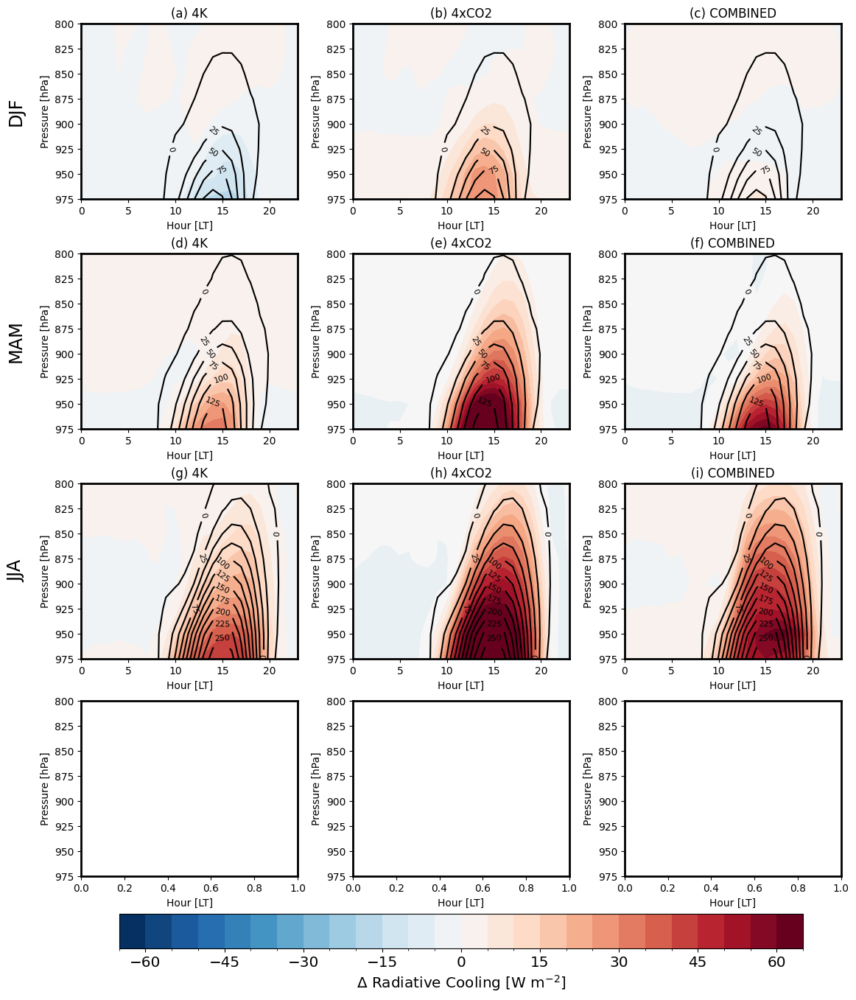

In [91]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)

label_cnt = 0
for ax_cnt, season in enumerate(['DJF', 'MAM', 'JJA']): ### add SON later
    ref = SH.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = SH.sel(forcing=forcing, season=season) - ref
        # PGF
        c = da.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            add_colorbar=False,
            cmap='RdBu_r',
            vmax=65,
            levels=27,
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=0, 
            vmax=250,
            levels=11,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ Radiative Cooling [W m$^{-2}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Evaporative cooling

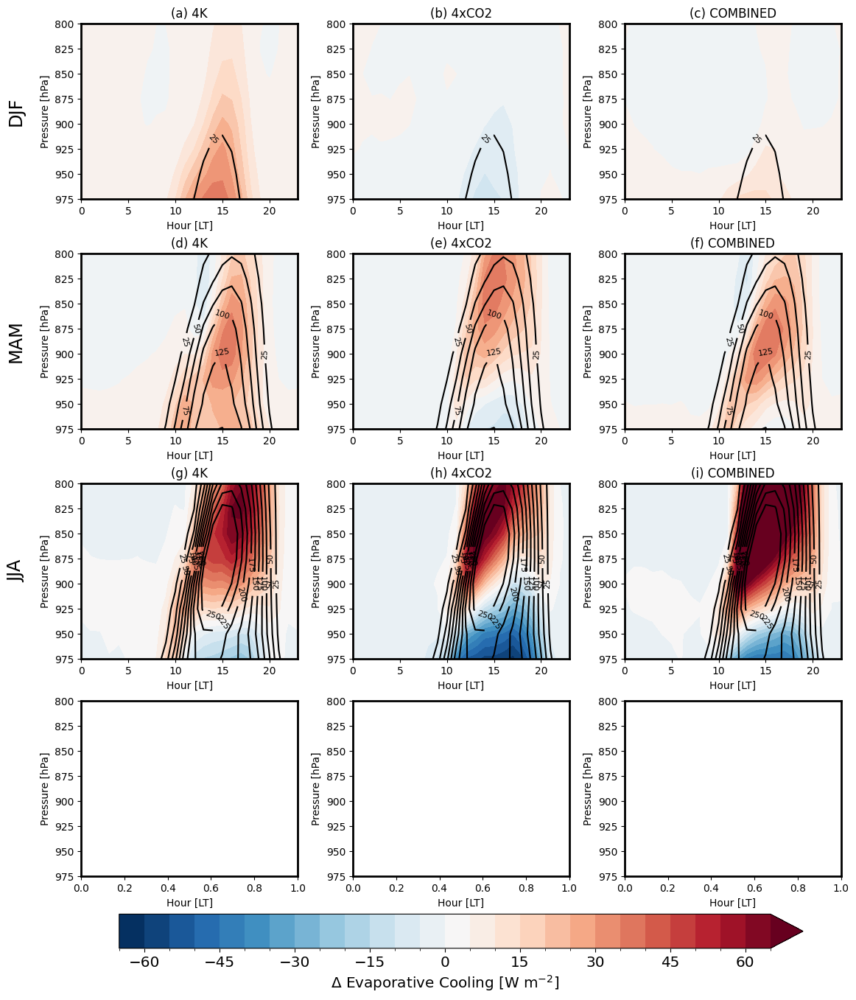

In [94]:
fig, axes = plt.subplots(
    ncols=3, nrows=3, figsize=(6.4*0.6*3, 4.8*0.7*3),
    layout='constrained'
)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA']): ### add SON later
    ref = LE.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = LE.sel(forcing=forcing, season=season) - ref
        # PGF
        c = da.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            add_colorbar=False,
            cmap='RdBu_r',
            vmax=65,
            levels=27,
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            vmin=0, 
            vmax=250,
            levels=11,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$ Evaporative Cooling [W m$^{-2}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()

#### Surface balance (975 hPa)

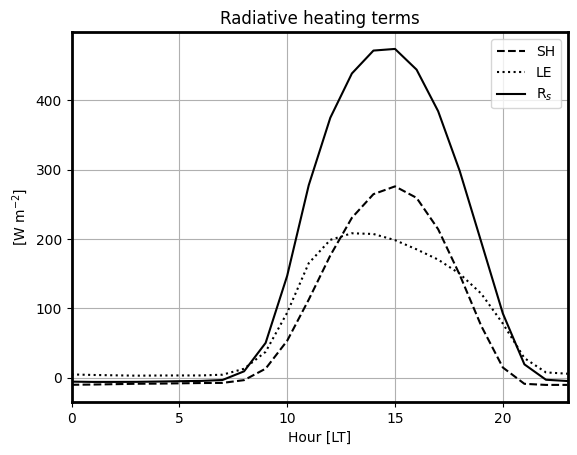

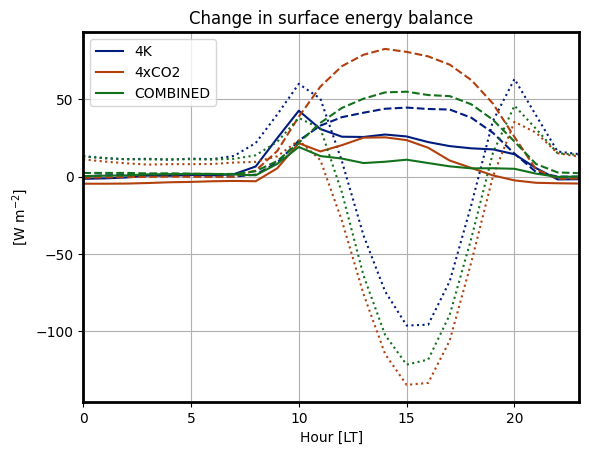

In [215]:
# ds_JJA = ds_plot.sel(plev=975*100, season='JJA')

fig, ax = plt.subplots()
ds_JJA.WPTHLP_CLUBB.sel(forcing='REF').plot(ax=ax, linestyle='dashed', c='k', label='SH')
ds_JJA.WPRTP_CLUBB.sel(forcing='REF').plot(ax=ax, linestyle='dotted', c='k', label='LE')
(ds_JJA.WPTHLP_CLUBB + ds_JJA.WPRTP_CLUBB).sel(forcing='REF').plot(ax=ax, label=r'R$_s$', c='k')
ax.legend()
big_ax(ax)
ax.grid()
ax.set_xlim(0, 23)
ax.set_xlabel('Hour [LT]')
ax.set_ylabel(r'[W m$^{-2}$]')
ax.set_title('Radiative heating terms')
plt.show()


heat_change = ds_JJA.WPTHLP_CLUBB - ds_JJA.WPTHLP_CLUBB.sel(forcing='REF')
moisture_change = ds_JJA.WPRTP_CLUBB - ds_JJA.WPTHLP_CLUBB.sel(forcing='REF')
Rs_change = (ds_JJA.WPTHLP_CLUBB + ds_JJA.WPRTP_CLUBB) - (ds_JJA.WPTHLP_CLUBB + ds_JJA.WPRTP_CLUBB).sel(forcing='REF')

colors = sns.color_palette('dark')
fig, ax = plt.subplots()
for forcing, color in zip(['4K', '4xCO2', 'COMBINED'], colors):
    # forcing='4xCO2'
    heat = heat_change.sel(forcing=forcing)
    moisture = moisture_change.sel(forcing=forcing)
    Rs = Rs_change.sel(forcing=forcing)
    # Near surface
    heat.plot(ax=ax, c=color, linestyle='dashed')
    moisture.plot(ax=ax, c=color, linestyle='dotted')
    Rs.plot(ax=ax, label=forcing, c=color)
    
ax.legend()
ax.grid()
big_ax(ax)
ax.set_xlim(0, 23)
ax.set_xlabel('Hour [LT]')
ax.set_ylabel(r'[W m$^{-2}$]')
ax.set_title('Change in surface energy balance')
plt.show()

# Plots of momentum fluxes

## Vertical momentum flux

In [188]:
ds_sel = season_diurnal_cycle(
    spatial_mean(
        sel_region(ds.OMEGAV, 'LLJ')\
        .sel(plev=slice(800*100, 975*100))
    )
)
ds_plot = client.persist(ds_sel)
progress(ds_plot)

/home/valencig/.conda/envs/llj/lib/python3.12/site-packages/distributed/client.py:3363: UserWarning: Sending large graph of size 24.14 MiB.
This may cause some slowdown.
Consider loading the data with Dask directly
 or using futures or delayed objects to embed the data into the graph without repetition.
See also https://docs.dask.org/en/stable/best-practices.html#load-data-with-dask for more information.
  warnings.warn(


VBox()

In [193]:
ds.VPWP_CLUBB

<xarray.DataArray 'VPWP_CLUBB' (forcing: 4, time: 11040, plev: 24, lat: 74,
                                lon: 136)> Size: 43GB
dask.array<_vertical_remap, shape=(4, 11040, 24, 74, 136), dtype=float32, chunksize=(1, 168, 24, 74, 136), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) float64 592B 0.4712 1.414 2.356 3.298 ... 67.38 68.32 69.27
  * lon      (lon) float64 1kB 190.0 191.2 192.5 193.8 ... 356.2 357.5 358.8
  * time     (time) datetime64[ns] 88kB 1978-12-31T18:00:00 ... 1980-04-05T17...
  * forcing  (forcing) object 32B '4K' '4xCO2' 'COMBINED' 'REF'
  * plev     (plev) int64 192B 10000 15000 20000 25000 ... 95000 97500 100000
Attributes:
    mdims:         2
    units:         m2/s2
    long_name:     Meridional Momentum Flux
    cell_methods:  time: mean

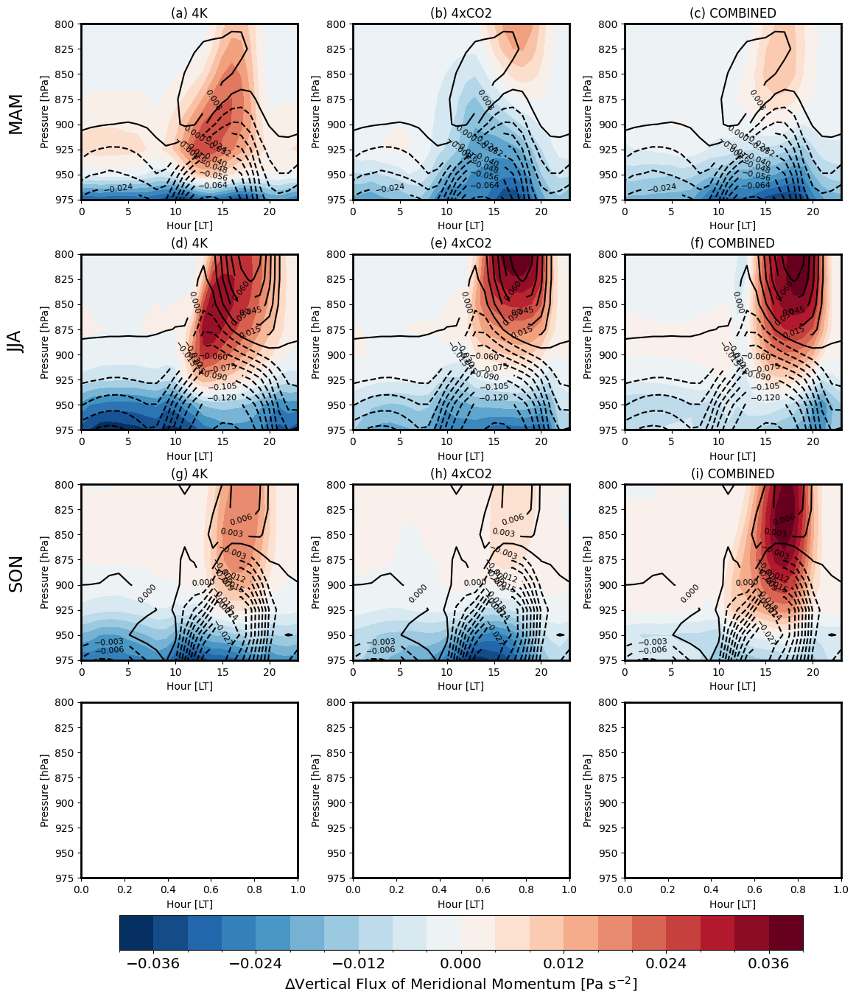

In [196]:
fig, axes = plt.subplots(
    ncols=3, nrows=4, figsize=(6.4*0.6*3, 4.8*0.7*4),
    layout='constrained'
)

label_cnt = 0
for ax_cnt, season in enumerate(['MAM', 'JJA', 'SON']): ### add SON later
    ref = ds_plot.VPWP_CLUBB.sel(season=season, forcing='REF')
    for f_cnt, forcing in enumerate(['4K', '4xCO2', 'COMBINED']):
        da = ds_plot.VPWP_CLUBB.sel(forcing=forcing, season=season) - ref
        # PGF
        c = da.plot.contourf(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            add_colorbar=False,
            cmap='RdBu_r',
            # vmax=0.5,
            levels=5*4+1,
        )
        # Add contours for reference
        contours = ref.plot.contour(
            ax=axes[ax_cnt, f_cnt],
            x='hour',
            # vmin=-1, 
            # vmax=1,
            levels=10*2+1,
            colors='black',
        )
        axes[ax_cnt, f_cnt].clabel(contours, inline=True, fontsize=8)
        axes[ax_cnt, f_cnt].set_title(f'({string.ascii_lowercase[label_cnt]}) {forcing}')
        label_cnt+=1
    axes[ax_cnt, 0].text(
        -0.3, 0.5, season, transform=axes[ax_cnt, 0].transAxes,
        fontsize='xx-large', ha='center', va='center', rotation='vertical'
    )
    
for i, ax in enumerate(axes.flatten()):
    big_ax(ax)
    ax.set_ylim([975*100, 800*100])
    ticks = np.array([975, 950, 925, 900, 875, 850, 825, 800])
    ax.set_yticks(ticks*100)
    ax.set_yticklabels(ticks)
    ax.set_ylabel(r'Pressure [hPa]')
    ax.set_xlabel('Hour [LT]')

cbar = fig.colorbar(
    c, ax=axes.ravel().tolist(),
    shrink=0.9, orientation='horizontal', pad=0.005
)
cbar.set_label(r'$\Delta$Vertical Flux of Meridional Momentum [Pa s$^{-2}$]', fontsize='x-large')
cbar.ax.tick_params(labelsize='x-large')

plt.show()